# 불량품 예측

불량품을 예측하기 위해 다음과 같은 함수화 정리를 진행한다. 혼란을 막기 위해 모든 과정을 함수화 하기로 한다.  
목차는 다음과 같다.

- 1. Load packages & Data
- 2. Function

## 1. Load Packages & Data

In [1]:
### ide packages
import os
from pprint import pprint
import numpy as np
import pandas as pd
import random
import string
from tqdm import tqdm

# sklearn preprocessing
from sklearn.model_selection import train_test_split, GridSearchCV, StratifiedKFold, cross_val_score
from sklearn.preprocessing import LabelEncoder
from sklearn.feature_selection import RFE, RFECV
from sklearn.metrics import (
    accuracy_score,
    classification_report,
    confusion_matrix,
    f1_score,
    precision_score,
    make_scorer,
    roc_curve,
    auc,
    precision_recall_curve,
    recall_score,
    silhouette_score,
)

# models
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import StratifiedKFold
import xgboost as xgb
from catboost import CatBoostClassifier, Pool
from lightgbm import LGBMClassifier, plot_metric
from xgboost import XGBClassifier
import lightgbm as lgb
from sklearn.cluster import KMeans

# plot
import seaborn as sns
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objects as go
import plotly.express as px

# tuning
import optuna

/home/elicer/.local/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# load data
load_dir = './data/'
train = pd.read_csv(load_dir + "train.csv")
test = pd.read_csv(load_dir + "test.csv")

## 2. Functions

In [3]:
# 평가 스코어 지정하기
f1_scorer = make_scorer(f1_score, pos_label=1, average = 'binary')

# 평가 매트릭 계산 결과 보여주기
def get_clf_eval(y_test, y_pred=None):
    confusion = confusion_matrix(y_test, y_pred, labels=[True, False])
    accuracy = accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, labels=[True, False])
    recall = recall_score(y_test, y_pred)
    F1 = f1_score(y_test, y_pred, labels=[True, False])

    print("오차행렬:\n", confusion)
    print("\n정확도: {:.4f}".format(accuracy))
    print("정밀도: {:.4f}".format(precision))
    print("재현율: {:.4f}".format(recall))
    print("F1: {:.4f}".format(F1))

In [4]:
# 해당 공정 맞춤형 위치 옮기기
def move_data(data):
    # divide
    dam = data.filter(regex='_Dam')
    fill1 = data.filter(regex='_Fill1')
    fill2 = data.filter(regex='_Fill2')
    autoclave = data.filter(regex='_AutoClave')
    target = data['target']

    # dam
    dam = dam.dropna(axis=1, how='all')
    dam = dam.drop(columns='HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Dam')
    dam_mask = dam[dam['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].isin(['OK', np.nan])].iloc[:, 24:].shift(-1, axis = 1).values
    dam.loc[dam['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].isin(['OK', np.nan]), dam.columns[24:]] = dam_mask
    dam = dam.drop(columns='WorkMode Collect Result_Dam')

    # fill1
    fill1 = fill1.dropna(axis=1, how='all')
    fill1 = fill1.drop(columns='HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Fill1')
    fill1_mask = fill1[fill1['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].isin(['OK', np.nan])].iloc[:, 14:].shift(-1, axis = 1).values
    fill1.loc[fill1['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].isin(['OK', np.nan]), fill1.columns[14:]] = fill1_mask
    fill1 = fill1.drop(columns='WorkMode Collect Result_Fill1')

    # fill2
    fill2 = fill2.dropna(axis=1, how='all')
    fill2 = fill2.drop(columns='HEAD NORMAL COORDINATE X AXIS(Stage1) Judge Value_Fill2')
    fill2_mask = fill2[fill2['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'].isin(['OK', np.nan])].iloc[:, 24:].shift(-1, axis = 1).values
    fill2.loc[fill2['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'].isin(['OK', np.nan]), fill2.columns[24:]] = fill2_mask
    fill2 = fill2.drop(columns='WorkMode Collect Result_Fill2')

    # CONCAT
    data = pd.concat([dam, fill1, fill2, autoclave, target], axis=1)
    
    return data

In [5]:
# 칼럼 위치 변경
def swap_columns(df, condition, col1, col2):
    # 조건에 해당하는 행 필터링
    filtered_df = df[condition]
    
    # 값 교환
    df.loc[condition, [col1, col2]] = filtered_df[[col1, col2]].copy().iloc[:, ::-1].values

    return df

In [6]:
# Equipment 방향 통일과 잘못된 위치 재조정하기
def change_data(train, test):
    # train
    train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] = train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float)
    train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] = train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float)


    # 이동 전
    X_sum_down_1 = train[train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) < 500]['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float).mean()
    X_sum_down_2 = train[train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) < 500]['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float).mean()
    X_sum_up_1 = train[train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) > 500]['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float).mean()
    X_sum_up_2 = train[train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) > 500]['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float).mean()

    X_sum_down = (X_sum_down_1 - X_sum_down_2) / 2 # stage1에서 빼고, Stage3에서 더하기 <500
    X_sum_up = (X_sum_up_2 - X_sum_up_1) / 2 # stage1에서 더하고, Stage 3에서 빼기

    train.loc[train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] += X_sum_up
    train.loc[train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] -= X_sum_up

    train.loc[train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) < 500, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] -= X_sum_down
    train.loc[train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) < 500, 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] += X_sum_down

    # test
    test['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] = test['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float)
    test['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] = test['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float)


    # 이동 전
    test.loc[test['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] += X_sum_up
    test.loc[test['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] -= X_sum_up

    test.loc[test['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].astype(float) < 500, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'] -= X_sum_down
    test.loc[test['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) < 500, 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'] += X_sum_down

    # train
    Y_sum_dam_1 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float).mean()
    Y_sum_dam_2 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float).mean()

    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'] = Y_sum_dam_1 + Y_sum_dam_2 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam']

    Y_sum_dam_3 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float).mean()
    Y_sum_dam_4 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float).mean()

    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'] = Y_sum_dam_3 + Y_sum_dam_4 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam']

    Y_sum_dam_5 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float).mean()
    Y_sum_dam_6 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float).mean()

    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'] = Y_sum_dam_5 + Y_sum_dam_6 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam']

    Y_sum_fill_1 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float).mean()
    Y_sum_fill_2 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float).mean()

    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'] = Y_sum_fill_1 + Y_sum_fill_2 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1']

    Y_sum_fill_3 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float).mean()
    Y_sum_fill_4 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float).mean()

    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'] = Y_sum_fill_3 + Y_sum_fill_4 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1']

    Y_sum_fill_5 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500]['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float).mean()
    Y_sum_fill_6 = train[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) < 500]['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float).mean()
    train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'] = Y_sum_fill_5 + Y_sum_fill_6 - train.loc[train['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1']

    # test
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'] = Y_sum_dam_1 + Y_sum_dam_2 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam']
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'] = Y_sum_dam_5 + Y_sum_dam_6 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam']
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'] = Y_sum_dam_3 + Y_sum_dam_4 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam']
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'] = Y_sum_fill_1 + Y_sum_fill_2 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1']
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'] = Y_sum_fill_5 + Y_sum_fill_6 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1']
    test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'] = Y_sum_fill_3 + Y_sum_fill_4 - test.loc[test['HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1'].astype(float) > 500, 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1']

    ### Train
    # 조건을 만족하는 행 인덱스를 찾음
    condition = train['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) >= 200

    # DISCHARGED TIME OF RESIN(Stage1) 
    swap_columns(train, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam', 'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam')

    # Dispense Volume(Stage1)
    swap_columns(train, condition, 'Dispense Volume(Stage1) Collect Result_Dam', 'Dispense Volume(Stage3) Collect Result_Dam')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Dam')

    # Stage1 Circle1 Distance Speed Collect
    swap_columns(train, condition, 'Stage1 Circle1 Distance Speed Collect Result_Dam', 'Stage3 Circle1 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Circle2 Distance Speed Collect Result_Dam', 'Stage3 Circle2 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Circle3 Distance Speed Collect Result_Dam', 'Stage3 Circle3 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Circle4 Distance Speed Collect Result_Dam', 'Stage3 Circle4 Distance Speed Collect Result_Dam')

    # Stage1 Line1 Distance Speed Collect
    swap_columns(train, condition, 'Stage1 Line1 Distance Speed Collect Result_Dam', 'Stage3 Line1 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Line2 Distance Speed Collect Result_Dam', 'Stage3 Line2 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Line3 Distance Speed Collect Result_Dam', 'Stage3 Line3 Distance Speed Collect Result_Dam')
    swap_columns(train, condition, 'Stage1 Line4 Distance Speed Collect Result_Dam', 'Stage3 Line4 Distance Speed Collect Result_Dam')

    # THICKNESS 1
    # swap_columns(train, condition, 'THICKNESS 1 Collect Result_Dam', 'THICKNESS 3 Collect Result_Dam')

    ### 젤 마지막에 와야됨!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam')


    ### Test
    # 조건을 만족하는 행 인덱스를 찾음
    condition = test['HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam'].astype(float) >= 200

    # DISCHARGED TIME OF RESIN(Stage1) 
    swap_columns(test, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam', 'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam')

    # Dispense Volume(Stage1)
    swap_columns(test, condition, 'Dispense Volume(Stage1) Collect Result_Dam', 'Dispense Volume(Stage3) Collect Result_Dam')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Dam')

    # Stage1 Circle1 Distance Speed Collect
    swap_columns(test, condition, 'Stage1 Circle1 Distance Speed Collect Result_Dam', 'Stage3 Circle1 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Circle2 Distance Speed Collect Result_Dam', 'Stage3 Circle2 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Circle3 Distance Speed Collect Result_Dam', 'Stage3 Circle3 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Circle4 Distance Speed Collect Result_Dam', 'Stage3 Circle4 Distance Speed Collect Result_Dam')

    # Stage1 Line1 Distance Speed Collect
    swap_columns(test, condition, 'Stage1 Line1 Distance Speed Collect Result_Dam', 'Stage3 Line1 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Line2 Distance Speed Collect Result_Dam', 'Stage3 Line2 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Line3 Distance Speed Collect Result_Dam', 'Stage3 Line3 Distance Speed Collect Result_Dam')
    swap_columns(test, condition, 'Stage1 Line4 Distance Speed Collect Result_Dam', 'Stage3 Line4 Distance Speed Collect Result_Dam')

    # THICKNESS 1
    # swap_columns(train, condition, 'THICKNESS 1 Collect Result_Dam', 'THICKNESS 3 Collect Result_Dam')

    ### 젤 마지막에 와야됨!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam', 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam')
    
    ### Train
    # 조건을 만족하는 행 인덱스를 찾음
    condition = train['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].astype(float) < 200

    # DISCHARGED TIME OF RESIN(Stage1)
    swap_columns(train, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1', 'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1')

    # Dispense Volume(Stage1)
    swap_columns(train, condition, 'Dispense Volume(Stage1) Collect Result_Fill1', 'Dispense Volume(Stage3) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Fill1')

    # 반드시 마지막으로 와야함!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Fill1')

    ### Test
    condition = test['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'].astype(float) < 200

    # DISCHARGED TIME OF RESIN(Stage1)
    swap_columns(test, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1', 'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1')

    # Dispense Volume(Stage1)
    swap_columns(test, condition, 'Dispense Volume(Stage1) Collect Result_Fill1', 'Dispense Volume(Stage3) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Fill1')

    # 반드시 마지막으로 와야함!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Fill1')
    
    ### Train
    condition = train['HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500

    # DISCHARGED TIME OF RESIN(Stage1)
    swap_columns(train, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1', 'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1')

    # Dispense Volume(Stage1)
    swap_columns(train, condition, 'Dispense Volume(Stage1) Collect Result_Fill1', 'Dispense Volume(Stage2) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Z AXIS(Stage2) Collect Result_Fill1')

    # 반드시 마지막으로 와야함!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(train, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Fill1')

    ### Test
    condition = test['HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Fill1'].astype(float) > 500

    # DISCHARGED TIME OF RESIN(Stage1)
    swap_columns(test, condition, 'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1', 'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1')

    # Dispense Volume(Stage1)
    swap_columns(test, condition, 'Dispense Volume(Stage1) Collect Result_Fill1', 'Dispense Volume(Stage2) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Y AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1')

    # HEAD NORMAL COORDINATE Z AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE Z AXIS(Stage2) Collect Result_Fill1')

    # 반드시 마지막으로 와야함!!!!
    # HEAD NORMAL COORDINATE X AXIS(Stage1)
    swap_columns(test, condition, 'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1', 'HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Fill1')

    return train, test

In [7]:
# Dam, Fill1, Fill2에서 지정된 값이 다를 경우 Abnormal 
def inconsistant(data, columnname, iwantthiscolumnsname, is_train = True):
    # 장비 번호가 다르면 불일치
    if is_train:
        cri = [
            df_train[columnname + '_Dam'] != df_train[columnname + '_Fill1'],
            df_train[columnname + '_Dam'] != df_train[columnname + '_Fill2'],
            df_train[columnname + '_Fill1'] != df_train[columnname + '_Fill2'],
            data[iwantthiscolumnsname] == 1
        ]
        
    else:
        cri = [
            df_test[columnname + '_Dam'] != df_test[columnname + '_Fill1'],
            df_test[columnname + '_Dam'] != df_test[columnname + '_Fill2'],
            df_test[columnname + '_Fill1'] != df_test[columnname + '_Fill1'],
            data[iwantthiscolumnsname] == 1
        ]
    con = [1, 1, 1, 1]

    data[iwantthiscolumnsname] = np.select(cri, con, default = 0)

In [8]:
# 변수 세팅
def variable_setting(types, tr, te, columns_to_convert, columns_to):
    train = tr.copy()
    test = te.copy()
    
    if types == 'catboost':
        dtype = 'string'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)

        dtype = 'category'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)
            
    elif types == 'lightgbm':
        dtype = 'float'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)

        dtype = 'category'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)
            
    elif types == 'xgboost':
        dtype = 'float'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)
            
        dtype = 'category'  # 원하는 데이터 타입
        for column in columns_to_convert + columns_to:
            train[column] = train[column].astype(dtype)
            test[column] = test[column].astype(dtype)
            
    return train, test

In [9]:
def model_best_threshold(model, X_valid, y_valid):
    # Precision - Recall
    y_pred_proba = model.predict_proba(X_valid)[:, 1]

    precision, recall, thresholds = precision_recall_curve(y_valid, y_pred_proba)
    f1_scores = 2*recall*precision / (recall + precision)
    cat_best_threshold = thresholds[np.argmax(f1_scores)]
    y_pred_custom_threshold = (y_pred_proba >= cat_best_threshold).astype(int)
    
    return thresholds, y_pred_custom_threshold

In [10]:
def xgboost_optuna(train, cat_features_indices):
    X = train.drop(columns=['target'])
    y = train['target']

    X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

    def objective(trial):
        params = {
            'n_estimators': trial.suggest_int('n_estimators', 100, 1000),
            'max_depth': trial.suggest_int('max_depth', 3, 10),
            'learning_rate': trial.suggest_float('learning_rate', 1e-3, 1.0, log=True),
            'subsample': trial.suggest_float('subsample', 0.5, 1.0),
            'colsample_bytree': trial.suggest_float('colsample_bytree', 0.5, 1.0),
            'gamma': trial.suggest_float('gamma', 0, 5),
            'lambda': trial.suggest_float('lambda', 1e-3, 10.0, log=True),
            'alpha': trial.suggest_float('alpha', 1e-3, 10.0, log=True),
            'seed': 42,
        }

        model = XGBClassifier(eval_metric='logloss', **params, early_stopping_rounds = 50, enable_categorical=True)

        model.fit(X_train, y_train, eval_set=[(X_valid, y_valid)], verbose=0)

        # 검증 세트에 대한 예측 및 평가
        preds = model.predict_proba(X_valid)[:, 1]

        # thresholds
        precision, recall, thresholds = precision_recall_curve(y_valid, preds)
        f1_scores = 2*recall*precision / (recall + precision)
        cat_best_threshold = thresholds[np.argmax(f1_scores)]
        y_pred_custom_threshold_cat = (preds >= cat_best_threshold).astype(int)

        f1 = f1_score(y_valid, y_pred_custom_threshold_cat)

        return f1

    # Optuna 스터디 생성 및 최적화
    sampler = optuna.samplers.TPESampler(seed=42)
    study = optuna.create_study(direction="maximize", sampler=sampler)
    study.optimize(objective, n_trials=50)

    # 최적의 하이퍼파라미터 출력
    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))
    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))
        
    return study.best_trial.params, X, y, X_train.index, X_valid.index

In [11]:
def lightgbm_optuna(train, cat_features_indices):

    X = train.drop(columns=['target'])
    y = train['target']

    X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

    def objective(trial):
        lgbm_params = {
            'n_estimators': trial.suggest_int('n_estimators', 400, 1500),
            "max_depth": trial.suggest_int('max_depth', 3, 63),
            "learning_rate": trial.suggest_float('learning_rate', 1e-4, 1e-2, log=True), 
            'reg_alpha': trial.suggest_float('reg_alpha', 1e-3, 10.0, log=True),
            'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 10.0, log=True),
            "min_child_weight": trial.suggest_float('min_child_weight', 0.5, 4),
            "min_child_samples": trial.suggest_int('min_child_samples', 5, 100),
            "subsample": trial.suggest_float('subsample', 0.4, 1),
            "subsample_freq": trial.suggest_int('subsample_freq', 0, 5),
            "colsample_bytree": trial.suggest_float('colsample_bytree', 0.2, 1),
            'num_leaves': trial.suggest_int('num_leaves', 2, 64),
        }

        model = LGBMClassifier(**lgbm_params, device='cpu', random_state=42, verbose=-1)

        # 범주형 피처 적용
        model.fit(X_train, y_train, categorical_feature=cat_features_indices,
            eval_set = [(X_valid, y_valid)],
            callbacks=[
                lgb.early_stopping(stopping_rounds=50),
            ]
        )

        # 검증 세트에 대한 예측 및 평가
        preds = model.predict_proba(X_valid)[:, 1]

        # thresholds
        precision, recall, thresholds = precision_recall_curve(y_valid, preds)
        f1_scores = 2*recall*precision / (recall + precision)
        cat_best_threshold = thresholds[np.argmax(f1_scores)]
        y_pred_custom_threshold_cat = (preds >= cat_best_threshold).astype(int)

        f1 = f1_score(y_valid, y_pred_custom_threshold_cat)

        return f1

    # Optuna 스터디 생성 및 최적화
    sampler = optuna.samplers.TPESampler(seed=42)
    study = optuna.create_study(direction="maximize", sampler=sampler)
    study.optimize(objective, n_trials=50)

    # 최적의 하이퍼파라미터 출력
    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))
    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))
        
    return study.best_trial.params, X, y, X_train.index, X_valid.index

In [12]:
def catboost_optuna(train, cat_features_indices):
    
    # train X, y
    X = train.drop(columns=['target'])
    y = train['target']

    # $plit 
    X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

    # Pooling
    train_pool = Pool(X_train, y_train, cat_features=cat_features_indices)
    valid_pool = Pool(X_valid, y_valid, cat_features=cat_features_indices)
    
    # tuning parameters
    def objective(trial):
        # 하이퍼파라미터를 샘플링
        params = {
            "iterations": trial.suggest_int("iterations", 100, 1000),
            "depth": trial.suggest_int("depth", 4, 10),
            "learning_rate": trial.suggest_float("learning_rate", 1e-3, 1.0, log=True),
            "l2_leaf_reg": trial.suggest_float("l2_leaf_reg", 1e-2, 10.0),
            "border_count": trial.suggest_int("border_count", 32, 255),
            "random_strength": trial.suggest_float("random_strength", 1e-9, 10.0),
            "bagging_temperature": trial.suggest_float("bagging_temperature", 0.0, 1.0),
            "od_type": trial.suggest_categorical("od_type", ["IncToDec", "Iter"]),
            "od_wait": trial.suggest_int("od_wait", 10, 50),
            "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
#             "scale_pos_weight": trial.suggest_int('scale_pos_weight', 6, 10),
            "verbose": 0,
            "random_seed": 42
        }

        # CatBoost 모델 학습
        model = CatBoostClassifier(**params)
        model.fit(train_pool, eval_set=valid_pool, early_stopping_rounds=50, verbose=0)

        # 검증 세트에 대한 예측 및 평가
        preds = model.predict_proba(X_valid)[:, 1]

        # thresholds
        precision, recall, thresholds = precision_recall_curve(y_valid, preds)
        f1_scores = 2*recall*precision / (recall + precision)
        cat_best_threshold = thresholds[np.argmax(f1_scores)]
        y_pred_custom_threshold_cat = (preds >= cat_best_threshold).astype(int)

        f1 = f1_score(y_valid, y_pred_custom_threshold_cat)
        
        return f1

    # Optuna 스터디 생성 및 최적화
    sampler = optuna.samplers.TPESampler(seed=42)
    study = optuna.create_study(direction="maximize", sampler=sampler)
    study.optimize(objective, n_trials=50)

    # 최적의 하이퍼파라미터 출력
    print("Best trial:")
    trial = study.best_trial

    print("  Value: {}".format(trial.value))
    print("  Params: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))
        
    return study.best_trial.params, X, y, X_train.index, X_valid.index

## 3. Setting

In [13]:
# inconsistant 열 이름
columnname = [
    'Equipment', 
    'Receip No Collect Result', 
    'Production Qty Collect Result', 
    'PalletID Collect Result'
]

In [14]:
# 최종 선택할 행 이름
sel_col = [
    'Model.Suffix_Dam',
    'Workorder_Dam',
    'CURE SPEED Collect Result_Dam',
    'DISCHARGED SPEED OF RESIN Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Dam',
    'Head Clean Position Z Collect Result_Dam',
    'Head Purge Position Z Collect Result_Dam',
    'Head Zero Position Y Collect Result_Dam',
    'Head Zero Position Z Collect Result_Dam',
    'Machine Tact time Collect Result_Dam',
    'Stage1 Circle1 Distance Speed Collect Result_Dam',
    'Stage1 Line1 Distance Speed Collect Result_Dam',
    'Stage1 Line2 Distance Speed Collect Result_Dam',
    'Stage1 Line3 Distance Speed Collect Result_Dam',
    'Stage1 Line4 Distance Speed Collect Result_Dam',
    'Stage2 Circle1 Distance Speed Collect Result_Dam',
    'Stage2 Line1 Distance Speed Collect Result_Dam',
    'Stage2 Line2 Distance Speed Collect Result_Dam',
    'Stage2 Line3 Distance Speed Collect Result_Dam',
    'Stage2 Line4 Distance Speed Collect Result_Dam',
    'Stage3 Circle1 Distance Speed Collect Result_Dam',
    'Stage3 Line1 Distance Speed Collect Result_Dam',
    'Stage3 Line2 Distance Speed Collect Result_Dam',
    'Stage3 Line3 Distance Speed Collect Result_Dam',
    'Stage3 Line4 Distance Speed Collect Result_Dam',
    'THICKNESS 1 Collect Result_Dam', 
    'THICKNESS 2 Collect Result_Dam',
    'THICKNESS 3 Collect Result_Dam',
    'DISCHARGED SPEED OF RESIN Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1',
    'Head Purge Position Z Collect Result_Fill1',
    'Machine Tact time Collect Result_Fill1',
    'CURE END POSITION Z Collect Result_Fill2',
    'CURE SPEED Collect Result_Fill2',
    'CURE START POSITION Z Collect Result_Fill2',
    'Machine Tact time Collect Result_Fill2',
    '1st Pressure Collect Result_AutoClave',
    '2nd Pressure Collect Result_AutoClave',
    '3rd Pressure Collect Result_AutoClave',
    'Chamber Temp. Collect Result_AutoClave',
    'inconsistant',
    'Stage1 Line diffent Distance Speed_Dam',
    'Stage2 Line diffent Distance Speed_Dam',
    'Stage3 Line diffent Distance Speed_Dam',
    'PalletID Collect Result_Dam',
    'Receip No Collect Result_Dam',
    'Equipment_Dam',
    'kmeans_5',
    'round_1st_time',
    'round_2nd_time',
    'round_3rd_time',
    'all_time',
    'RESIN Adjusted_Predicted_Volume Stage1 Dam',
    'RESIN Adjusted_Predicted_Volume Stage2 Dam',
    'RESIN Adjusted_Predicted_Volume Stage3 Dam',
    'RESIN Adjusted_Predicted_Volume Stage1 Fill1',
    'RESIN Adjusted_Predicted_Volume Stage2 Fill1',
    'RESIN Adjusted_Predicted_Volume Stage3 Fill1',
    'target'
]

## 4. Matched Data

In [15]:
# 위치 옮기기
train_move = move_data(train)
test_move = move_data(test)

/tmp/ipykernel_74/691509256.py:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[ 0.     0.012  0.    ...  0.    -0.019  0.   ]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  dam.loc[dam['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam'].isin(['OK', np.nan]), dam.columns[24:]] = dam_mask
/tmp/ipykernel_74/691509256.py:28: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[114.612 114.612  85.    ...  85.    114.612  85.   ]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  fill2.loc[fill2['HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill2'].isin(['OK', np.nan]), fill2.columns[24:]] = fill2_mask
/tmp/ipykernel_74/691509256.py:14: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '[-0

In [16]:
# 위치 변경 및 Equipment2 를 Equipment1 방향으로 변경
df_train, df_test = change_data(train_move, test_move)

### Type Change

In [17]:
# 데이터 타입 변경하기
type_change = [
    'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1'
]

for i in type_change:
    df_train[i] = df_train[i].astype('float64')
    df_test[i] = df_test[i].astype('float64')

### Modified Equipment data type

In [18]:
# Equipment 번호만 가져오기
df_train['Equipment_Dam'] = df_train['Equipment_Dam'].str.slice(15, 16)
df_train['Equipment_Fill1'] = df_train['Equipment_Fill1'].str.slice(17, 18)
df_train['Equipment_Fill2'] = df_train['Equipment_Fill2'].str.slice(17, 18)

df_test['Equipment_Dam'] = df_test['Equipment_Dam'].str.slice(15, 16)
df_test['Equipment_Fill1'] = df_test['Equipment_Fill1'].str.slice(17, 18)
df_test['Equipment_Fill2'] = df_test['Equipment_Fill2'].str.slice(17, 18)

### New Column

In [19]:
# 불일치 변수
df_train['inconsistant'] = 0
df_test['inconsistant'] = 0

# 장착
for i in columnname:
    inconsistant(df_train, i, 'inconsistant', True)
    inconsistant(df_test, i, 'inconsistant', False)

In [20]:
# 시간이 0이하, 900이상인 값은 이상치로 분류
for j in ['Machine Tact time Collect Result_Dam', 'Machine Tact time Collect Result_Fill1', 'Machine Tact time Collect Result_Fill2']:
    cri = [
        df_train[j] <= 0,
        df_train[j] > 900
    ]
    cri2 = [
        df_test[j] <= 0,
        df_test[j] > 900
    ]
    con = [
        1, 1
    ]
    df_train['inconsistant'] = np.select(cri, con, default = df_train['inconsistant'])
    df_test['inconsistant'] = np.select(cri2, con, default = df_test['inconsistant'])

### Speed Line & Circle

In [21]:
# 라인별로 속도가 같아야 정상이다.
df_train['Stage1 Line diffent Distance Speed_Dam'] = ((df_train['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage1 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage1 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage1 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage1 Line3 Distance Speed Collect Result_Dam'] != df_train['Stage1 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_train['Stage1 Line Sum Speed_Dam'] = df_train['Stage1 Line1 Distance Speed Collect Result_Dam'] + df_train['Stage1 Line2 Distance Speed Collect Result_Dam'] + df_train['Stage1 Line3 Distance Speed Collect Result_Dam'] + df_train['Stage1 Line4 Distance Speed Collect Result_Dam']

df_train['Stage2 Line diffent Distance Speed_Dam'] = ((df_train['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage2 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage2 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage2 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage2 Line3 Distance Speed Collect Result_Dam'] != df_train['Stage2 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_train['Stage2 Line Sum Speed_Dam'] = df_train['Stage2 Line1 Distance Speed Collect Result_Dam'] + df_train['Stage2 Line2 Distance Speed Collect Result_Dam'] + df_train['Stage2 Line3 Distance Speed Collect Result_Dam'] + df_train['Stage2 Line4 Distance Speed Collect Result_Dam']

df_train['Stage3 Line diffent Distance Speed_Dam'] = ((df_train['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage3 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage3 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_train['Stage3 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_train['Stage3 Line3 Distance Speed Collect Result_Dam'] != df_train['Stage3 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_train['Stage3 Line Sum Speed_Dam'] = df_train['Stage3 Line1 Distance Speed Collect Result_Dam'] + df_train['Stage3 Line2 Distance Speed Collect Result_Dam'] + df_train['Stage3 Line3 Distance Speed Collect Result_Dam'] + df_train['Stage3 Line4 Distance Speed Collect Result_Dam']


In [22]:
# 라인별로 속도가 같아야 정상이다.
df_test['Stage1 Line diffent Distance Speed_Dam'] = ((df_test['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage1 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage1 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage1 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage1 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage1 Line3 Distance Speed Collect Result_Dam'] != df_test['Stage1 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_test['Stage1 Line Sum Speed_Dam'] = df_test['Stage1 Line1 Distance Speed Collect Result_Dam'] + df_test['Stage1 Line2 Distance Speed Collect Result_Dam'] + df_test['Stage1 Line3 Distance Speed Collect Result_Dam'] + df_test['Stage1 Line4 Distance Speed Collect Result_Dam']

df_test['Stage2 Line diffent Distance Speed_Dam'] = ((df_test['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage2 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage2 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage2 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage2 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage2 Line3 Distance Speed Collect Result_Dam'] != df_test['Stage2 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_test['Stage2 Line Sum Speed_Dam'] = df_test['Stage2 Line1 Distance Speed Collect Result_Dam'] + df_test['Stage2 Line2 Distance Speed Collect Result_Dam'] + df_test['Stage2 Line3 Distance Speed Collect Result_Dam'] + df_test['Stage2 Line4 Distance Speed Collect Result_Dam']

df_test['Stage3 Line diffent Distance Speed_Dam'] = ((df_test['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage3 Line2 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage3 Line3 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage3 Line1 Distance Speed Collect Result_Dam'] != df_test['Stage3 Line4 Distance Speed Collect Result_Dam']) |
                                                  (df_test['Stage3 Line3 Distance Speed Collect Result_Dam'] != df_test['Stage3 Line4 Distance Speed Collect Result_Dam'])).astype(int)
df_test['Stage3 Line Sum Speed_Dam'] = df_test['Stage3 Line1 Distance Speed Collect Result_Dam'] + df_test['Stage3 Line2 Distance Speed Collect Result_Dam'] + df_test['Stage3 Line3 Distance Speed Collect Result_Dam'] + df_test['Stage3 Line4 Distance Speed Collect Result_Dam']

### Cure differenciates

In [23]:
# 경화 x 좌표 dam
df_train['cure_x_dist_dam'] = df_train['CURE START POSITION X Collect Result_Dam'] - df_train['CURE END POSITION X Collect Result_Dam']
df_test['cure_x_dist_dam'] = df_test['CURE START POSITION X Collect Result_Dam'] - df_test['CURE END POSITION X Collect Result_Dam']

In [24]:
# 경화 z좌표 dam
df_train['cure_z_dist_dam'] = df_train['CURE START POSITION Z Collect Result_Dam'] - df_train['CURE END POSITION Z Collect Result_Dam']
df_test['cure_z_dist_dam'] = df_test['CURE START POSITION Z Collect Result_Dam'] - df_test['CURE END POSITION Z Collect Result_Dam']

In [25]:
# 경화 z좌표 fill2
df_train['cure_z_dist_fill2'] = df_train['CURE START POSITION Z Collect Result_Fill2'] - df_train['CURE END POSITION Z Collect Result_Fill2']
df_test['cure_z_dist_fill2'] = df_test['CURE START POSITION Z Collect Result_Fill2'] - df_test['CURE END POSITION Z Collect Result_Fill2']

### time 보정

In [26]:
# time 보정하기
df_train['round_1st_time'] = round(df_train['1st Pressure 1st Pressure Unit Time_AutoClave'], -1)
df_train['round_2nd_time'] = round(df_train['2nd Pressure Unit Time_AutoClave'], -1)
df_train['round_3rd_time'] = round(df_train['3rd Pressure Unit Time_AutoClave'], -1)
df_train['all_time'] = round(df_train['Chamber Temp. Unit Time_AutoClave'], -1)

df_test['round_1st_time'] = round(df_test['1st Pressure 1st Pressure Unit Time_AutoClave'], -1)
df_test['round_2nd_time'] = round(df_test['2nd Pressure Unit Time_AutoClave'], -1)
df_test['round_3rd_time'] = round(df_test['3rd Pressure Unit Time_AutoClave'], -1)
df_test['all_time'] = round(df_test['Chamber Temp. Unit Time_AutoClave'], -1)

time_col = [
    '1st Pressure 1st Pressure Unit Time_AutoClave',
    '2nd Pressure Unit Time_AutoClave',
    '3rd Pressure Unit Time_AutoClave',
    'Chamber Temp. Unit Time_AutoClave'
]

# 적용
df_train = df_train.drop(columns = time_col, axis = 1)
df_test = df_test.drop(columns = time_col, axis = 1)

### K-means cluster

In [27]:
cluster_col = [
    'CURE SPEED Collect Result_Dam',
    'DISCHARGED SPEED OF RESIN Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Dam',
    'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam',
    'Dispense Volume(Stage1) Collect Result_Dam',
    'Dispense Volume(Stage2) Collect Result_Dam',
    'Dispense Volume(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Dam',
    'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Z AXIS(Stage2) Collect Result_Dam',
    'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Dam',
    'Head Clean Position Z Collect Result_Dam',
    'Head Purge Position Z Collect Result_Dam',
    'Head Zero Position Y Collect Result_Dam',
    'Head Zero Position Z Collect Result_Dam',
    'Machine Tact time Collect Result_Dam', 
    'PalletID Collect Result_Dam',
    'Production Qty Collect Result_Dam',
    'Receip No Collect Result_Dam',
    'Stage1 Circle1 Distance Speed Collect Result_Dam',
    'Stage1 Circle2 Distance Speed Collect Result_Dam',
    'Stage1 Circle3 Distance Speed Collect Result_Dam',
    'Stage1 Circle4 Distance Speed Collect Result_Dam',
    'Stage1 Line1 Distance Speed Collect Result_Dam',
    'Stage1 Line2 Distance Speed Collect Result_Dam',
    'Stage1 Line3 Distance Speed Collect Result_Dam',
    'Stage1 Line4 Distance Speed Collect Result_Dam',
    'Stage2 Circle1 Distance Speed Collect Result_Dam',
    'Stage2 Circle2 Distance Speed Collect Result_Dam',
    'Stage2 Circle3 Distance Speed Collect Result_Dam',
    'Stage2 Circle4 Distance Speed Collect Result_Dam',
    'Stage2 Line1 Distance Speed Collect Result_Dam',
    'Stage2 Line2 Distance Speed Collect Result_Dam',
    'Stage2 Line3 Distance Speed Collect Result_Dam',
    'Stage2 Line4 Distance Speed Collect Result_Dam',
    'Stage3 Circle1 Distance Speed Collect Result_Dam',
    'Stage3 Circle2 Distance Speed Collect Result_Dam',
    'Stage3 Circle3 Distance Speed Collect Result_Dam',
    'Stage3 Circle4 Distance Speed Collect Result_Dam',
    'Stage3 Line1 Distance Speed Collect Result_Dam',
    'Stage3 Line2 Distance Speed Collect Result_Dam',
    'Stage3 Line3 Distance Speed Collect Result_Dam',
    'Stage3 Line4 Distance Speed Collect Result_Dam',
    'THICKNESS 1 Collect Result_Dam', 'THICKNESS 2 Collect Result_Dam',
    'THICKNESS 3 Collect Result_Dam',
    'DISCHARGED SPEED OF RESIN Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1',
    'DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1',
    'Dispense Volume(Stage1) Collect Result_Fill1',
    'Dispense Volume(Stage2) Collect Result_Fill1',
    'Dispense Volume(Stage3) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE X AXIS(Stage1) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE X AXIS(Stage2) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE X AXIS(Stage3) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Y AXIS(Stage1) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Y AXIS(Stage2) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Y AXIS(Stage3) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Z AXIS(Stage1) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Z AXIS(Stage2) Collect Result_Fill1',
    'HEAD NORMAL COORDINATE Z AXIS(Stage3) Collect Result_Fill1',
    'Head Purge Position Z Collect Result_Fill1',
    'CURE SPEED Collect Result_Fill2', 'inconsistant', 'cure_x_dist_dam',
    'cure_z_dist_dam', 'cure_z_dist_fill2'
]

In [28]:
# kmeans에 사용할 칼럼만 불러오기
use_train = df_train[cluster_col]
use_test = df_test[cluster_col]

In [29]:
# # 실루엣 분석을 사용하여 최적의 K값 탐색
# silhouette_scores = []
# for k in range(2, 11):
#     kmeans = KMeans(n_clusters=k, random_state=42)
#     kmeans.fit(use_train)
#     score = silhouette_score(use_train, kmeans.labels_)
#     silhouette_scores.append(score)

# # 실루엣 분석 그래프 그리기
# plt.plot(range(2, 11), silhouette_scores, marker='o')

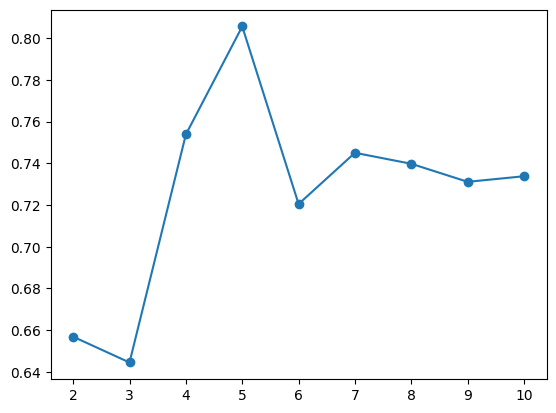

In [30]:
# parameters
best_k = 5 # centroid의 best 개수 -> elbow, 실루엣 두 방법을 비교하여 선정한다.
abnormal = 1 # 시뮬레이션에서 이상치 판독 기준 개수

# Best k 적합하기
best = KMeans(
        n_clusters = best_k,    # 클러스터 수 설정
        init="random",   # 초기 중심점을 무작위로 선택
        n_init="auto",    # k-means 알고리즘 반복 실행 횟수 설정
        random_state=42
    ).fit(use_train)

In [31]:
df_train['kmeans_5'] = best.labels_

In [32]:
df_test['kmeans_5'] = best.predict(use_test)

### 각 Stage별 새로운 Resin 값을 제시하기 위한 코드

In [33]:
## train
# Stage별 토출량, 토출 속도, 토출 소요시간 데이터
df_train['RESIN Predicted_Volume Stage1 Dam'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_train['DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam']
df_train['RESIN Predicted_Volume Stage2 Dam'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_train['DISCHARGED TIME OF RESIN(Stage2) Collect Result_Dam']
df_train['RESIN Predicted_Volume Stage3 Dam'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_train['DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam']

# Stage별 실제 토출량과 예측 토출량의 비율(조정 계수) 계산
df_train['Stage1 Scaling_Factor'] = df_train['Dispense Volume(Stage1) Collect Result_Dam'] / df_train['RESIN Predicted_Volume Stage1 Dam']
df_train['Stage2 Scaling_Factor'] = df_train['Dispense Volume(Stage2) Collect Result_Dam'] / df_train['RESIN Predicted_Volume Stage2 Dam']
df_train['Stage3 Scaling_Factor'] = df_train['Dispense Volume(Stage3) Collect Result_Dam'] / df_train['RESIN Predicted_Volume Stage3 Dam']

# Stage별 조정된 예측 토출량 계산
df_train['RESIN Adjusted_Predicted_Volume Stage1 Dam'] = df_train['RESIN Predicted_Volume Stage1 Dam'] * df_train['Stage1 Scaling_Factor'].mean()
df_train['RESIN Adjusted_Predicted_Volume Stage2 Dam'] = df_train['RESIN Predicted_Volume Stage2 Dam'] * df_train['Stage2 Scaling_Factor'].mean()
df_train['RESIN Adjusted_Predicted_Volume Stage3 Dam'] = df_train['RESIN Predicted_Volume Stage3 Dam'] * df_train['Stage3 Scaling_Factor'].mean()

## test
# Stage별 토출량, 토출 속도, 토출 소요시간 데이터
df_test['RESIN Predicted_Volume Stage1 Dam'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_test['DISCHARGED TIME OF RESIN(Stage1) Collect Result_Dam']
df_test['RESIN Predicted_Volume Stage2 Dam'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_test['DISCHARGED TIME OF RESIN(Stage2) Collect Result_Dam']
df_test['RESIN Predicted_Volume Stage3 Dam'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Dam'] * df_test['DISCHARGED TIME OF RESIN(Stage3) Collect Result_Dam']

# Stage별 실제 토출량과 예측 토출량의 비율(조정 계수) 계산
df_test['Stage1 Scaling_Factor'] = df_test['Dispense Volume(Stage1) Collect Result_Dam'] / df_test['RESIN Predicted_Volume Stage1 Dam']
df_test['Stage2 Scaling_Factor'] = df_test['Dispense Volume(Stage2) Collect Result_Dam'] / df_test['RESIN Predicted_Volume Stage2 Dam']
df_test['Stage3 Scaling_Factor'] = df_test['Dispense Volume(Stage3) Collect Result_Dam'] / df_test['RESIN Predicted_Volume Stage3 Dam']

# Stage별 조정된 예측 토출량 계산
df_test['RESIN Adjusted_Predicted_Volume Stage1 Dam'] = df_test['RESIN Predicted_Volume Stage1 Dam'] * df_test['Stage1 Scaling_Factor'].mean()
df_test['RESIN Adjusted_Predicted_Volume Stage2 Dam'] = df_test['RESIN Predicted_Volume Stage2 Dam'] * df_test['Stage2 Scaling_Factor'].mean()
df_test['RESIN Adjusted_Predicted_Volume Stage3 Dam'] = df_test['RESIN Predicted_Volume Stage3 Dam'] * df_test['Stage3 Scaling_Factor'].mean()

In [34]:
## train
# Stage별 토출량, 토출 속도, 토출 소요시간 데이터
df_train['RESIN Predicted_Volume Stage1 Fill1'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_train['DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1']
df_train['RESIN Predicted_Volume Stage2 Fill1'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_train['DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1']
df_train['RESIN Predicted_Volume Stage3 Fill1'] = df_train['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_train['DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1']

# Stage별 실제 토출량과 예측 토출량의 비율(조정 계수) 계산
df_train['Stage1 Scaling_Factor'] = df_train['Dispense Volume(Stage1) Collect Result_Fill1'] / df_train['RESIN Predicted_Volume Stage1 Fill1']
df_train['Stage2 Scaling_Factor'] = df_train['Dispense Volume(Stage2) Collect Result_Fill1'] / df_train['RESIN Predicted_Volume Stage2 Fill1']
df_train['Stage3 Scaling_Factor'] = df_train['Dispense Volume(Stage3) Collect Result_Fill1'] / df_train['RESIN Predicted_Volume Stage3 Fill1']

# Stage별 조정된 예측 토출량 계산
df_train['RESIN Adjusted_Predicted_Volume Stage1 Fill1'] = df_train['RESIN Predicted_Volume Stage1 Fill1'] * df_train['Stage1 Scaling_Factor'].mean()
df_train['RESIN Adjusted_Predicted_Volume Stage2 Fill1'] = df_train['RESIN Predicted_Volume Stage2 Fill1'] * df_train['Stage2 Scaling_Factor'].mean()
df_train['RESIN Adjusted_Predicted_Volume Stage3 Fill1'] = df_train['RESIN Predicted_Volume Stage3 Fill1'] * df_train['Stage3 Scaling_Factor'].mean()

## test
# Stage별 토출량, 토출 속도, 토출 소요시간 데이터
df_test['RESIN Predicted_Volume Stage1 Fill1'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_test['DISCHARGED TIME OF RESIN(Stage1) Collect Result_Fill1']
df_test['RESIN Predicted_Volume Stage2 Fill1'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_test['DISCHARGED TIME OF RESIN(Stage2) Collect Result_Fill1']
df_test['RESIN Predicted_Volume Stage3 Fill1'] = df_test['DISCHARGED SPEED OF RESIN Collect Result_Fill1'] * df_test['DISCHARGED TIME OF RESIN(Stage3) Collect Result_Fill1']

# Stage별 실제 토출량과 예측 토출량의 비율(조정 계수) 계산
df_test['Stage1 Scaling_Factor'] = df_test['Dispense Volume(Stage1) Collect Result_Fill1'] / df_test['RESIN Predicted_Volume Stage1 Fill1']
df_test['Stage2 Scaling_Factor'] = df_test['Dispense Volume(Stage2) Collect Result_Fill1'] / df_test['RESIN Predicted_Volume Stage2 Fill1']
df_test['Stage3 Scaling_Factor'] = df_test['Dispense Volume(Stage3) Collect Result_Fill1'] / df_test['RESIN Predicted_Volume Stage3 Fill1']

# Stage별 조정된 예측 토출량 계산
df_test['RESIN Adjusted_Predicted_Volume Stage1 Fill1'] = df_test['RESIN Predicted_Volume Stage1 Fill1'] * df_test['Stage1 Scaling_Factor'].mean()
df_test['RESIN Adjusted_Predicted_Volume Stage2 Fill1'] = df_test['RESIN Predicted_Volume Stage2 Fill1'] * df_test['Stage2 Scaling_Factor'].mean()
df_test['RESIN Adjusted_Predicted_Volume Stage3 Fill1'] = df_test['RESIN Predicted_Volume Stage3 Fill1'] * df_test['Stage3 Scaling_Factor'].mean()

### Type 수정

In [35]:
label_encoders = {}
categorical_features = ['Workorder_Dam', 'Model.Suffix_Dam']

# 시드 설정
np.random.seed(42)
for feature in categorical_features:
    le = LabelEncoder()
    df_train[feature] = le.fit_transform(df_train[feature])
    
    # 검증 데이터에 있는 새로운 값에 대해 처리
    unique_values = set(df_test[feature].unique()) - set(le.classes_)
    if unique_values:
        # 새로운 값들을 인코딩할 무작위 숫자 생성
        new_labels = np.random.randint(0, len(le.classes_), size=len(unique_values))
        # 새로운 값들을 인코딩
        le.classes_ = np.append(le.classes_, list(unique_values))
        le.transform(list(unique_values))  # transform을 호출해서 classes_ 업데이트
    
    df_test[feature] = le.transform(df_test[feature])
    label_encoders[feature] = le

### 변수 선택

In [36]:
df_train = df_train[sel_col]
df_test = df_test[sel_col]

### rename

In [37]:
# collect result 빼기
df_train.columns = df_train.columns.str.replace(' Collect Result', '')
df_test.columns = df_test.columns.str.replace(' Collect Result', '')

In [38]:
name_dic = {
    'Model.Suffix_Dam': 'Model.Suffix',
    'Workorder_Dam': 'Workorder',
    'Receip No_Dam': 'Receip',
    'Equipment_Dam': 'Equipment',
    'PalletID_Dam': 'PalletID'
}

df_train = df_train.rename(columns=name_dic)
df_test = df_test.rename(columns=name_dic)

# 이 아래부터 자유롭게 변환하여 사용하세요

## 위의 함수도 경우에 따라 자유롭게 변형해도 됩니다.

### target 0, 1 변환

In [39]:
df_train['target'] = np.where(df_train['target'] == 'Normal', 0, 1)

## 5. 데이터 학습하기


### setting

In [40]:
# 변환 리스트
columns_to_convert = [
    'Receip', 'Equipment', 'PalletID', 'Model.Suffix', 'Workorder'
]  

# 변환할 컬럼명 리스트
columns_to = [
    'Head Zero Position Y_Dam',
    'Head Zero Position Z_Dam',
    'Head Clean Position Z_Dam',
    'Head Purge Position Z_Dam',
    'Head Purge Position Z_Fill1',
    'CURE START POSITION Z_Fill2',
    'CURE END POSITION Z_Fill2',
    'CURE SPEED_Fill2',
    'Stage1 Circle1 Distance Speed_Dam',
    'Stage2 Circle1 Distance Speed_Dam',
    'Stage3 Circle1 Distance Speed_Dam',
    'Stage1 Line diffent Distance Speed_Dam',
    'Stage2 Line diffent Distance Speed_Dam',
    'Stage3 Line diffent Distance Speed_Dam',
    'kmeans_5',
    'round_1st_time',
    'round_2nd_time',
    'round_3rd_time',
    'all_time'
]

In [41]:
cat_features_indices = [
    'Receip', 'Equipment', 'PalletID', 'Model.Suffix', 'Workorder'
] + columns_to

In [42]:
# data
cat_train, cat_test = variable_setting('catboost', df_train, df_test, columns_to_convert, columns_to)
lgbm_train, lgbm_test = variable_setting('lightgbm', df_train, df_test, columns_to_convert, columns_to)
xgb_train, xgb_test = variable_setting('xgboost', df_train, df_test, columns_to_convert, columns_to)

### Best_Params 얻기

In [43]:
# optuna tuning
cat_best_params, X_cat, y_cat, cat_train_index, cat_valid_index = catboost_optuna(cat_train, cat_features_indices)

[I 2024-08-23 05:46:36,871] A new study created in memory with name: no-name-23121671-329d-451d-b21b-bc79882c5cc7
[I 2024-08-23 05:47:00,118] Trial 0 finished with value: 0.20414201183431951 and parameters: {'iterations': 437, 'depth': 10, 'learning_rate': 0.15702970884055384, 'l2_leaf_reg': 5.990598257128395, 'border_count': 66, 'random_strength': 1.559945204206032, 'bagging_temperature': 0.05808361216819946, 'od_type': 'IncToDec', 'od_wait': 39, 'boosting_type': 'Plain'}. Best is trial 0 with value: 0.20414201183431951.
[I 2024-08-23 05:47:25,632] Trial 1 finished with value: 0.1621301775147929 and parameters: {'iterations': 850, 'depth': 5, 'learning_rate': 0.0035113563139704067, 'l2_leaf_reg': 1.8422110534358038, 'border_count': 100, 'random_strength': 5.247564316797622, 'bagging_temperature': 0.43194501864211576, 'od_type': 'Iter', 'od_wait': 15, 'boosting_type': 'Plain'}. Best is trial 0 with value: 0.20414201183431951.
[I 2024-08-23 05:48:41,767] Trial 2 finished with value: 0.1

[I 2024-08-23 05:59:59,770] Trial 20 finished with value: 0.15816326530612246 and parameters: {'iterations': 650, 'depth': 9, 'learning_rate': 0.002139375827140421, 'l2_leaf_reg': 5.710978542287867, 'border_count': 116, 'random_strength': 2.698897249629304, 'bagging_temperature': 0.6975883121140765, 'od_type': 'IncToDec', 'od_wait': 32, 'boosting_type': 'Plain'}. Best is trial 10 with value: 0.20902090209020902.
[I 2024-08-23 06:01:31,201] Trial 21 finished with value: 0.2050163576881134 and parameters: {'iterations': 816, 'depth': 10, 'learning_rate': 0.024946235324190776, 'l2_leaf_reg': 9.92929267264672, 'border_count': 137, 'random_strength': 1.918616505223317, 'bagging_temperature': 0.9717296767001113, 'od_type': 'IncToDec', 'od_wait': 41, 'boosting_type': 'Plain'}. Best is trial 10 with value: 0.20902090209020902.
[I 2024-08-23 06:03:00,939] Trial 22 finished with value: 0.19708029197080293 and parameters: {'iterations': 914, 'depth': 10, 'learning_rate': 0.015082017061736203, 'l2

[I 2024-08-23 06:20:21,021] Trial 40 finished with value: 0.18629807692307693 and parameters: {'iterations': 898, 'depth': 6, 'learning_rate': 0.09721262531146041, 'l2_leaf_reg': 7.526605442849155, 'border_count': 75, 'random_strength': 0.12640199605696445, 'bagging_temperature': 0.9629282498252991, 'od_type': 'IncToDec', 'od_wait': 32, 'boosting_type': 'Plain'}. Best is trial 31 with value: 0.2096317280453258.
[I 2024-08-23 06:21:30,326] Trial 41 finished with value: 0.20757020757020758 and parameters: {'iterations': 817, 'depth': 10, 'learning_rate': 0.03744821272930535, 'l2_leaf_reg': 9.574881196179845, 'border_count': 175, 'random_strength': 3.6243012788966604, 'bagging_temperature': 0.5639259933510692, 'od_type': 'IncToDec', 'od_wait': 43, 'boosting_type': 'Plain'}. Best is trial 31 with value: 0.2096317280453258.
[I 2024-08-23 06:22:25,670] Trial 42 finished with value: 0.1959412176347096 and parameters: {'iterations': 521, 'depth': 10, 'learning_rate': 0.03132774540840559, 'l2_l

Best trial:
  Value: 0.2096317280453258
  Params: 
    iterations: 799
    depth: 10
    learning_rate: 0.026594791573140143
    l2_leaf_reg: 9.90528326912276
    border_count: 133
    random_strength: 1.6896453654965482
    bagging_temperature: 0.9336163483106121
    od_type: IncToDec
    od_wait: 41
    boosting_type: Plain


In [44]:
# optuna tuning
lgbm_best_params, X_lgbm, y_lgbm, lgbm_train_index, lgbm_valid_index = lightgbm_optuna(lgbm_train, cat_features_indices)

[I 2024-08-23 06:27:23,973] A new study created in memory with name: no-name-1bbbe735-e878-43a1-87cf-d7db8a3a2a47


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:25,980] Trial 0 finished with value: 0.19649122807017544 and parameters: {'n_estimators': 812, 'max_depth': 60, 'learning_rate': 0.0029106359131330704, 'reg_alpha': 0.24810409748678125, 'reg_lambda': 0.004207988669606638, 'min_child_weight': 1.0459808211767092, 'min_child_samples': 10, 'subsample': 0.9197056874649611, 'subsample_freq': 3, 'colsample_bytree': 0.7664580622368364, 'num_leaves': 3}. Best is trial 0 with value: 0.19649122807017544.


Did not meet early stopping. Best iteration is:
[812]	valid_0's binary_logloss: 0.210121
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1467]	valid_0's binary_logloss: 0.213612


[I 2024-08-23 06:27:29,537] Trial 1 finished with value: 0.19305555555555556 and parameters: {'n_estimators': 1467, 'max_depth': 53, 'learning_rate': 0.00026587543983272726, 'reg_alpha': 0.005337032762603957, 'reg_lambda': 0.00541524411940254, 'min_child_weight': 1.564847850358382, 'min_child_samples': 55, 'subsample': 0.6591670111852694, 'subsample_freq': 1, 'colsample_bytree': 0.6894823157779035, 'num_leaves': 10}. Best is trial 0 with value: 0.19649122807017544.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:31,222] Trial 2 finished with value: 0.16666666666666666 and parameters: {'n_estimators': 721, 'max_depth': 25, 'learning_rate': 0.000816845589476017, 'reg_alpha': 1.382623217936987, 'reg_lambda': 0.006290644294586149, 'min_child_weight': 2.2998205344476403, 'min_child_samples': 61, 'subsample': 0.42787024763199866, 'subsample_freq': 3, 'colsample_bytree': 0.33641929894983325, 'num_leaves': 6}. Best is trial 0 with value: 0.19649122807017544.


Did not meet early stopping. Best iteration is:
[721]	valid_0's binary_logloss: 0.216749
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[878]	valid_0's binary_logloss: 0.207754


[I 2024-08-23 06:27:35,360] Trial 3 finished with value: 0.22243713733075435 and parameters: {'n_estimators': 1444, 'max_depth': 61, 'learning_rate': 0.004138040112561018, 'reg_alpha': 0.01653693718282442, 'reg_lambda': 0.002458603276328005, 'min_child_weight': 2.894815592792549, 'min_child_samples': 47, 'subsample': 0.47322294090686734, 'subsample_freq': 2, 'colsample_bytree': 0.22751081689217473, 'num_leaves': 59}. Best is trial 3 with value: 0.22243713733075435.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[684]	valid_0's binary_logloss: 0.215521


[I 2024-08-23 06:27:38,633] Trial 4 finished with value: 0.19758351101634683 and parameters: {'n_estimators': 684, 'max_depth': 43, 'learning_rate': 0.0004201672054372534, 'reg_alpha': 0.12030178871154672, 'reg_lambda': 0.1537592023548176, 'min_child_weight': 1.1469905943393446, 'min_child_samples': 98, 'subsample': 0.8650796940166687, 'subsample_freq': 5, 'colsample_bytree': 0.915861880342119, 'num_leaves': 39}. Best is trial 3 with value: 0.22243713733075435.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1414]	valid_0's binary_logloss: 0.213852


[I 2024-08-23 06:27:45,685] Trial 5 finished with value: 0.2067553735926305 and parameters: {'n_estimators': 1414, 'max_depth': 8, 'learning_rate': 0.0002465844721448739, 'reg_alpha': 0.0015167330688076208, 'reg_lambda': 0.02001342062287998, 'min_child_weight': 1.860370513913187, 'min_child_samples': 31, 'subsample': 0.8972425054911576, 'subsample_freq': 2, 'colsample_bytree': 0.4247476077499046, 'num_leaves': 36}. Best is trial 3 with value: 0.22243713733075435.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[555]	valid_0's binary_logloss: 0.219197


[I 2024-08-23 06:27:48,642] Trial 6 finished with value: 0.19035997559487491 and parameters: {'n_estimators': 555, 'max_depth': 51, 'learning_rate': 0.00014096175149815865, 'reg_alpha': 8.862326508576253, 'reg_lambda': 1.2273800987852967, 'min_child_weight': 1.1955048853696035, 'min_child_samples': 5, 'subsample': 0.8892768570729005, 'subsample_freq': 4, 'colsample_bytree': 0.7832057344327898, 'num_leaves': 50}. Best is trial 3 with value: 0.22243713733075435.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:50,553] Trial 7 finished with value: 0.1911667765326302 and parameters: {'n_estimators': 481, 'max_depth': 24, 'learning_rate': 0.0001705053926026929, 'reg_alpha': 2.8340904295147746, 'reg_lambda': 0.3113095956122124, 'min_child_weight': 1.6581430869842722, 'min_child_samples': 11, 'subsample': 0.5865893930293973, 'subsample_freq': 1, 'colsample_bytree': 0.7836849426704513, 'num_leaves': 42}. Best is trial 3 with value: 0.22243713733075435.


Did not meet early stopping. Best iteration is:
[481]	valid_0's binary_logloss: 0.218733
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:54,158] Trial 8 finished with value: 0.18181818181818182 and parameters: {'n_estimators': 1376, 'max_depth': 31, 'learning_rate': 0.00017345566642360953, 'reg_alpha': 0.7128188058401367, 'reg_lambda': 1.1044350847124695, 'min_child_weight': 2.4644701914932368, 'min_child_samples': 79, 'subsample': 0.6962773578186345, 'subsample_freq': 3, 'colsample_bytree': 0.5420328146868397, 'num_leaves': 3}. Best is trial 3 with value: 0.22243713733075435.


Did not meet early stopping. Best iteration is:
[1376]	valid_0's binary_logloss: 0.219115
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:55,605] Trial 9 finished with value: 0.18604651162790697 and parameters: {'n_estimators': 518, 'max_depth': 4, 'learning_rate': 0.0018742210985555703, 'reg_alpha': 0.018089390092767135, 'reg_lambda': 0.1082138291061399, 'min_child_weight': 3.6764826587413255, 'min_child_samples': 28, 'subsample': 0.6462297538213778, 'subsample_freq': 4, 'colsample_bytree': 0.383038532393298, 'num_leaves': 6}. Best is trial 3 with value: 0.22243713733075435.


Did not meet early stopping. Best iteration is:
[518]	valid_0's binary_logloss: 0.21268
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:57,875] Trial 10 finished with value: 0.2294172062904718 and parameters: {'n_estimators': 1123, 'max_depth': 44, 'learning_rate': 0.008691089486124973, 'reg_alpha': 0.024400771927662202, 'reg_lambda': 0.0011447070776131048, 'min_child_weight': 3.2574490847879742, 'min_child_samples': 39, 'subsample': 0.40669661435551696, 'subsample_freq': 0, 'colsample_bytree': 0.20984893565195006, 'num_leaves': 64}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[416]	valid_0's binary_logloss: 0.205802
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:27:59,916] Trial 11 finished with value: 0.2232223222322232 and parameters: {'n_estimators': 1142, 'max_depth': 42, 'learning_rate': 0.009588418536116118, 'reg_alpha': 0.02344574163871334, 'reg_lambda': 0.0011066835670797846, 'min_child_weight': 3.228664519418552, 'min_child_samples': 38, 'subsample': 0.4047844499396721, 'subsample_freq': 0, 'colsample_bytree': 0.2484675793960146, 'num_leaves': 64}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[365]	valid_0's binary_logloss: 0.205368
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:28:01,691] Trial 12 finished with value: 0.22305529522024367 and parameters: {'n_estimators': 1103, 'max_depth': 40, 'learning_rate': 0.009613909972104616, 'reg_alpha': 0.04481839128894382, 'reg_lambda': 0.001029636908767823, 'min_child_weight': 3.6985293534389845, 'min_child_samples': 37, 'subsample': 0.5126396185753415, 'subsample_freq': 0, 'colsample_bytree': 0.20362083825494987, 'num_leaves': 62}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[320]	valid_0's binary_logloss: 0.205894
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:28:03,355] Trial 13 finished with value: 0.2127659574468085 and parameters: {'n_estimators': 1120, 'max_depth': 40, 'learning_rate': 0.009951044619173715, 'reg_alpha': 0.004266587910190727, 'reg_lambda': 7.266943511144061, 'min_child_weight': 3.119707737904152, 'min_child_samples': 67, 'subsample': 0.4170938644683172, 'subsample_freq': 0, 'colsample_bytree': 0.53216529309064, 'num_leaves': 22}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[311]	valid_0's binary_logloss: 0.207721
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[661]	valid_0's binary_logloss: 0.205541


[I 2024-08-23 06:28:06,677] Trial 14 finished with value: 0.22590068159688412 and parameters: {'n_estimators': 1176, 'max_depth': 49, 'learning_rate': 0.004973541716877472, 'reg_alpha': 0.04358090917703344, 'reg_lambda': 0.03132642408656095, 'min_child_weight': 3.1616848374638136, 'min_child_samples': 43, 'subsample': 0.5388818879978657, 'subsample_freq': 0, 'colsample_bytree': 0.29578283133055705, 'num_leaves': 52}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[550]	valid_0's binary_logloss: 0.207331


[I 2024-08-23 06:28:09,824] Trial 15 finished with value: 0.21435059037238874 and parameters: {'n_estimators': 957, 'max_depth': 51, 'learning_rate': 0.0046043509881095335, 'reg_alpha': 0.1778490002051104, 'reg_lambda': 0.02855937068226843, 'min_child_weight': 3.957633996251157, 'min_child_samples': 23, 'subsample': 0.5467216284935695, 'subsample_freq': 1, 'colsample_bytree': 0.43439298213168176, 'num_leaves': 52}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1255]	valid_0's binary_logloss: 0.20744


[I 2024-08-23 06:28:15,721] Trial 16 finished with value: 0.21120689655172414 and parameters: {'n_estimators': 1256, 'max_depth': 33, 'learning_rate': 0.0012027906411716696, 'reg_alpha': 0.051684434759865, 'reg_lambda': 0.021443548352303755, 'min_child_weight': 2.733695028537947, 'min_child_samples': 46, 'subsample': 0.8006754697504556, 'subsample_freq': 1, 'colsample_bytree': 0.31293543211040964, 'num_leaves': 51}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:28:17,812] Trial 17 finished with value: 0.20729684908789386 and parameters: {'n_estimators': 952, 'max_depth': 14, 'learning_rate': 0.005884144791687234, 'reg_alpha': 0.006737358642745858, 'reg_lambda': 0.04133206909441451, 'min_child_weight': 0.542895712277309, 'min_child_samples': 70, 'subsample': 0.9947663176861599, 'subsample_freq': 0, 'colsample_bytree': 0.49979292354263916, 'num_leaves': 26}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[413]	valid_0's binary_logloss: 0.206885
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1232]	valid_0's binary_logloss: 0.206687


[I 2024-08-23 06:28:23,794] Trial 18 finished with value: 0.2193158953722334 and parameters: {'n_estimators': 1232, 'max_depth': 47, 'learning_rate': 0.002006032740306424, 'reg_alpha': 0.001058427819837614, 'reg_lambda': 0.012540311943291471, 'min_child_weight': 3.384158562531583, 'min_child_samples': 23, 'subsample': 0.5889387797811585, 'subsample_freq': 2, 'colsample_bytree': 0.29902874321501566, 'num_leaves': 55}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:28:25,278] Trial 19 finished with value: 0.2126865671641791 and parameters: {'n_estimators': 1019, 'max_depth': 24, 'learning_rate': 0.0056760760560819615, 'reg_alpha': 0.637365735518874, 'reg_lambda': 0.6326322581799338, 'min_child_weight': 2.5909059981343057, 'min_child_samples': 84, 'subsample': 0.49942187300528806, 'subsample_freq': 0, 'colsample_bytree': 0.9550926416247638, 'num_leaves': 45}. Best is trial 10 with value: 0.2294172062904718.


Early stopping, best iteration is:
[244]	valid_0's binary_logloss: 0.210719
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[833]	valid_0's binary_logloss: 0.210968


[I 2024-08-23 06:28:28,263] Trial 20 finished with value: 0.20557491289198607 and parameters: {'n_estimators': 833, 'max_depth': 54, 'learning_rate': 0.0006747716169120554, 'reg_alpha': 0.06273452264824793, 'reg_lambda': 0.053876546774528224, 'min_child_weight': 3.012978855185204, 'min_child_samples': 50, 'subsample': 0.7465548799232171, 'subsample_freq': 1, 'colsample_bytree': 0.6717766953364164, 'num_leaves': 30}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[474]	valid_0's binary_logloss: 0.205492


[I 2024-08-23 06:28:30,843] Trial 21 finished with value: 0.22247706422018348 and parameters: {'n_estimators': 1272, 'max_depth': 45, 'learning_rate': 0.007384032597635914, 'reg_alpha': 0.024258620126805363, 'reg_lambda': 0.0013580700166869236, 'min_child_weight': 3.2264784424750865, 'min_child_samples': 39, 'subsample': 0.4037914642523681, 'subsample_freq': 0, 'colsample_bytree': 0.2642298840435963, 'num_leaves': 64}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1130]	valid_0's binary_logloss: 0.205438


[I 2024-08-23 06:28:35,909] Trial 22 finished with value: 0.22586520947176686 and parameters: {'n_estimators': 1130, 'max_depth': 38, 'learning_rate': 0.002835955977102825, 'reg_alpha': 0.007417804621233496, 'reg_lambda': 0.0026161640114950964, 'min_child_weight': 3.460920436618997, 'min_child_samples': 38, 'subsample': 0.4629342233157273, 'subsample_freq': 0, 'colsample_bytree': 0.21111804654321326, 'num_leaves': 58}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1060]	valid_0's binary_logloss: 0.207544


[I 2024-08-23 06:28:41,339] Trial 23 finished with value: 0.2153558052434457 and parameters: {'n_estimators': 1066, 'max_depth': 36, 'learning_rate': 0.002944033715733111, 'reg_alpha': 0.009837949613203155, 'reg_lambda': 0.009585986410727282, 'min_child_weight': 3.54388984202483, 'min_child_samples': 56, 'subsample': 0.4692273308595454, 'subsample_freq': 1, 'colsample_bytree': 0.3554751715682351, 'num_leaves': 57}. Best is trial 10 with value: 0.2294172062904718.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[931]	valid_0's binary_logloss: 0.205707


[I 2024-08-23 06:28:45,520] Trial 24 finished with value: 0.23614895549500453 and parameters: {'n_estimators': 1200, 'max_depth': 35, 'learning_rate': 0.0033915034919078995, 'reg_alpha': 0.003219099570238166, 'reg_lambda': 0.0027227863051692046, 'min_child_weight': 3.866826503425987, 'min_child_samples': 19, 'subsample': 0.5622786679912821, 'subsample_freq': 0, 'colsample_bytree': 0.2017923311923203, 'num_leaves': 46}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1341]	valid_0's binary_logloss: 0.205858


[I 2024-08-23 06:28:51,958] Trial 25 finished with value: 0.22301516503122212 and parameters: {'n_estimators': 1341, 'max_depth': 30, 'learning_rate': 0.001588106287163536, 'reg_alpha': 0.0027419300990706164, 'reg_lambda': 0.0027382683167750787, 'min_child_weight': 3.850751433605258, 'min_child_samples': 17, 'subsample': 0.590241108907767, 'subsample_freq': 0, 'colsample_bytree': 0.4362087233041451, 'num_leaves': 45}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[1053]	valid_0's binary_logloss: 0.207149


[I 2024-08-23 06:28:56,930] Trial 26 finished with value: 0.22695035460992907 and parameters: {'n_estimators': 1223, 'max_depth': 57, 'learning_rate': 0.0038972767324750813, 'reg_alpha': 0.0025996262052871023, 'reg_lambda': 0.011939634253075765, 'min_child_weight': 3.950038773801772, 'min_child_samples': 19, 'subsample': 0.5430092606364327, 'subsample_freq': 1, 'colsample_bytree': 0.27519723638265614, 'num_leaves': 47}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[932]	valid_0's binary_logloss: 0.206624


[I 2024-08-23 06:29:01,000] Trial 27 finished with value: 0.22445255474452555 and parameters: {'n_estimators': 1308, 'max_depth': 58, 'learning_rate': 0.0036991915300705245, 'reg_alpha': 0.001810874736447241, 'reg_lambda': 0.010803504169238335, 'min_child_weight': 3.92102851518843, 'min_child_samples': 19, 'subsample': 0.6522327450870664, 'subsample_freq': 1, 'colsample_bytree': 0.2001832811551461, 'num_leaves': 33}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:29:03,181] Trial 28 finished with value: 0.21031746031746032 and parameters: {'n_estimators': 1183, 'max_depth': 57, 'learning_rate': 0.006509403611330576, 'reg_alpha': 0.0030083120739477867, 'reg_lambda': 0.0019206080090431242, 'min_child_weight': 3.985661834515166, 'min_child_samples': 29, 'subsample': 0.5608245672501185, 'subsample_freq': 2, 'colsample_bytree': 0.3848366313796944, 'num_leaves': 18}. Best is trial 24 with value: 0.23614895549500453.


Early stopping, best iteration is:
[525]	valid_0's binary_logloss: 0.207818
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[863]	valid_0's binary_logloss: 0.207316


[I 2024-08-23 06:29:07,143] Trial 29 finished with value: 0.2140845070422535 and parameters: {'n_estimators': 863, 'max_depth': 20, 'learning_rate': 0.0026102637216286056, 'reg_alpha': 0.011402630447561986, 'reg_lambda': 0.0039127316635107585, 'min_child_weight': 3.6578440602762363, 'min_child_samples': 9, 'subsample': 0.6137646729312181, 'subsample_freq': 1, 'colsample_bytree': 0.2668672935914487, 'num_leaves': 46}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1059]	valid_0's binary_logloss: 0.207432


[I 2024-08-23 06:29:12,592] Trial 30 finished with value: 0.21052631578947367 and parameters: {'n_estimators': 1059, 'max_depth': 63, 'learning_rate': 0.0012257365741945542, 'reg_alpha': 0.002283040599737261, 'reg_lambda': 0.006441025093821556, 'min_child_weight': 2.8337083885614707, 'min_child_samples': 15, 'subsample': 0.7293554512384417, 'subsample_freq': 2, 'colsample_bytree': 0.4697712640468825, 'num_leaves': 40}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[661]	valid_0's binary_logloss: 0.20559


[I 2024-08-23 06:29:15,923] Trial 31 finished with value: 0.23056300268096513 and parameters: {'n_estimators': 1187, 'max_depth': 48, 'learning_rate': 0.004683475577621404, 'reg_alpha': 0.328830366774475, 'reg_lambda': 0.004055879518339791, 'min_child_weight': 3.3922685487442967, 'min_child_samples': 43, 'subsample': 0.5236685009546862, 'subsample_freq': 0, 'colsample_bytree': 0.28964729702754943, 'num_leaves': 53}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[960]	valid_0's binary_logloss: 0.205376


[I 2024-08-23 06:29:20,352] Trial 32 finished with value: 0.2336448598130841 and parameters: {'n_estimators': 1499, 'max_depth': 56, 'learning_rate': 0.0035734346167732903, 'reg_alpha': 0.25857080570409696, 'reg_lambda': 0.003743706037224895, 'min_child_weight': 3.358656749364982, 'min_child_samples': 32, 'subsample': 0.5136168704410008, 'subsample_freq': 0, 'colsample_bytree': 0.2713145705100898, 'num_leaves': 47}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:29:22,595] Trial 33 finished with value: 0.22284644194756553 and parameters: {'n_estimators': 1488, 'max_depth': 45, 'learning_rate': 0.007811941935303318, 'reg_alpha': 0.2859318906462174, 'reg_lambda': 0.0046626341776006145, 'min_child_weight': 3.4093357358955645, 'min_child_samples': 33, 'subsample': 0.4622447461807139, 'subsample_freq': 0, 'colsample_bytree': 0.34946836527324426, 'num_leaves': 55}. Best is trial 24 with value: 0.23614895549500453.


Early stopping, best iteration is:
[399]	valid_0's binary_logloss: 0.205382
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[992]	valid_0's binary_logloss: 0.20611


[I 2024-08-23 06:29:27,490] Trial 34 finished with value: 0.22627737226277372 and parameters: {'n_estimators': 992, 'max_depth': 55, 'learning_rate': 0.0024238831984047136, 'reg_alpha': 0.27021225452635156, 'reg_lambda': 0.0036986027524667005, 'min_child_weight': 3.339506081468647, 'min_child_samples': 60, 'subsample': 0.5109392785331865, 'subsample_freq': 0, 'colsample_bytree': 0.32642659095153687, 'num_leaves': 60}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[878]	valid_0's binary_logloss: 0.206942


[I 2024-08-23 06:29:31,387] Trial 35 finished with value: 0.22518765638031693 and parameters: {'n_estimators': 878, 'max_depth': 36, 'learning_rate': 0.0033365990449562995, 'reg_alpha': 0.5072131745905116, 'reg_lambda': 0.0018342308007991911, 'min_child_weight': 2.056634106659138, 'min_child_samples': 25, 'subsample': 0.4441761295953323, 'subsample_freq': 1, 'colsample_bytree': 0.24324358754569358, 'num_leaves': 49}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:29:33,307] Trial 36 finished with value: 0.2059447983014862 and parameters: {'n_estimators': 1412, 'max_depth': 49, 'learning_rate': 0.004850679538199898, 'reg_alpha': 0.11767704544851348, 'reg_lambda': 0.006769237481744073, 'min_child_weight': 2.922923447031378, 'min_child_samples': 52, 'subsample': 0.49279821149521014, 'subsample_freq': 0, 'colsample_bytree': 0.6499583189231987, 'num_leaves': 38}. Best is trial 24 with value: 0.23614895549500453.


Early stopping, best iteration is:
[396]	valid_0's binary_logloss: 0.206785
Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:29:35,350] Trial 37 finished with value: 0.20776699029126214 and parameters: {'n_estimators': 731, 'max_depth': 28, 'learning_rate': 0.007283090980705402, 'reg_alpha': 1.5873700345838677, 'reg_lambda': 0.0016354378626166697, 'min_child_weight': 2.329607416538283, 'min_child_samples': 44, 'subsample': 0.6151993573062382, 'subsample_freq': 5, 'colsample_bytree': 0.8755337244453544, 'num_leaves': 42}. Best is trial 24 with value: 0.23614895549500453.


Early stopping, best iteration is:
[375]	valid_0's binary_logloss: 0.20831
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1322]	valid_0's binary_logloss: 0.206019


[I 2024-08-23 06:29:41,803] Trial 38 finished with value: 0.22888283378746593 and parameters: {'n_estimators': 1322, 'max_depth': 52, 'learning_rate': 0.0015919042979962838, 'reg_alpha': 0.09325405266267182, 'reg_lambda': 0.0030727910879580923, 'min_child_weight': 3.6160940856353805, 'min_child_samples': 36, 'subsample': 0.44791966095656893, 'subsample_freq': 0, 'colsample_bytree': 0.37640263636860594, 'num_leaves': 54}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1438]	valid_0's binary_logloss: 0.209857


[I 2024-08-23 06:29:48,487] Trial 39 finished with value: 0.2107481559536354 and parameters: {'n_estimators': 1438, 'max_depth': 60, 'learning_rate': 0.0007487197258010771, 'reg_alpha': 0.39513695085696277, 'reg_lambda': 0.006186356850177313, 'min_child_weight': 2.653914887215533, 'min_child_samples': 32, 'subsample': 0.6771539336584766, 'subsample_freq': 4, 'colsample_bytree': 0.2403446291734415, 'num_leaves': 60}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:29:50,136] Trial 40 finished with value: 0.16880861410211878 and parameters: {'n_estimators': 411, 'max_depth': 44, 'learning_rate': 0.000488043663911623, 'reg_alpha': 1.0854072701323316, 'reg_lambda': 7.394225680642376, 'min_child_weight': 3.790183400276813, 'min_child_samples': 100, 'subsample': 0.51804250313495, 'subsample_freq': 3, 'colsample_bytree': 0.32146198792004776, 'num_leaves': 34}. Best is trial 24 with value: 0.23614895549500453.


Did not meet early stopping. Best iteration is:
[411]	valid_0's binary_logloss: 0.219279
Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1329]	valid_0's binary_logloss: 0.205619


[I 2024-08-23 06:29:56,759] Trial 41 finished with value: 0.22310756972111553 and parameters: {'n_estimators': 1344, 'max_depth': 52, 'learning_rate': 0.0020705393213087393, 'reg_alpha': 0.08839736795352612, 'reg_lambda': 0.0032875784526028027, 'min_child_weight': 3.5987996681798493, 'min_child_samples': 34, 'subsample': 0.4338540311996557, 'subsample_freq': 0, 'colsample_bytree': 0.3926575149707292, 'num_leaves': 55}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Did not meet early stopping. Best iteration is:
[1284]	valid_0's binary_logloss: 0.206309


[I 2024-08-23 06:30:03,370] Trial 42 finished with value: 0.2203913491246138 and parameters: {'n_estimators': 1312, 'max_depth': 48, 'learning_rate': 0.0014907566494722193, 'reg_alpha': 0.16174103086653574, 'reg_lambda': 0.0021447998633068533, 'min_child_weight': 3.4863892944999835, 'min_child_samples': 43, 'subsample': 0.44219479014164453, 'subsample_freq': 0, 'colsample_bytree': 0.5959753769602312, 'num_leaves': 54}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[965]	valid_0's binary_logloss: 0.205257


[I 2024-08-23 06:30:07,878] Trial 43 finished with value: 0.23069207622868607 and parameters: {'n_estimators': 1489, 'max_depth': 53, 'learning_rate': 0.003386309016983334, 'reg_alpha': 0.07837490409846258, 'reg_lambda': 0.001205890906346745, 'min_child_weight': 3.0356840216485486, 'min_child_samples': 27, 'subsample': 0.48374656608262184, 'subsample_freq': 0, 'colsample_bytree': 0.2853541881901693, 'num_leaves': 48}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[738]	valid_0's binary_logloss: 0.207152


[I 2024-08-23 06:30:11,665] Trial 44 finished with value: 0.21863117870722434 and parameters: {'n_estimators': 1396, 'max_depth': 41, 'learning_rate': 0.003963670670601901, 'reg_alpha': 0.028753733741098873, 'reg_lambda': 0.0011288359402886882, 'min_child_weight': 3.04259385009114, 'min_child_samples': 27, 'subsample': 0.4956929085365325, 'subsample_freq': 1, 'colsample_bytree': 0.2830200458874828, 'num_leaves': 48}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[1150]	valid_0's binary_logloss: 0.206493


[I 2024-08-23 06:30:16,748] Trial 45 finished with value: 0.22661870503597123 and parameters: {'n_estimators': 1463, 'max_depth': 55, 'learning_rate': 0.0033052400391964973, 'reg_alpha': 3.386389413731475, 'reg_lambda': 0.0010762217335193022, 'min_child_weight': 3.2767902975613383, 'min_child_samples': 12, 'subsample': 0.5622441000005509, 'subsample_freq': 0, 'colsample_bytree': 0.22577874115453334, 'num_leaves': 42}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[647]	valid_0's binary_logloss: 0.207276


[I 2024-08-23 06:30:19,934] Trial 46 finished with value: 0.21818181818181817 and parameters: {'n_estimators': 1500, 'max_depth': 46, 'learning_rate': 0.005011819269684245, 'reg_alpha': 0.1806438576767109, 'reg_lambda': 0.0017058375193186232, 'min_child_weight': 2.8728456462940724, 'min_child_samples': 6, 'subsample': 0.4859635283870048, 'subsample_freq': 1, 'colsample_bytree': 0.24161419091432568, 'num_leaves': 43}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds


[I 2024-08-23 06:30:22,286] Trial 47 finished with value: 0.22560975609756098 and parameters: {'n_estimators': 1188, 'max_depth': 35, 'learning_rate': 0.008509710306511039, 'reg_alpha': 0.03490467646291566, 'reg_lambda': 3.2857874500478315, 'min_child_weight': 3.7692590614859416, 'min_child_samples': 41, 'subsample': 0.5266059210525564, 'subsample_freq': 0, 'colsample_bytree': 0.3440377046349765, 'num_leaves': 61}. Best is trial 24 with value: 0.23614895549500453.


Early stopping, best iteration is:
[402]	valid_0's binary_logloss: 0.20622
Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[527]	valid_0's binary_logloss: 0.205142


[I 2024-08-23 06:30:24,965] Trial 48 finished with value: 0.2250740375123396 and parameters: {'n_estimators': 1370, 'max_depth': 50, 'learning_rate': 0.006293789149955009, 'reg_alpha': 0.015920976012069588, 'reg_lambda': 0.01721424229715802, 'min_child_weight': 3.1193613237833917, 'min_child_samples': 21, 'subsample': 0.6173688318559066, 'subsample_freq': 0, 'colsample_bytree': 0.2933175731264738, 'num_leaves': 51}. Best is trial 24 with value: 0.23614895549500453.


Training until validation scores don't improve for 50 rounds
Early stopping, best iteration is:
[845]	valid_0's binary_logloss: 0.207524


[I 2024-08-23 06:30:28,564] Trial 49 finished with value: 0.21758839528558477 and parameters: {'n_estimators': 1271, 'max_depth': 60, 'learning_rate': 0.004256083673113503, 'reg_alpha': 0.06778218377306049, 'reg_lambda': 0.07988617929462297, 'min_child_weight': 1.5877644182901478, 'min_child_samples': 49, 'subsample': 0.4171334933409988, 'subsample_freq': 1, 'colsample_bytree': 0.20669232630073897, 'num_leaves': 38}. Best is trial 24 with value: 0.23614895549500453.


Best trial:
  Value: 0.23614895549500453
  Params: 
    n_estimators: 1200
    max_depth: 35
    learning_rate: 0.0033915034919078995
    reg_alpha: 0.003219099570238166
    reg_lambda: 0.0027227863051692046
    min_child_weight: 3.866826503425987
    min_child_samples: 19
    subsample: 0.5622786679912821
    subsample_freq: 0
    colsample_bytree: 0.2017923311923203
    num_leaves: 46


In [45]:
# optuna tuning
xgb_best_params, X_xgb, y_xgb, xgb_train_index, xgb_valid_index = xgboost_optuna(xgb_train, cat_features_indices)

[I 2024-08-23 06:30:28,590] A new study created in memory with name: no-name-4a5f1067-e37b-481f-81c6-72a0bf4f03d1
[I 2024-08-23 06:30:29,465] Trial 0 finished with value: 0.22247191011235956 and parameters: {'n_estimators': 437, 'max_depth': 10, 'learning_rate': 0.15702970884055384, 'subsample': 0.7993292420985183, 'colsample_bytree': 0.5780093202212182, 'gamma': 0.7799726016810132, 'lambda': 0.0017073967431528124, 'alpha': 2.9154431891537547}. Best is trial 0 with value: 0.22247191011235956.
[I 2024-08-23 06:30:35,077] Trial 1 finished with value: 0.2049586776859504 and parameters: {'n_estimators': 641, 'max_depth': 8, 'learning_rate': 0.00115279871282324, 'subsample': 0.9849549260809971, 'colsample_bytree': 0.9162213204002109, 'gamma': 1.0616955533913808, 'lambda': 0.005337032762603957, 'alpha': 0.00541524411940254}. Best is trial 0 with value: 0.22247191011235956.
[I 2024-08-23 06:30:36,689] Trial 2 finished with value: 0.21155729676787463 and parameters: {'n_estimators': 374, 'max_

[I 2024-08-23 06:31:18,728] Trial 22 finished with value: 0.18083182640144665 and parameters: {'n_estimators': 708, 'max_depth': 10, 'learning_rate': 0.4076046853041614, 'subsample': 0.5002095212660821, 'colsample_bytree': 0.7517251502006087, 'gamma': 0.9400593868393576, 'lambda': 3.137664928394411, 'alpha': 8.462991584519552}. Best is trial 20 with value: 0.234251968503937.
[I 2024-08-23 06:31:20,644] Trial 23 finished with value: 0.22789115646258504 and parameters: {'n_estimators': 308, 'max_depth': 9, 'learning_rate': 0.018890393068711826, 'subsample': 0.5982308474292151, 'colsample_bytree': 0.8673890146609609, 'gamma': 2.2875898980538465, 'lambda': 0.6463835119649254, 'alpha': 1.156492119789428}. Best is trial 20 with value: 0.234251968503937.
[I 2024-08-23 06:31:22,603] Trial 24 finished with value: 0.21402747650036152 and parameters: {'n_estimators': 272, 'max_depth': 8, 'learning_rate': 0.01849766553230777, 'subsample': 0.5686179148658187, 'colsample_bytree': 0.8930036679374933,

[I 2024-08-23 06:31:51,520] Trial 44 finished with value: 0.22306238185255198 and parameters: {'n_estimators': 550, 'max_depth': 9, 'learning_rate': 0.10059933184394429, 'subsample': 0.7926193666249214, 'colsample_bytree': 0.9442593526910547, 'gamma': 1.1663285091092637, 'lambda': 0.7335197913529226, 'alpha': 1.306484618796298}. Best is trial 33 with value: 0.23585810162991372.
[I 2024-08-23 06:31:53,157] Trial 45 finished with value: 0.22776911076443057 and parameters: {'n_estimators': 633, 'max_depth': 9, 'learning_rate': 0.03148678041334686, 'subsample': 0.7554735472494327, 'colsample_bytree': 0.7837571852951208, 'gamma': 0.794177568532054, 'lambda': 1.7527342762932634, 'alpha': 0.6968166236104346}. Best is trial 33 with value: 0.23585810162991372.
[I 2024-08-23 06:31:55,581] Trial 46 finished with value: 0.22509225092250923 and parameters: {'n_estimators': 484, 'max_depth': 8, 'learning_rate': 0.012972147260394834, 'subsample': 0.6799427699901825, 'colsample_bytree': 0.804049238857

Best trial:
  Value: 0.23585810162991372
  Params: 
    n_estimators: 580
    max_depth: 9
    learning_rate: 0.023380252583524056
    subsample: 0.9322720171024577
    colsample_bytree: 0.9353665499319399
    gamma: 0.7242620824210243
    lambda: 2.4333479112227763
    alpha: 1.8508186243692206


### Models

In [46]:
# catboost
X_train_cat_last = cat_train.loc[cat_train_index, cat_train.columns.difference(['target'])].reset_index(drop=True)
y_train_cat_last = cat_train.loc[cat_train_index, 'target'].reset_index(drop=True)

X_valid_cat_last = cat_train.loc[cat_valid_index, cat_train.columns.difference(['target'])].reset_index(drop=True)
y_valid_cat_last = cat_train.loc[cat_valid_index, 'target'].reset_index(drop=True)

X_cat = cat_train.loc[:, cat_train.columns.difference(['target'])]
y_cat = cat_train.loc[:, 'target']

X_test_cat = cat_test.loc[:, cat_test.columns.difference(['Set ID', 'target'])]

In [47]:
# lightgbm
X_train_lgbm_last = lgbm_train.loc[lgbm_train_index, lgbm_train.columns.difference(['target'])].reset_index(drop=True)
y_train_lgbm_last = lgbm_train.loc[lgbm_train_index, 'target'].reset_index(drop=True)

X_valid_lgbm_last = lgbm_train.loc[lgbm_valid_index, lgbm_train.columns.difference(['target'])].reset_index(drop=True)
y_valid_lgbm_last = lgbm_train.loc[lgbm_valid_index, 'target'].reset_index(drop=True)

X_lgbm = lgbm_train.loc[:, lgbm_train.columns.difference(['target'])]
y_lgbm = lgbm_train.loc[:, 'target']

X_test_lgbm = lgbm_test.loc[:, lgbm_test.columns.difference(['Set ID', 'target'])]

In [48]:
# xgboost
X_train_xgb_last = xgb_train.loc[xgb_train_index, xgb_train.columns.difference(['target'])].reset_index(drop=True)
y_train_xgb_last = xgb_train.loc[xgb_train_index, 'target'].reset_index(drop=True)

X_valid_xgb_last = xgb_train.loc[xgb_valid_index, xgb_train.columns.difference(['target'])].reset_index(drop=True)
y_valid_xgb_last = xgb_train.loc[xgb_valid_index, 'target'].reset_index(drop=True)

X_xgb = xgb_train.loc[:, xgb_train.columns.difference(['target'])]
y_xgb = xgb_train.loc[:, 'target']

X_test_xgb = xgb_test.loc[:, xgb_test.columns.difference(['Set ID', 'target'])]

#### Startified CV

In [49]:
# parameter 지정
# gap: train 이후 몇개를 사용하지 않을것인지 정하기 위한 파라미터
tscv = StratifiedKFold(n_splits = 10, random_state=42, shuffle = True)

#### Catboost

0:	learn: 0.6602121	total: 16.1ms	remaining: 12.9s
100:	learn: 0.2047679	total: 2.31s	remaining: 15.9s
200:	learn: 0.1976048	total: 4.09s	remaining: 12.2s
300:	learn: 0.1927061	total: 5.91s	remaining: 9.78s
400:	learn: 0.1870423	total: 7.77s	remaining: 7.71s
500:	learn: 0.1798070	total: 9.67s	remaining: 5.75s
600:	learn: 0.1717810	total: 11.6s	remaining: 3.81s
700:	learn: 0.1638668	total: 13.5s	remaining: 1.88s
798:	learn: 0.1564836	total: 15.4s	remaining: 0us
0:	learn: 0.6605176	total: 7.31ms	remaining: 5.84s
100:	learn: 0.2047944	total: 1.58s	remaining: 10.9s
200:	learn: 0.1979804	total: 3.28s	remaining: 9.76s
300:	learn: 0.1929464	total: 4.93s	remaining: 8.16s
400:	learn: 0.1863684	total: 6.71s	remaining: 6.66s
500:	learn: 0.1798137	total: 8.48s	remaining: 5.05s
600:	learn: 0.1724584	total: 10.3s	remaining: 3.39s
700:	learn: 0.1627967	total: 12.1s	remaining: 1.69s
798:	learn: 0.1549538	total: 13.9s	remaining: 0us
0:	learn: 0.6597691	total: 19.4ms	remaining: 15.5s
100:	learn: 0.20434

600:	learn: 0.1708845	total: 9.83s	remaining: 3.24s
700:	learn: 0.1623973	total: 11.6s	remaining: 1.62s
798:	learn: 0.1545122	total: 13.3s	remaining: 0us
0:	learn: 0.6601536	total: 21.1ms	remaining: 16.8s
100:	learn: 0.2033440	total: 1.48s	remaining: 10.2s
200:	learn: 0.1955069	total: 3.01s	remaining: 8.96s
300:	learn: 0.1891830	total: 4.58s	remaining: 7.58s
400:	learn: 0.1817318	total: 6.2s	remaining: 6.15s
500:	learn: 0.1741270	total: 7.8s	remaining: 4.64s
600:	learn: 0.1656004	total: 9.42s	remaining: 3.1s
700:	learn: 0.1562528	total: 11.1s	remaining: 1.55s
798:	learn: 0.1487298	total: 12.7s	remaining: 0us
0:	learn: 0.6594489	total: 18.1ms	remaining: 14.4s
100:	learn: 0.2034222	total: 1.3s	remaining: 8.99s
200:	learn: 0.1951904	total: 2.67s	remaining: 7.93s
300:	learn: 0.1887106	total: 3.98s	remaining: 6.59s
400:	learn: 0.1809645	total: 5.41s	remaining: 5.37s
500:	learn: 0.1734709	total: 6.87s	remaining: 4.09s
600:	learn: 0.1677016	total: 8.33s	remaining: 2.75s
700:	learn: 0.1584738	

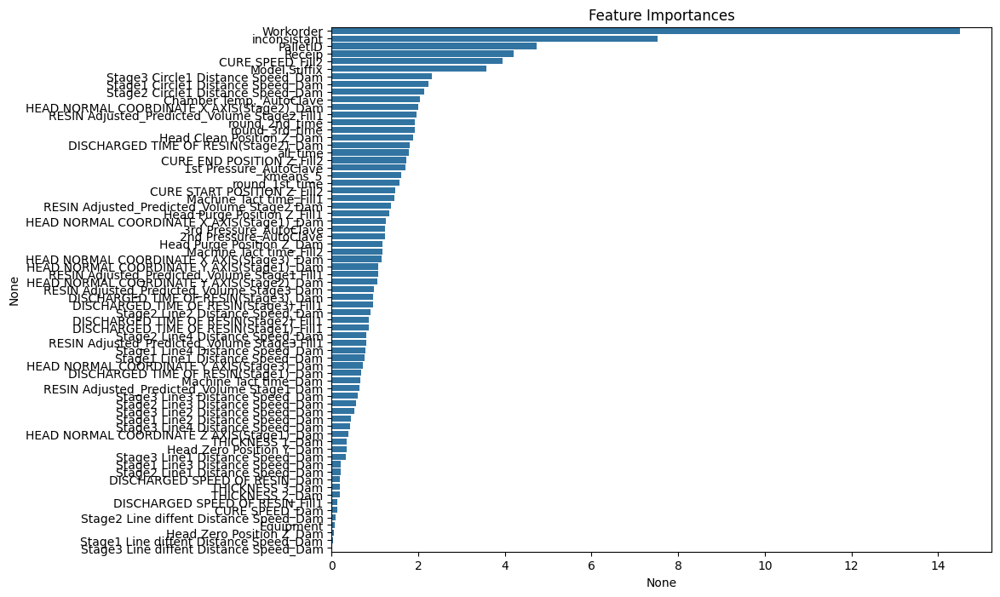

0:	learn: 0.6602416	total: 14.2ms	remaining: 11.3s
100:	learn: 0.2067349	total: 1.75s	remaining: 12.1s
200:	learn: 0.1999635	total: 3.57s	remaining: 10.6s
300:	learn: 0.1950853	total: 5.47s	remaining: 9.05s
400:	learn: 0.1894928	total: 7.33s	remaining: 7.28s
500:	learn: 0.1822889	total: 9.29s	remaining: 5.53s
600:	learn: 0.1743010	total: 11.3s	remaining: 3.72s
700:	learn: 0.1658548	total: 13.3s	remaining: 1.86s
798:	learn: 0.1587278	total: 15.3s	remaining: 0us
0:	learn: 0.6605091	total: 7.62ms	remaining: 6.08s
100:	learn: 0.2064680	total: 1.67s	remaining: 11.5s
200:	learn: 0.1999566	total: 3.42s	remaining: 10.2s
300:	learn: 0.1945414	total: 5.2s	remaining: 8.6s
400:	learn: 0.1886221	total: 7.04s	remaining: 6.99s
500:	learn: 0.1817172	total: 8.88s	remaining: 5.28s
600:	learn: 0.1759361	total: 10.8s	remaining: 3.55s
700:	learn: 0.1683412	total: 12.7s	remaining: 1.77s
798:	learn: 0.1612081	total: 14.5s	remaining: 0us
0:	learn: 0.6602309	total: 20ms	remaining: 16s
100:	learn: 0.2065307	tot

600:	learn: 0.1693641	total: 10.1s	remaining: 3.34s
700:	learn: 0.1618203	total: 11.9s	remaining: 1.66s
798:	learn: 0.1541470	total: 13.6s	remaining: 0us
0:	learn: 0.6601739	total: 17.9ms	remaining: 14.3s
100:	learn: 0.2052947	total: 1.5s	remaining: 10.4s
200:	learn: 0.1969390	total: 3.07s	remaining: 9.13s
300:	learn: 0.1906393	total: 4.65s	remaining: 7.7s
400:	learn: 0.1826220	total: 6.28s	remaining: 6.23s
500:	learn: 0.1753738	total: 7.88s	remaining: 4.69s
600:	learn: 0.1674251	total: 9.49s	remaining: 3.13s
700:	learn: 0.1600110	total: 11.1s	remaining: 1.55s
798:	learn: 0.1536464	total: 12.7s	remaining: 0us
0:	learn: 0.6601772	total: 15.9ms	remaining: 12.7s
100:	learn: 0.2042867	total: 1.34s	remaining: 9.3s
200:	learn: 0.1962404	total: 2.78s	remaining: 8.27s
300:	learn: 0.1892933	total: 4.17s	remaining: 6.91s
400:	learn: 0.1816173	total: 5.6s	remaining: 5.56s
500:	learn: 0.1740899	total: 7.07s	remaining: 4.2s
600:	learn: 0.1666362	total: 8.5s	remaining: 2.8s
700:	learn: 0.1598270	tot

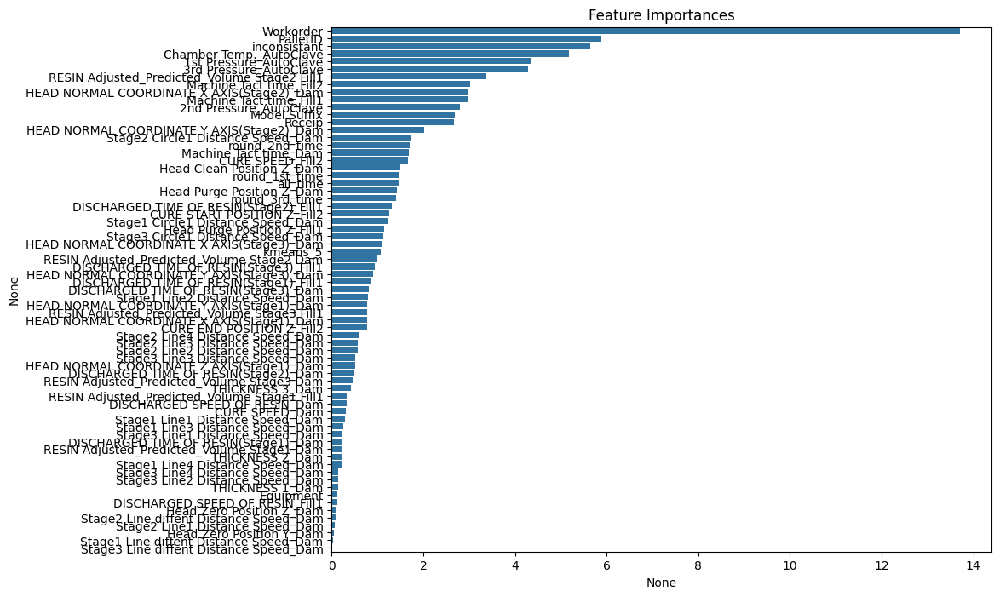

0:	learn: 0.6601770	total: 13.8ms	remaining: 11s
100:	learn: 0.2048499	total: 1.77s	remaining: 12.3s
200:	learn: 0.1971632	total: 3.61s	remaining: 10.8s
300:	learn: 0.1921347	total: 5.51s	remaining: 9.12s
400:	learn: 0.1861853	total: 7.38s	remaining: 7.33s
500:	learn: 0.1763578	total: 9.35s	remaining: 5.56s
600:	learn: 0.1674517	total: 11.3s	remaining: 3.73s
700:	learn: 0.1587480	total: 13.3s	remaining: 1.86s
798:	learn: 0.1516919	total: 15.2s	remaining: 0us
0:	learn: 0.6601305	total: 23.4ms	remaining: 18.7s
100:	learn: 0.2044400	total: 1.7s	remaining: 11.8s
200:	learn: 0.1967938	total: 3.49s	remaining: 10.4s
300:	learn: 0.1911660	total: 5.3s	remaining: 8.78s
400:	learn: 0.1851057	total: 7.16s	remaining: 7.1s
500:	learn: 0.1752292	total: 9.06s	remaining: 5.39s
600:	learn: 0.1669637	total: 11s	remaining: 3.62s
700:	learn: 0.1592370	total: 12.9s	remaining: 1.8s
798:	learn: 0.1512159	total: 14.8s	remaining: 0us
0:	learn: 0.6596272	total: 24.4ms	remaining: 19.4s
100:	learn: 0.2040877	total

600:	learn: 0.1635336	total: 10.1s	remaining: 3.33s
700:	learn: 0.1558015	total: 11.9s	remaining: 1.66s
798:	learn: 0.1486188	total: 13.7s	remaining: 0us
0:	learn: 0.6600223	total: 18.1ms	remaining: 14.5s
100:	learn: 0.2028236	total: 1.44s	remaining: 9.97s
200:	learn: 0.1946962	total: 2.96s	remaining: 8.81s
300:	learn: 0.1887360	total: 4.48s	remaining: 7.41s
400:	learn: 0.1810332	total: 6.01s	remaining: 5.97s
500:	learn: 0.1715708	total: 7.6s	remaining: 4.52s
600:	learn: 0.1624951	total: 9.18s	remaining: 3.02s
700:	learn: 0.1548182	total: 10.8s	remaining: 1.5s
798:	learn: 0.1473251	total: 12.3s	remaining: 0us
0:	learn: 0.6600073	total: 16ms	remaining: 12.8s
100:	learn: 0.2031584	total: 1.34s	remaining: 9.25s
200:	learn: 0.1944912	total: 2.74s	remaining: 8.14s
300:	learn: 0.1881128	total: 4.13s	remaining: 6.84s
400:	learn: 0.1801804	total: 5.59s	remaining: 5.55s
500:	learn: 0.1708471	total: 7.07s	remaining: 4.2s
600:	learn: 0.1620576	total: 8.53s	remaining: 2.81s
700:	learn: 0.1539407	t

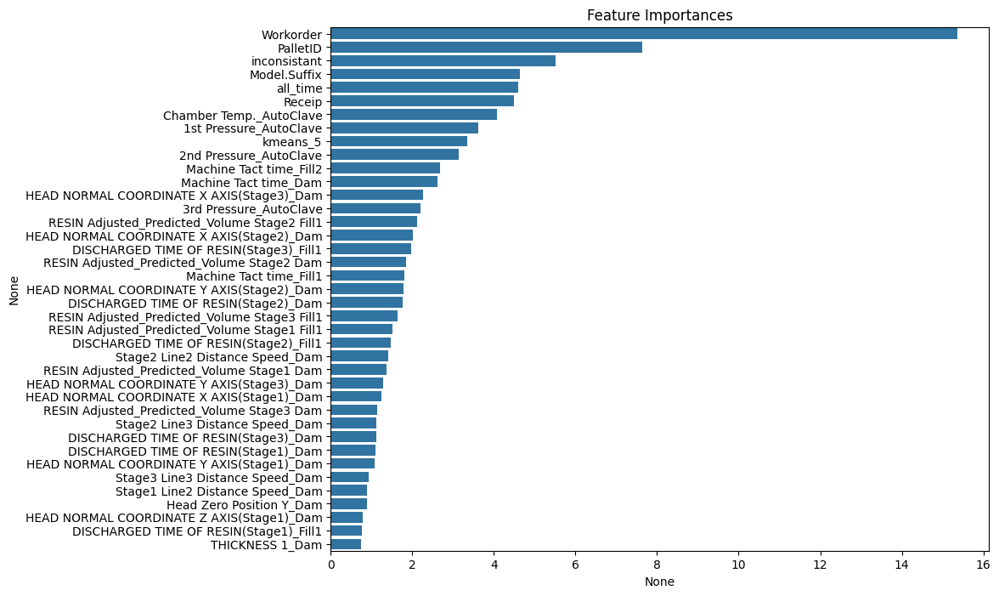

0:	learn: 0.6601687	total: 12.4ms	remaining: 9.86s
100:	learn: 0.2060702	total: 1.78s	remaining: 12.3s
200:	learn: 0.1991023	total: 3.69s	remaining: 11s
300:	learn: 0.1938523	total: 5.67s	remaining: 9.38s
400:	learn: 0.1881737	total: 7.64s	remaining: 7.58s
500:	learn: 0.1807387	total: 9.67s	remaining: 5.75s
600:	learn: 0.1740614	total: 11.7s	remaining: 3.84s
700:	learn: 0.1653520	total: 13.7s	remaining: 1.92s
798:	learn: 0.1577813	total: 15.7s	remaining: 0us
0:	learn: 0.6602759	total: 22.8ms	remaining: 18.2s
100:	learn: 0.2057531	total: 1.74s	remaining: 12.1s
200:	learn: 0.1987726	total: 3.59s	remaining: 10.7s
300:	learn: 0.1935646	total: 5.43s	remaining: 8.99s
400:	learn: 0.1876941	total: 7.36s	remaining: 7.3s
500:	learn: 0.1809417	total: 9.3s	remaining: 5.53s
600:	learn: 0.1730986	total: 11.3s	remaining: 3.72s
700:	learn: 0.1646544	total: 13.3s	remaining: 1.86s
798:	learn: 0.1567348	total: 15.2s	remaining: 0us
0:	learn: 0.6597067	total: 19.8ms	remaining: 15.8s
100:	learn: 0.2059452	t

600:	learn: 0.1738248	total: 10.1s	remaining: 3.31s
700:	learn: 0.1666354	total: 11.8s	remaining: 1.66s
798:	learn: 0.1596776	total: 13.6s	remaining: 0us
0:	learn: 0.6601756	total: 16.6ms	remaining: 13.2s
100:	learn: 0.2040272	total: 1.49s	remaining: 10.3s
200:	learn: 0.1957070	total: 3.02s	remaining: 9s
300:	learn: 0.1904574	total: 4.57s	remaining: 7.57s
400:	learn: 0.1838410	total: 6.12s	remaining: 6.08s
500:	learn: 0.1773943	total: 7.7s	remaining: 4.58s
600:	learn: 0.1713234	total: 9.31s	remaining: 3.07s
700:	learn: 0.1634969	total: 11s	remaining: 1.53s
798:	learn: 0.1562620	total: 12.6s	remaining: 0us
0:	learn: 0.6595511	total: 17.7ms	remaining: 14.1s
100:	learn: 0.2046838	total: 1.27s	remaining: 8.76s
200:	learn: 0.1961432	total: 2.62s	remaining: 7.79s
300:	learn: 0.1900428	total: 4.01s	remaining: 6.64s
400:	learn: 0.1820772	total: 5.44s	remaining: 5.4s
500:	learn: 0.1756556	total: 6.86s	remaining: 4.08s
600:	learn: 0.1695431	total: 8.37s	remaining: 2.76s
700:	learn: 0.1622076	tot

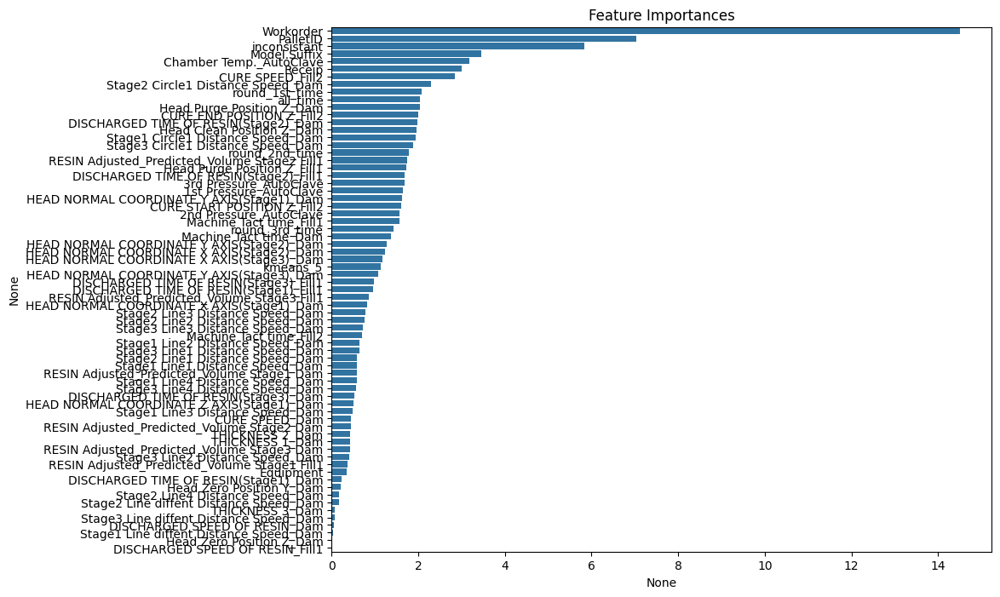

0:	learn: 0.6601179	total: 15.6ms	remaining: 12.4s
100:	learn: 0.2050646	total: 1.72s	remaining: 11.9s
200:	learn: 0.1982688	total: 3.53s	remaining: 10.5s
300:	learn: 0.1931312	total: 5.32s	remaining: 8.8s
400:	learn: 0.1871737	total: 7.2s	remaining: 7.15s
500:	learn: 0.1796083	total: 9.13s	remaining: 5.43s
600:	learn: 0.1724681	total: 11.1s	remaining: 3.64s
700:	learn: 0.1640418	total: 13s	remaining: 1.82s
798:	learn: 0.1561680	total: 14.9s	remaining: 0us
0:	learn: 0.6602937	total: 20.5ms	remaining: 16.3s
100:	learn: 0.2050288	total: 1.59s	remaining: 11s
200:	learn: 0.1976624	total: 3.31s	remaining: 9.84s
300:	learn: 0.1921128	total: 5.08s	remaining: 8.4s
400:	learn: 0.1853483	total: 6.86s	remaining: 6.81s
500:	learn: 0.1776477	total: 8.71s	remaining: 5.18s
600:	learn: 0.1711137	total: 10.5s	remaining: 3.45s
700:	learn: 0.1639414	total: 12.3s	remaining: 1.72s
798:	learn: 0.1564528	total: 14.2s	remaining: 0us
0:	learn: 0.6599899	total: 22.8ms	remaining: 18.2s
100:	learn: 0.2038967	tota

600:	learn: 0.1673092	total: 10.3s	remaining: 3.39s
700:	learn: 0.1594158	total: 12.1s	remaining: 1.69s
798:	learn: 0.1520724	total: 13.9s	remaining: 0us
0:	learn: 0.6602287	total: 17.6ms	remaining: 14s
100:	learn: 0.2035546	total: 1.51s	remaining: 10.4s
200:	learn: 0.1951247	total: 3.08s	remaining: 9.16s
300:	learn: 0.1889223	total: 4.66s	remaining: 7.71s
400:	learn: 0.1813495	total: 6.29s	remaining: 6.24s
500:	learn: 0.1738154	total: 7.92s	remaining: 4.71s
600:	learn: 0.1663303	total: 9.55s	remaining: 3.15s
700:	learn: 0.1596438	total: 11.2s	remaining: 1.56s
798:	learn: 0.1532370	total: 12.8s	remaining: 0us
0:	learn: 0.6596272	total: 19ms	remaining: 15.2s
100:	learn: 0.2043631	total: 1.3s	remaining: 9.02s
200:	learn: 0.1967135	total: 2.64s	remaining: 7.86s
300:	learn: 0.1897237	total: 4.04s	remaining: 6.68s
400:	learn: 0.1814751	total: 5.53s	remaining: 5.49s
500:	learn: 0.1740873	total: 7.02s	remaining: 4.18s
600:	learn: 0.1665516	total: 8.5s	remaining: 2.8s
700:	learn: 0.1593620	tot

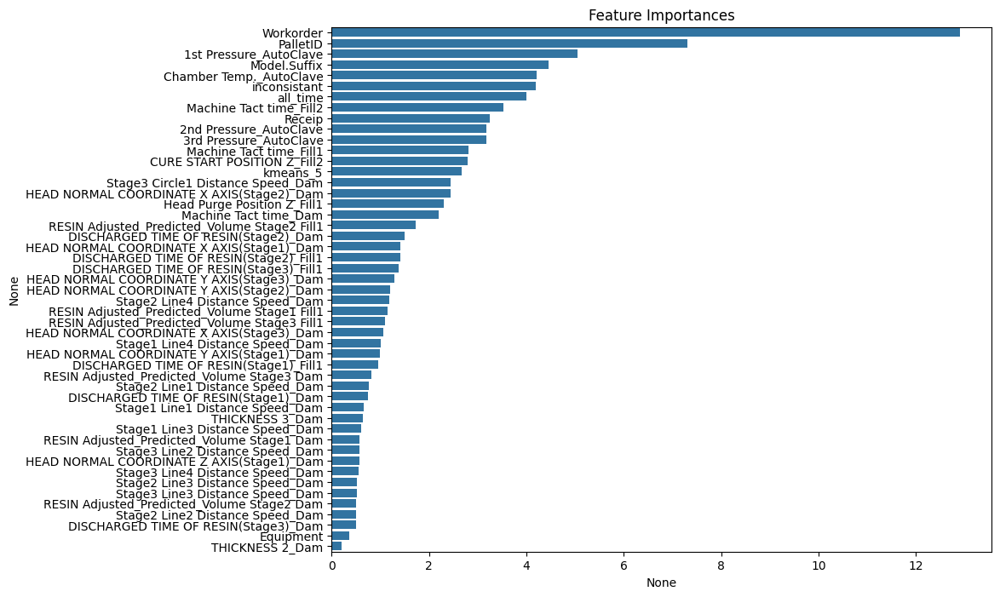

0:	learn: 0.6602018	total: 13.9ms	remaining: 11.1s
100:	learn: 0.2051462	total: 1.8s	remaining: 12.4s
200:	learn: 0.1976026	total: 3.75s	remaining: 11.2s
300:	learn: 0.1926205	total: 5.7s	remaining: 9.43s
400:	learn: 0.1863310	total: 7.71s	remaining: 7.65s
500:	learn: 0.1797914	total: 9.67s	remaining: 5.75s
600:	learn: 0.1742576	total: 11.7s	remaining: 3.86s
700:	learn: 0.1670596	total: 13.8s	remaining: 1.93s
798:	learn: 0.1608589	total: 15.9s	remaining: 0us
0:	learn: 0.6599663	total: 21.9ms	remaining: 17.5s
100:	learn: 0.2051848	total: 1.66s	remaining: 11.5s
200:	learn: 0.1979688	total: 3.49s	remaining: 10.4s
300:	learn: 0.1929761	total: 5.3s	remaining: 8.77s
400:	learn: 0.1865886	total: 7.22s	remaining: 7.17s
500:	learn: 0.1798006	total: 9.21s	remaining: 5.48s
600:	learn: 0.1744674	total: 11.1s	remaining: 3.67s
700:	learn: 0.1665833	total: 13.1s	remaining: 1.84s
798:	learn: 0.1604788	total: 15.1s	remaining: 0us
0:	learn: 0.6603460	total: 20ms	remaining: 15.9s
100:	learn: 0.2044575	to

600:	learn: 0.1688126	total: 10.8s	remaining: 3.55s
700:	learn: 0.1603710	total: 12.7s	remaining: 1.77s
798:	learn: 0.1529004	total: 14.6s	remaining: 0us
0:	learn: 0.6602311	total: 18.3ms	remaining: 14.6s
100:	learn: 0.2032183	total: 1.56s	remaining: 10.8s
200:	learn: 0.1949075	total: 3.16s	remaining: 9.41s
300:	learn: 0.1891439	total: 4.78s	remaining: 7.91s
400:	learn: 0.1817560	total: 6.48s	remaining: 6.43s
500:	learn: 0.1738876	total: 8.2s	remaining: 4.87s
600:	learn: 0.1662653	total: 9.89s	remaining: 3.26s
700:	learn: 0.1594019	total: 11.6s	remaining: 1.62s
798:	learn: 0.1532928	total: 13.3s	remaining: 0us
0:	learn: 0.6593245	total: 15.2ms	remaining: 12.2s
100:	learn: 0.2027144	total: 1.33s	remaining: 9.22s
200:	learn: 0.1949513	total: 2.73s	remaining: 8.13s
300:	learn: 0.1881168	total: 4.24s	remaining: 7.02s
400:	learn: 0.1805491	total: 5.75s	remaining: 5.71s
500:	learn: 0.1735043	total: 7.3s	remaining: 4.34s
600:	learn: 0.1664116	total: 8.79s	remaining: 2.9s
700:	learn: 0.1593636

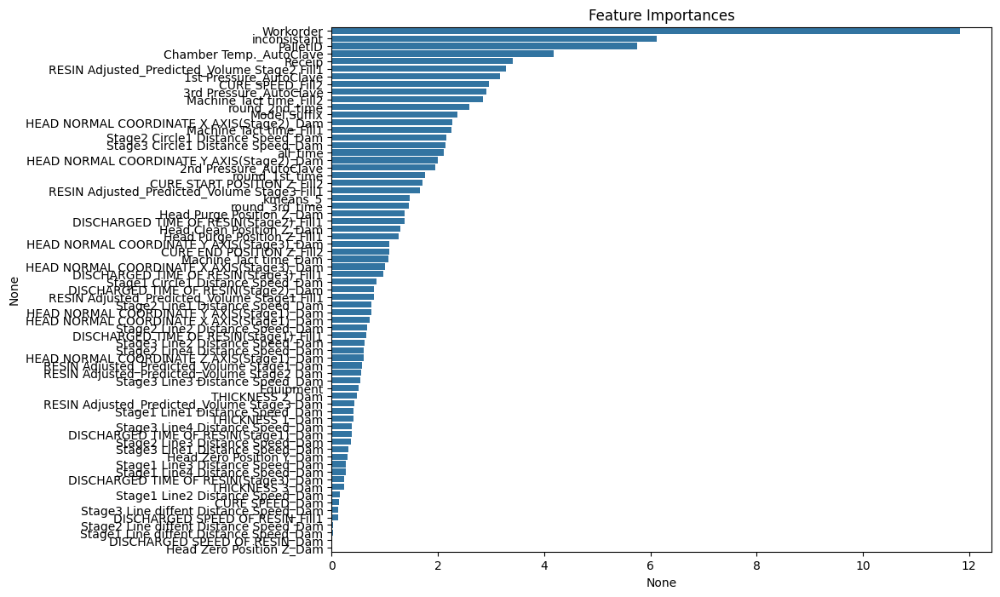

0:	learn: 0.6601547	total: 11.3ms	remaining: 9.01s
100:	learn: 0.2045624	total: 1.77s	remaining: 12.3s
200:	learn: 0.1975867	total: 3.67s	remaining: 10.9s
300:	learn: 0.1926453	total: 5.6s	remaining: 9.27s
400:	learn: 0.1864118	total: 7.53s	remaining: 7.47s
500:	learn: 0.1796704	total: 9.54s	remaining: 5.67s
600:	learn: 0.1735496	total: 11.6s	remaining: 3.81s
700:	learn: 0.1674795	total: 13.6s	remaining: 1.9s
798:	learn: 0.1601757	total: 15.5s	remaining: 0us
0:	learn: 0.6602536	total: 26.2ms	remaining: 20.9s
100:	learn: 0.2042546	total: 1.7s	remaining: 11.7s
200:	learn: 0.1968364	total: 3.42s	remaining: 10.2s
300:	learn: 0.1911622	total: 5.23s	remaining: 8.65s
400:	learn: 0.1853019	total: 7s	remaining: 6.95s
500:	learn: 0.1802048	total: 8.82s	remaining: 5.25s
600:	learn: 0.1765523	total: 10.6s	remaining: 3.5s
700:	learn: 0.1691511	total: 12.5s	remaining: 1.75s
798:	learn: 0.1615326	total: 14.4s	remaining: 0us
0:	learn: 0.6601959	total: 19.1ms	remaining: 15.2s
100:	learn: 0.2038252	tota

600:	learn: 0.1709650	total: 10.1s	remaining: 3.32s
700:	learn: 0.1639659	total: 11.8s	remaining: 1.65s
798:	learn: 0.1574312	total: 13.6s	remaining: 0us
0:	learn: 0.6601612	total: 16.6ms	remaining: 13.2s
100:	learn: 0.2031410	total: 1.38s	remaining: 9.57s
200:	learn: 0.1950636	total: 2.86s	remaining: 8.5s
300:	learn: 0.1887164	total: 4.42s	remaining: 7.31s
400:	learn: 0.1817042	total: 6.01s	remaining: 5.97s
500:	learn: 0.1766002	total: 7.51s	remaining: 4.47s
600:	learn: 0.1711528	total: 9s	remaining: 2.96s
700:	learn: 0.1640072	total: 10.5s	remaining: 1.47s
798:	learn: 0.1579319	total: 12.1s	remaining: 0us
0:	learn: 0.6595572	total: 14.5ms	remaining: 11.5s
100:	learn: 0.2034357	total: 1.23s	remaining: 8.51s
200:	learn: 0.1958225	total: 2.56s	remaining: 7.61s
300:	learn: 0.1891227	total: 3.9s	remaining: 6.46s
400:	learn: 0.1812316	total: 5.3s	remaining: 5.26s
500:	learn: 0.1745137	total: 6.75s	remaining: 4.01s
600:	learn: 0.1691689	total: 8.16s	remaining: 2.69s
700:	learn: 0.1635801	to

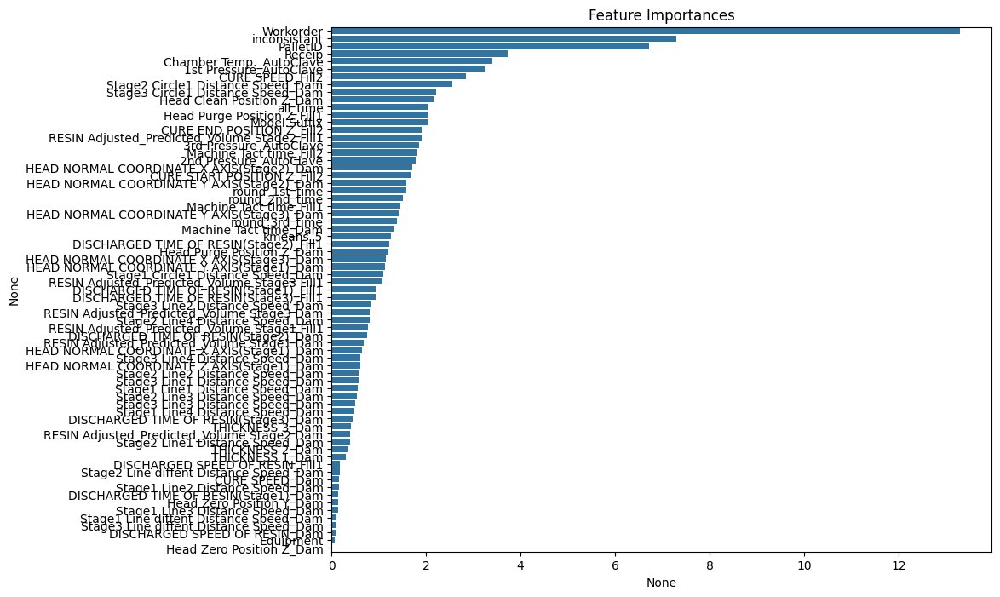

0:	learn: 0.6602184	total: 13.7ms	remaining: 11s
100:	learn: 0.2049281	total: 1.72s	remaining: 11.9s
200:	learn: 0.1978613	total: 3.55s	remaining: 10.6s
300:	learn: 0.1929761	total: 5.39s	remaining: 8.93s
400:	learn: 0.1875472	total: 7.33s	remaining: 7.28s
500:	learn: 0.1816432	total: 9.3s	remaining: 5.53s
600:	learn: 0.1740870	total: 11.3s	remaining: 3.71s
700:	learn: 0.1662556	total: 13.2s	remaining: 1.85s
798:	learn: 0.1586186	total: 15.2s	remaining: 0us
0:	learn: 0.6603829	total: 22.7ms	remaining: 18.1s
100:	learn: 0.2051322	total: 1.69s	remaining: 11.7s
200:	learn: 0.1978478	total: 3.37s	remaining: 10s
300:	learn: 0.1927019	total: 5.08s	remaining: 8.4s
400:	learn: 0.1859498	total: 6.94s	remaining: 6.88s
500:	learn: 0.1800444	total: 8.78s	remaining: 5.22s
600:	learn: 0.1749279	total: 10.6s	remaining: 3.5s
700:	learn: 0.1661389	total: 12.5s	remaining: 1.75s
798:	learn: 0.1580429	total: 14.4s	remaining: 0us
0:	learn: 0.6602663	total: 21.6ms	remaining: 17.2s
100:	learn: 0.2048468	tota

600:	learn: 0.1677537	total: 9.98s	remaining: 3.29s
700:	learn: 0.1605019	total: 11.7s	remaining: 1.64s
798:	learn: 0.1524447	total: 13.4s	remaining: 0us
0:	learn: 0.6600521	total: 21.2ms	remaining: 16.9s
100:	learn: 0.2032019	total: 1.44s	remaining: 9.96s
200:	learn: 0.1954388	total: 2.93s	remaining: 8.72s
300:	learn: 0.1892253	total: 4.45s	remaining: 7.35s
400:	learn: 0.1809647	total: 6.06s	remaining: 6.01s
500:	learn: 0.1731981	total: 7.7s	remaining: 4.58s
600:	learn: 0.1675358	total: 9.3s	remaining: 3.06s
700:	learn: 0.1601580	total: 10.9s	remaining: 1.52s
798:	learn: 0.1539969	total: 12.5s	remaining: 0us
0:	learn: 0.6595049	total: 14.8ms	remaining: 11.8s
100:	learn: 0.2028686	total: 1.32s	remaining: 9.13s
200:	learn: 0.1951615	total: 2.65s	remaining: 7.88s
300:	learn: 0.1883530	total: 4.08s	remaining: 6.76s
400:	learn: 0.1803396	total: 5.53s	remaining: 5.49s
500:	learn: 0.1739711	total: 6.96s	remaining: 4.14s
600:	learn: 0.1689945	total: 8.3s	remaining: 2.73s
700:	learn: 0.1598750

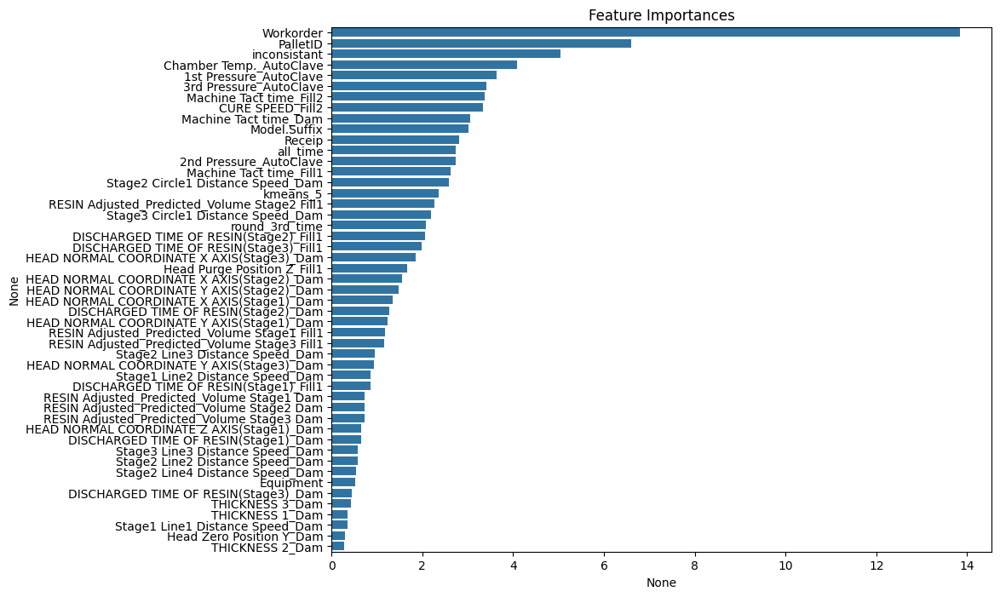

0:	learn: 0.6601208	total: 13.4ms	remaining: 10.7s
100:	learn: 0.2051371	total: 1.85s	remaining: 12.8s
200:	learn: 0.1981235	total: 3.75s	remaining: 11.2s
300:	learn: 0.1934107	total: 5.75s	remaining: 9.52s
400:	learn: 0.1874879	total: 7.76s	remaining: 7.7s
500:	learn: 0.1814524	total: 9.83s	remaining: 5.85s
600:	learn: 0.1749755	total: 11.9s	remaining: 3.92s
700:	learn: 0.1671202	total: 14s	remaining: 1.96s
798:	learn: 0.1598189	total: 16.1s	remaining: 0us
0:	learn: 0.6601627	total: 26.1ms	remaining: 20.8s
100:	learn: 0.2052177	total: 1.76s	remaining: 12.1s
200:	learn: 0.1979255	total: 3.59s	remaining: 10.7s
300:	learn: 0.1924839	total: 5.41s	remaining: 8.95s
400:	learn: 0.1863969	total: 7.22s	remaining: 7.16s
500:	learn: 0.1803487	total: 9.16s	remaining: 5.45s
600:	learn: 0.1741937	total: 11.1s	remaining: 3.67s
700:	learn: 0.1668564	total: 13.1s	remaining: 1.84s
798:	learn: 0.1582100	total: 15.1s	remaining: 0us
0:	learn: 0.6602667	total: 20.4ms	remaining: 16.3s
100:	learn: 0.2047533	

600:	learn: 0.1741907	total: 10.3s	remaining: 3.39s
700:	learn: 0.1669869	total: 12.1s	remaining: 1.69s
798:	learn: 0.1572382	total: 13.9s	remaining: 0us
0:	learn: 0.6602139	total: 17ms	remaining: 13.6s
100:	learn: 0.2039885	total: 1.47s	remaining: 10.1s
200:	learn: 0.1955810	total: 3.06s	remaining: 9.11s
300:	learn: 0.1887790	total: 4.67s	remaining: 7.72s
400:	learn: 0.1815164	total: 6.34s	remaining: 6.29s
500:	learn: 0.1753121	total: 7.99s	remaining: 4.75s
600:	learn: 0.1674813	total: 9.65s	remaining: 3.18s
700:	learn: 0.1595521	total: 11.4s	remaining: 1.59s
798:	learn: 0.1521588	total: 13s	remaining: 0us
0:	learn: 0.6598771	total: 5.08ms	remaining: 4.05s
100:	learn: 0.2038583	total: 1.3s	remaining: 8.97s
200:	learn: 0.1949658	total: 2.73s	remaining: 8.14s
300:	learn: 0.1879659	total: 4.24s	remaining: 7.01s
400:	learn: 0.1799917	total: 5.73s	remaining: 5.69s
500:	learn: 0.1723802	total: 7.22s	remaining: 4.29s
600:	learn: 0.1668422	total: 8.71s	remaining: 2.87s
700:	learn: 0.1589370	t

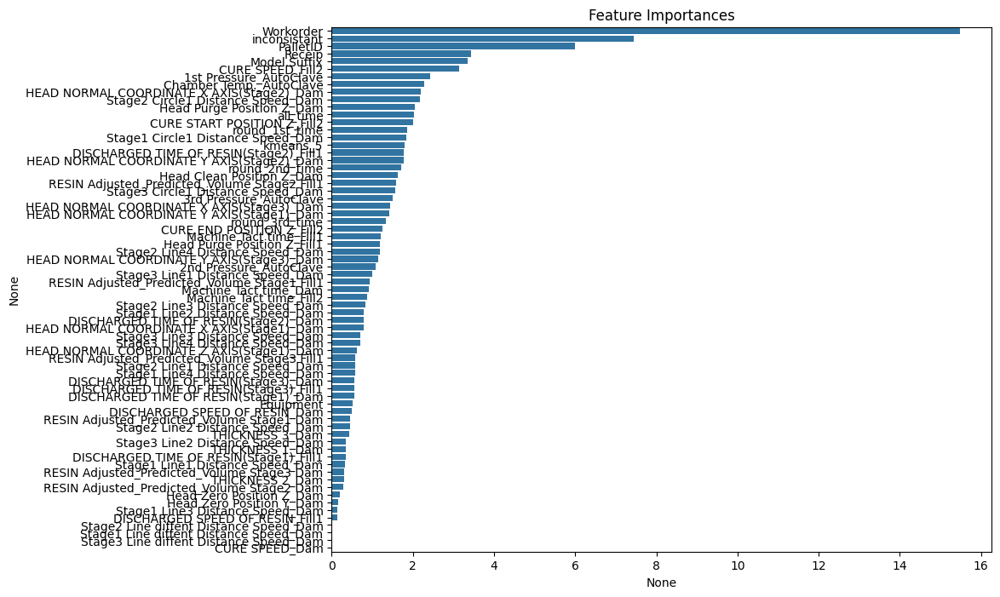

0:	learn: 0.6601958	total: 14.4ms	remaining: 11.5s
100:	learn: 0.2045930	total: 1.85s	remaining: 12.8s
200:	learn: 0.1972647	total: 3.76s	remaining: 11.2s
300:	learn: 0.1921906	total: 5.74s	remaining: 9.5s
400:	learn: 0.1864329	total: 7.78s	remaining: 7.73s
500:	learn: 0.1806468	total: 9.86s	remaining: 5.86s
600:	learn: 0.1739727	total: 11.9s	remaining: 3.93s
700:	learn: 0.1647708	total: 14.1s	remaining: 1.97s
798:	learn: 0.1569042	total: 16.2s	remaining: 0us
0:	learn: 0.6601245	total: 22.9ms	remaining: 18.3s
100:	learn: 0.2046415	total: 1.75s	remaining: 12.1s
200:	learn: 0.1974443	total: 3.58s	remaining: 10.6s
300:	learn: 0.1921999	total: 5.4s	remaining: 8.94s
400:	learn: 0.1864093	total: 7.28s	remaining: 7.22s
500:	learn: 0.1806999	total: 9.18s	remaining: 5.46s
600:	learn: 0.1736061	total: 11.1s	remaining: 3.67s
700:	learn: 0.1664559	total: 13.2s	remaining: 1.84s
798:	learn: 0.1577254	total: 15.1s	remaining: 0us
0:	learn: 0.6596941	total: 18.5ms	remaining: 14.8s
100:	learn: 0.2046747

600:	learn: 0.1700830	total: 11s	remaining: 3.62s
700:	learn: 0.1620507	total: 12.9s	remaining: 1.81s
798:	learn: 0.1537012	total: 14.9s	remaining: 0us
0:	learn: 0.6602652	total: 22.7ms	remaining: 18.1s
100:	learn: 0.2040186	total: 1.58s	remaining: 10.9s
200:	learn: 0.1955539	total: 3.2s	remaining: 9.51s
300:	learn: 0.1892665	total: 4.87s	remaining: 8.05s
400:	learn: 0.1824795	total: 6.6s	remaining: 6.55s
500:	learn: 0.1750279	total: 8.34s	remaining: 4.96s
600:	learn: 0.1676517	total: 10.1s	remaining: 3.32s
700:	learn: 0.1589517	total: 11.9s	remaining: 1.66s
798:	learn: 0.1505315	total: 13.7s	remaining: 0us
0:	learn: 0.6596255	total: 16.1ms	remaining: 12.9s
100:	learn: 0.2044987	total: 1.36s	remaining: 9.41s
200:	learn: 0.1958659	total: 2.88s	remaining: 8.56s
300:	learn: 0.1890097	total: 4.43s	remaining: 7.33s
400:	learn: 0.1805557	total: 6.08s	remaining: 6.04s
500:	learn: 0.1725641	total: 7.71s	remaining: 4.58s
600:	learn: 0.1662472	total: 9.36s	remaining: 3.08s
700:	learn: 0.1596104	

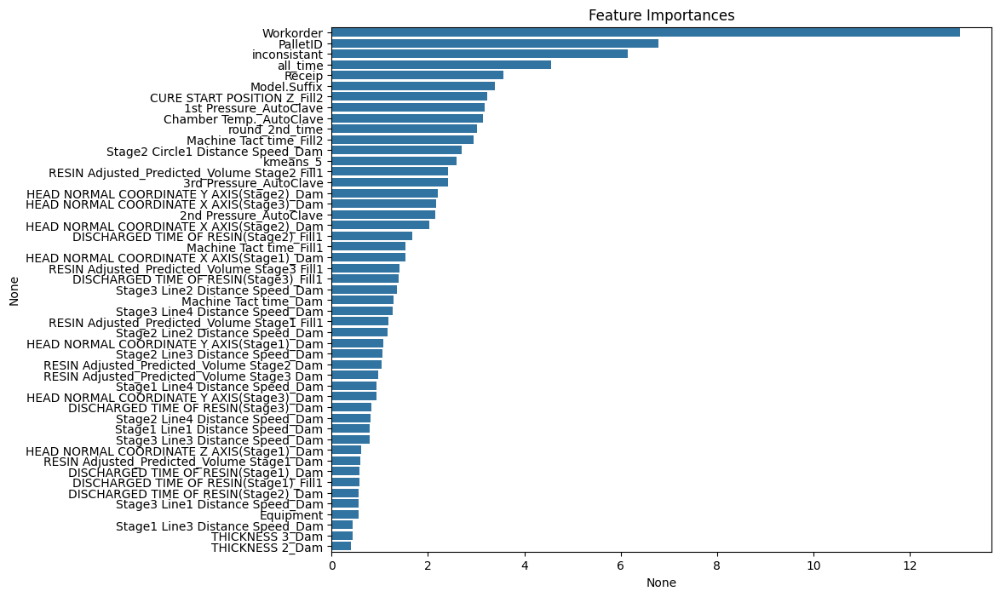

In [63]:
# Stratified cv fitting models

# 해당 모델 저장 리스트
models_cat_train = []
select_variables_cat = []

# split마다 모델 적합하기
for train_idx, valid_idx in tscv.split(X_train_cat_last, y_train_cat_last):
    
    print("="*50)
    # variable select
    cat_best_params["random_seed"] = 42
    cat_best_params["verbose"] = 100
    clf = CatBoostClassifier(**cat_best_params)
    
    min_features_to_select = 30
    step = 10
    selector = RFECV(clf, step=step, cv=5, min_features_to_select=min_features_to_select, scoring = 'f1')
    selector = selector.fit(X_train_cat_last.iloc[train_idx], y_train_cat_last[train_idx])
    
    # 선택된 변수
    selected_value = X_train_cat_last.columns[selector.support_]
    select_variables_cat.append(selected_value)
    
    # real modeling
    cat_best_model = CatBoostClassifier(**cat_best_params)
    
    # fit the model
    cat_best_model.fit(
        X_train_cat_last.loc[train_idx, selected_value], y_train_cat_last[train_idx],
        eval_set = [(X_train_cat_last.loc[valid_idx, selected_value], y_train_cat_last[valid_idx])],
        early_stopping_rounds = 50,
        verbose = 100, cat_features=np.array(cat_features_indices)[np.isin(cat_features_indices, selected_value)]
    )

    # 모델 결과 저장하기
    models_cat_train.append(cat_best_model)
    
    # 위 feature importance를 시각화해봅니다.
    importances = pd.Series(cat_best_model.feature_importances_, index=list(X_train_cat_last[selected_value].columns))
    importances = importances.sort_values(ascending=False)

    plt.figure(figsize=(10,8))
    plt.title("Feature Importances")
    sns.barplot(x=importances, y=importances.index)
    plt.show()

In [64]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_cat_train, select_variables_cat)):
    pred_list.append(model.predict_proba(X_valid_cat_last[var])[:, 1])
    
# 확률값 평균내기
cat_proba = np.mean(pred_list, axis = 0)

In [65]:
# thresholds
precision, recall, thresholds = precision_recall_curve(y_valid_cat_last, cat_proba)
f1_scores = 2*recall*precision / (recall + precision)
cat_best_threshold = thresholds[np.argmax(f1_scores)]
y_pred_custom_threshold_cat = (cat_proba >= cat_best_threshold).astype(int)

In [66]:
get_clf_eval(y_valid_cat_last, y_pred_custom_threshold_cat)

오차행렬:
 [[  98  372]
 [ 403 7229]]

정확도: 0.9043
정밀도: 0.1956
재현율: 0.2085
F1: 0.2019


#### Lightgbm

[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889713
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240352
[LightGBM] [Debug] init for col-wise cost 0.001194 seconds, init for row-wise cost 0.004419 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001632 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1645
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.786888
[LightGBM] [Info] Start training from score -2.786888
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 26
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.845221
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056434
[LightGBM] [Debug] init for col-wise cost 0.000358 seconds, init for row-wise cost 0.001879 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000556 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1380
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.057994 -> initscore=-2.787672
[LightGBM] [Info] Start training from score -2.787672
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.842163
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056234
[LightGBM] [Debug] init for col-wise cost 0.000377 seconds, init for row-wise cost 0.001830 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1376
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889849
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240352
[LightGBM] [Debug] init for col-wise cost 0.001441 seconds, init for row-wise cost 0.005389 seconds
[LightGBM] [I

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889849
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240352
[LightGBM] [Debug] init for col-wise cost 0.001581 seconds, init for row-wise cost 0.005400 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002133 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1656
[LightGBM] [Info] Number of data points in the train set: 29163, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058019 -> initscore=-2.787220
[LightGBM] [Info] Start training from score -2.787220
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

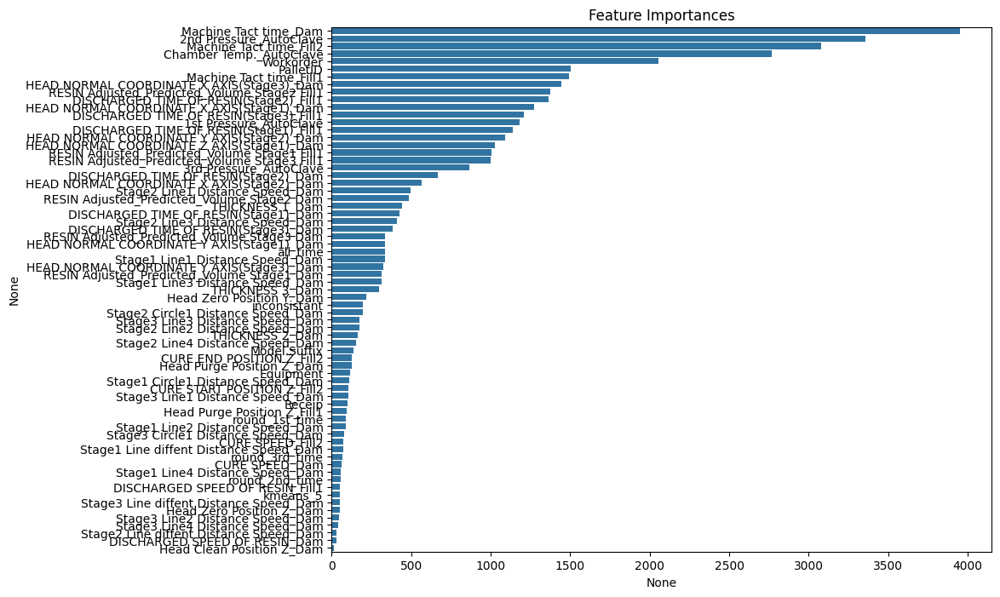

[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889253
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240242
[LightGBM] [Debug] init for col-wise cost 0.001174 seconds, init for row-wise cost 0.004284 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001625 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1643
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.786888
[LightGBM] [Info] Start training from score -2.786888
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[Light

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844192
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056382
[LightGBM] [Debug] init for col-wise cost 0.000401 seconds, init for row-wise cost 0.001894 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1375
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.057994 -> initscore=-2.787672
[LightGBM] [Info] Start training from score -2.787672
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889687
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240291
[LightGBM] [Debug] init for col-wise cost 0.0011

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 45 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[L

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[Light

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 43 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889737
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240322
[LightGBM] [Debug] init for col-wise cost 0.001633 seconds, init for row-wise cost 0.005270 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002175 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1662
[LightGBM] [Info] Number of data points in the train set: 29163, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058019 -> initscore=-2.787220
[LightGBM] [Info] Start training from score -2.787220
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

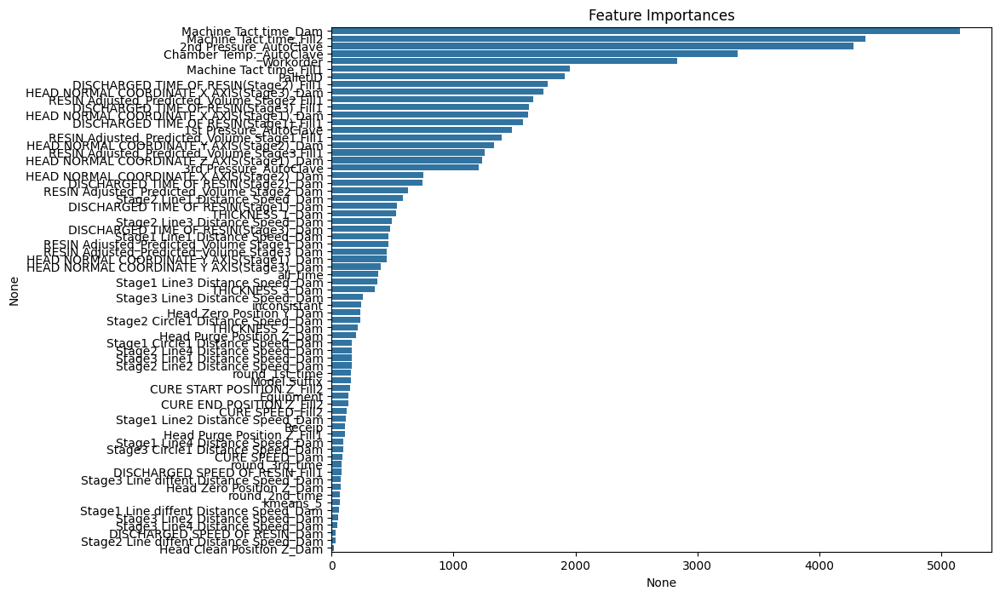

[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889360
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240262
[LightGBM] [Debug] init for col-wise cost 0.001215 seconds, init for row-wise cost 0.004466 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001654 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1642
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.786888
[LightGBM] [Info] Start training from score -2.786888
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.879928
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.218451
[LightGBM] [Debug] init for col-wise cost 0.001006 seconds, init for row-wise cost 0.003507 seconds
[LightGBM] [I

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.900446
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.195389
[LightGBM] [Debug] init for col-wise cost 0.000742 seconds, init for row-wise cost 0.002893 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1532
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.7868

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844556
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056392
[LightGBM] [Debug] init for col-wise cost 0.000397 seconds, init for row-wise cost 0.001891 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1378
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.786888
[LightGBM] [Info] Start training from score -2.786888
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.902134
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.177296
[LightGBM] [Debug] init for col-wise cost 0.000682 seconds, init for row-wise cost 0.002912 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000966 seconds.
You can set `force_row_wise=true` to remo

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844942
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056414
[LightGBM] [Debug] init for col-wise cost 0.000394 seconds, init for row-wise cost 0.001777 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000596 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1384
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.057994 -> initscore=-2.787672
[LightGBM] [Info] Start training from score -2.787672
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.888580
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.211048
[LightGBM] [Debug] init for col-wise cost 0.000813 seconds, init for row-wise cost 0.003091 seconds
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003365 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1527
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 a

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.891553
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.149492
[LightGBM] [Debug] init for col-wise cost 0.000538 seconds, init for row-wise cost 0.002265 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000791 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1459
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 39
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.852842
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.085374
[LightGBM] [Debug] init for col-wise cost 0.000439 seconds, init for row-wise cost 0.001850 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000658 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1371
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 27
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844392
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056390
[LightGBM] [Debug] init for col-wise cost 0.000384 seconds, init for row-wise cost 0.001825 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1383
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889655
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240309
[LightGBM] [Debug] init for col-wise cost 0.001619 seconds, init for row-wise cost 0.005198 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002172 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1657
[LightGBM] [Info] Number of data points in the train set: 29163, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058019 -> initscore=-2.787220
[LightGBM] [Info] Start training from score -2.787220
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

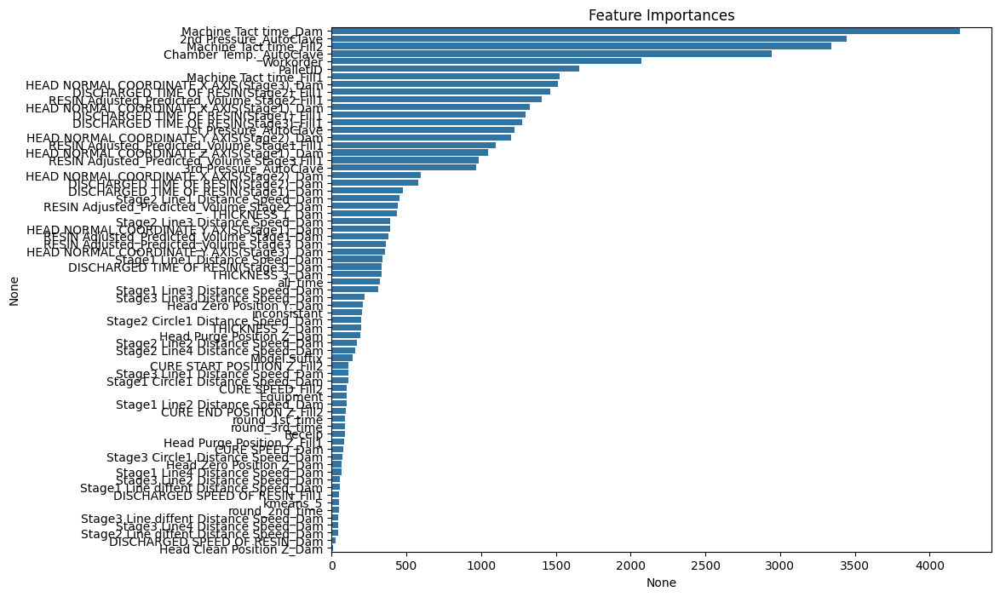

[LightGBM] [Info] Number of positive: 1354, number of negative: 21976
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889491
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240293
[LightGBM] [Debug] init for col-wise cost 0.001160 seconds, init for row-wise cost 0.004050 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001601 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1642
[LightGBM] [Info] Number of data points in the train set: 23330, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058037 -> initscore=-2.786888
[LightGBM] [Info] Start training from score -2.786888
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1353, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889284
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240186
[LightGBM] [Debug] init for col-wise cost 0.001186 seconds, init for row-wise cost 0.004163 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001622 seconds.
You can set `force_row_wise=true` to remo

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 40 and depth = 13
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.852685
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.085353
[LightGBM] [Debug] init for col-wise cost 0.000429 seconds, init for row-wise cost 0.001674 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000629 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1368
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889752
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240322
[LightGBM] [Debug] init for col-wise cost 0.001464 seconds, init for row-wise cost 0.005043 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testi

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27471
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889752
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240322
[LightGBM] [Debug] init for col-wise cost 0.001415 seconds, init for row-wise cost 0.004974 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001967 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1663
[LightGBM] [Info] Number of data points in the train set: 29163, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058019 -> initscore=-2.787220
[LightGBM] [Info] Start training from score -2.787220
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

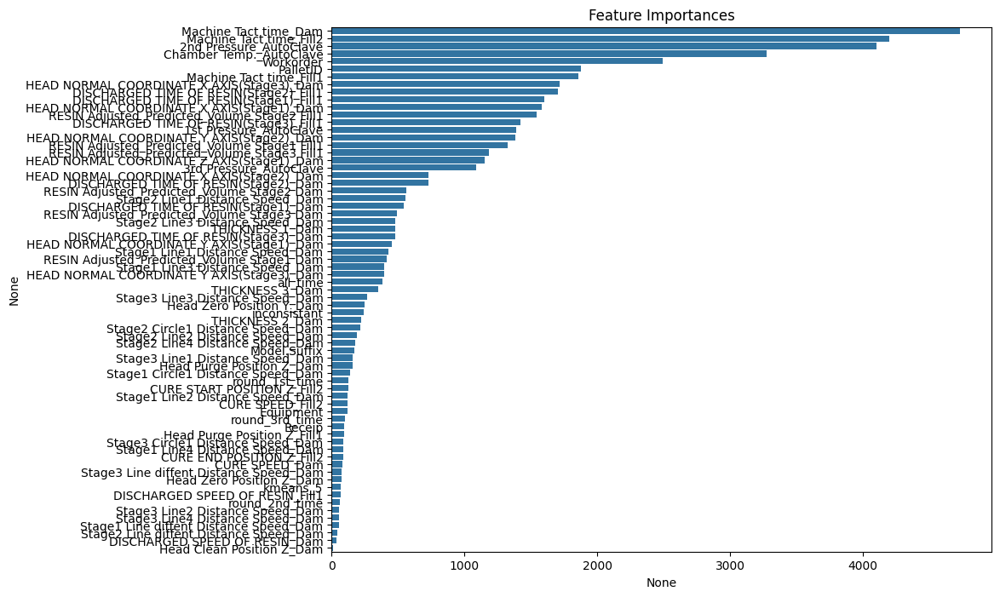

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889418
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240279
[LightGBM] [Debug] init for col-wise cost 0.139998 seconds, init for row-wise cost 0.004236 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.140446 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1645
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889482
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240256
[LightGBM] [Debug] init for col-wise cost 0.001

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 7
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844434
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056407
[LightGBM] [Debug] init for col-wise cost 0.000391 seconds, init for row-wise cost 0.001719 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1383
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Info] Number of positive: 1353, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889684
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sp

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1354, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889979
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240368
[LightGBM] [Debug] init for col-wise cost 0.001172 seconds, init for row-wise cost 0.003995 seconds
[LightGBM] [In

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.854406
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.085543
[LightGBM] [Debug] init for col-wise cost 0.000429 seconds, init for row-wise cost 0.001608 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000637 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1375
[LightGBM] [Info] Number of data points in the train set: 23332, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058032 -> initscore=-2.786979
[LightGBM] [Info] Start training from score -2.786979
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889737
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240315
[LightGBM] [Debug] init for col-wise cost 0.001435 seconds, init for row-wise cost 0.005134 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001990 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1663
[LightGBM] [Info] Number of data points in the train set: 29164, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058017 -> initscore=-2.787256
[LightGBM] [Info] Start training from score -2.787256
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

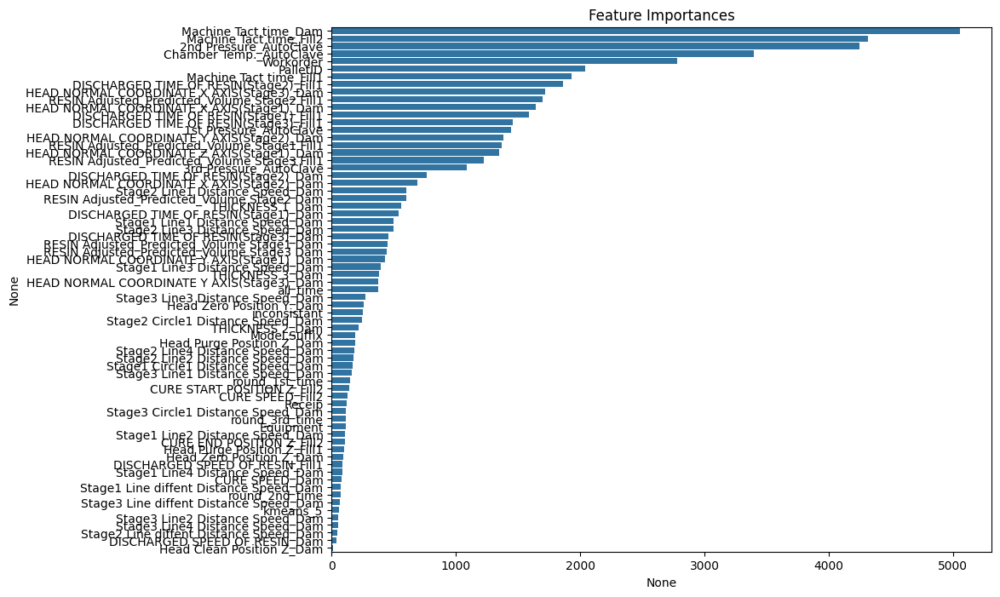

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889175
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240207
[LightGBM] [Debug] init for col-wise cost 0.001140 seconds, init for row-wise cost 0.004129 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001583 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1646
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.854500
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.085557
[LightGBM] [Debug] init for col-wise cost 0.000429 seconds, init for row-wise cost 0.001672 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000644 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1377
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1353, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.890201
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240431
[LightGBM] [Debug] init for col-wise cost 0.001237 seconds, init for row-wise cost 0.004479 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testi

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889636
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240288
[LightGBM] [Debug] init for col-wise cost 0.001620 seconds, init for row-wise cost 0.005541 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002158 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1666
[LightGBM] [Info] Number of data points in the train set: 29164, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058017 -> initscore=-2.787256
[LightGBM] [Info] Start training from score -2.787256
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM]

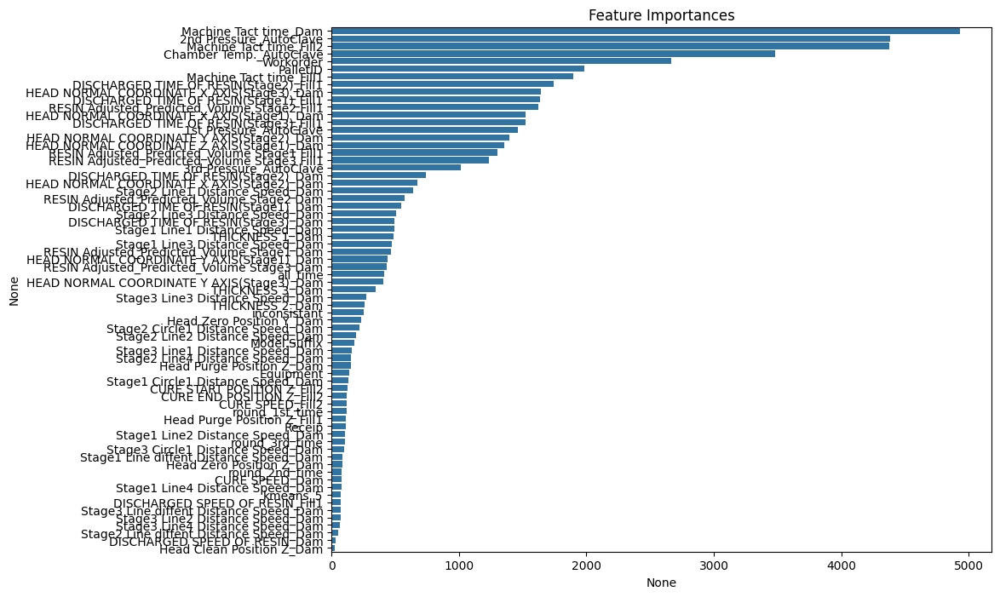

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889968
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240386
[LightGBM] [Debug] init for col-wise cost 0.001157 seconds, init for row-wise cost 0.004776 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1650
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 43 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.890201
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240416
[LightGBM] [Debug] init for col-wise cost 0.001484 seconds, init for row-wise cost 0.005381 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002026 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1667
[LightGBM] [Info] Number of data points in the train set: 29164, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058017 -> initscore=-2.787256
[LightGBM] [Info] Start training from score -2.787256
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

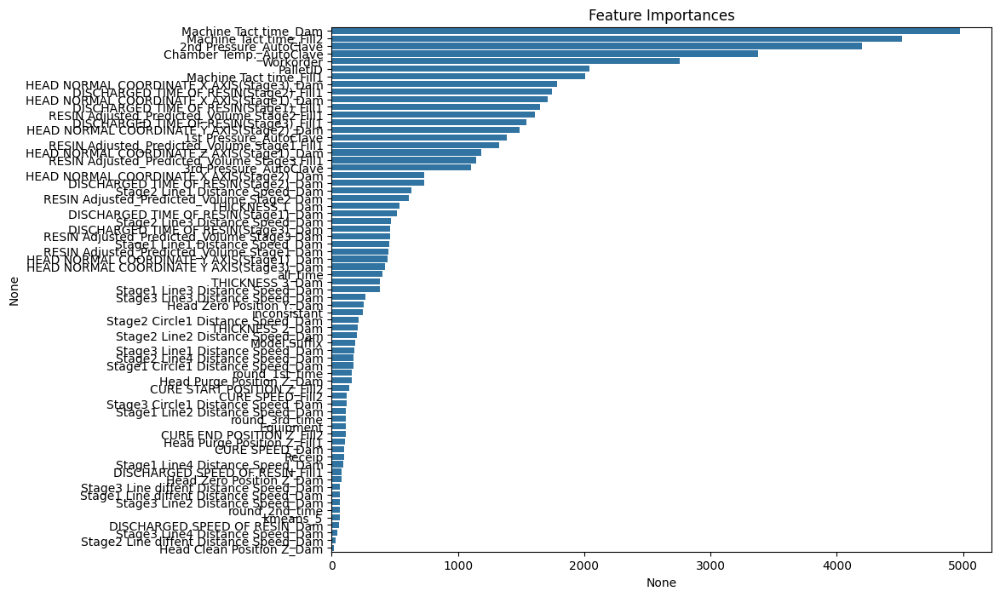

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889644
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240317
[LightGBM] [Debug] init for col-wise cost 0.001132 seconds, init for row-wise cost 0.004466 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001576 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1650
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Info] Number of positive: 1353, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.890258
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240459
[LightGBM] [Debug] init for col-wise cost 0.001173 seconds, init for row-wise cost 0.004422 seconds
[LightGBM] [I

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 25
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 27
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889959
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240370
[LightGBM] [Debug] init for col-wise cost 0.001687 seconds, init for row-wise cost 0.005786 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002233 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1669
[LightGBM] [Info] Number of data points in the train set: 29164, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058017 -> initscore=-2.787256
[LightGBM] [Info] Start training from score -2.787256
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.863069
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268299
[LightGBM] [Debug] init for col-wise cost 0.001911 seconds, init for row-wise cost 0.008049 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002577 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2018
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] 

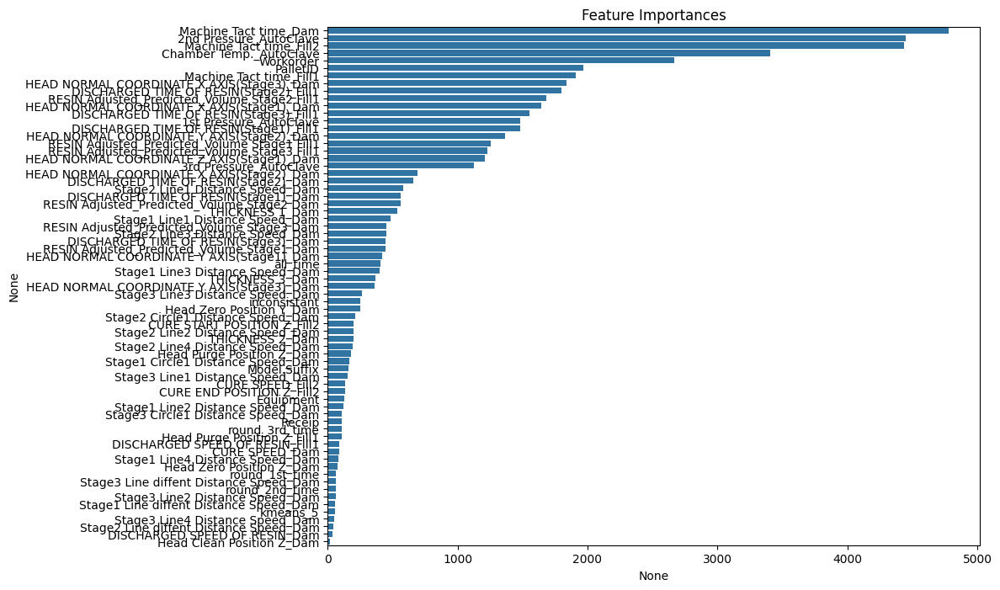

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889165
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240200
[LightGBM] [Debug] init for col-wise cost 0.001183 seconds, init for row-wise cost 0.004567 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001624 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1647
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.851385
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.085219
[LightGBM] [Debug] init for col-wise cost 0.000441 seconds, init for row-wise cost 0.001777 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000658 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1376
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889213
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240156
[LightGBM] [Debug] init for col-wise cost 0.001178 seconds, init for row-wise cost 0.004329 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001619 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1648
[LightGBM] [Info] Number of data point

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1353, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889322
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240208
[LightGBM] [Debug] init for col-wise cost 0.001

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889476
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240246
[LightGBM] [Debug] init for col-wise cost 0.001482 seconds, init for row-wise cost 0.005319 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002032 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1662
[LightGBM] [Info] Number of data points in the train set: 29164, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058017 -> initscore=-2.787256
[LightGBM] [Info] Start training from score -2.787256
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

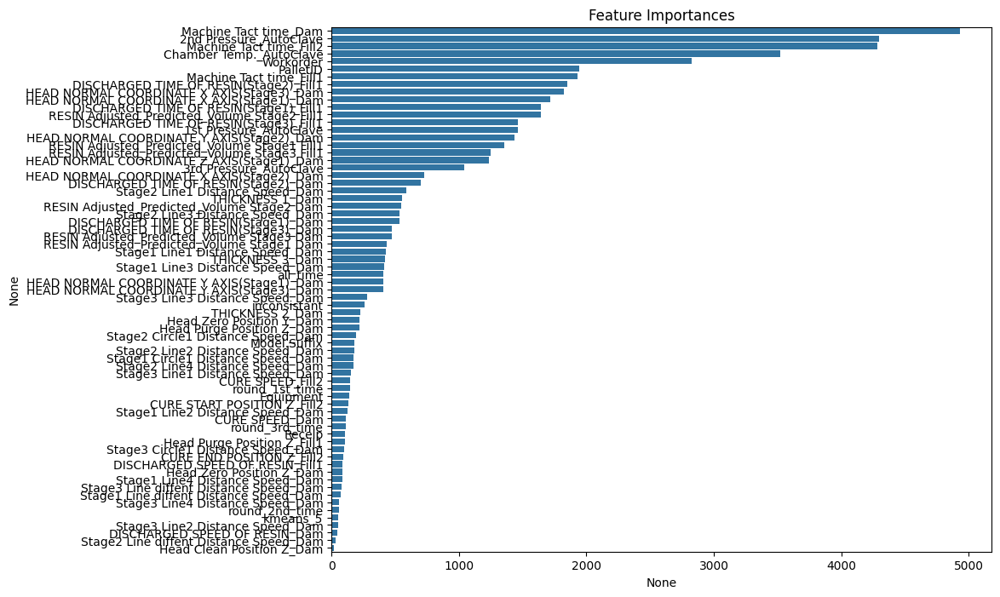

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.889689
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240323
[LightGBM] [Debug] init for col-wise cost 0.001199 seconds, init for row-wise cost 0.004271 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001641 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1645
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.842977
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056293
[LightGBM] [Debug] init for col-wise cost 0.000355 seconds, init for row-wise cost 0.001744 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000554 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1377
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.887451
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.174516
[LightGBM] [Debug] init for col-wise cost 0.000678 seconds, init for row-wise cost 0.002986 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000974 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1541
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 49
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 29
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21977
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.844906
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056434
[LightGBM] [Debug] init for col-wise cost 0.000388 seconds, init for row-wise cost 0.001783 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000589 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1389
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058034 -> initscore=-2.786933
[LightGBM] [Info] Start training from score -2.786933
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Info] Number of positive: 1353, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.846235
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.056506
[LightGBM] [Debug] init for col-wise cost 0.000356 seconds, init for row-wise cost 0.001743 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1382
[LightGBM] [Info] Number of data points in the train set: 23331, number of used features: 30
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.057992 -> initscore=-2.787718
[LightGBM] [Info] Start training from score -2.787718
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Info] Number of positive: 1354, number of negative: 21978
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.890408
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.240473
[LightGBM] [Debug] init for col-wise cost 0.001220 seconds, init for row-wise cost 0.004250 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001680 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Dense Multi-Val Bin
[LightGBM] [Info] Total Bins 1649
[LightGBM] [Info] Number of data points in the train set: 23332, number of used features: 69
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.058032 -> initscore=-2.786979
[LightGBM] [Info] Start training from score -2.786979
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Info] Number of positive: 1692, number of negative: 27472
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.890026
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sp

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 8
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

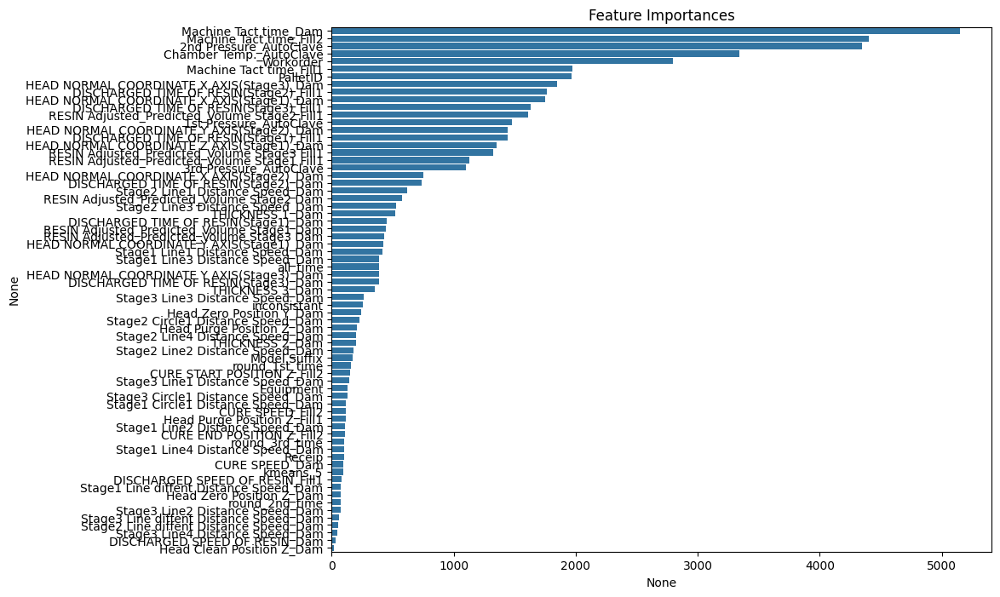

In [83]:
# Stratified cv fitting models

# 해당 모델 저장 리스트
models_lgbm_train = []
select_variables_lgbm = []

# split마다 모델 적합하기
for train_idx, valid_idx in tscv.split(X_train_lgbm_last, y_train_lgbm_last):
    
    print("="*50)

    # variable select
    lgbm_best_params["random_seed"] = 42
    clf = LGBMClassifier(**lgbm_best_params)
    
    min_features_to_select = 30
    step = 10
    selector = RFECV(clf, step=step, cv=5, min_features_to_select=min_features_to_select, scoring = 'f1')
    selector = selector.fit(X_train_lgbm_last.iloc[train_idx], y_train_lgbm_last[train_idx])
    
    # 선택된 변수
    selected_value = X_train_lgbm_last.columns[selector.support_]
    select_variables_lgbm.append(selected_value)
    
    lgbm_best_model = LGBMClassifier(**lgbm_best_params)

    # fit the model
    lgbm_best_model.fit(
        X_train_lgbm_last.loc[train_idx, selected_value], y_train_lgbm_last[train_idx],
        eval_set = [(X_train_lgbm_last.loc[valid_idx, selected_value], y_train_lgbm_last[valid_idx])],
        categorical_feature = list(np.array(cat_features_indices)[np.isin(cat_features_indices, selected_value)]),
        callbacks=[
            lgb.early_stopping(stopping_rounds=50),
        ]
    )

    # 모델 결과 저장하기
    models_lgbm_train.append(lgbm_best_model)
    
    # 위 feature importance를 시각화해봅니다.
    importances = pd.Series(lgbm_best_model.feature_importances_, index=list(X_train_lgbm_last.columns))
    importances = importances.sort_values(ascending=False)

    plt.figure(figsize=(10,8))
    plt.title("Feature Importances")
    sns.barplot(x=importances, y=importances.index)
    plt.show()

In [84]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_lgbm_train, select_variables_lgbm)):
    pred_list.append(model.predict_proba(X_valid_lgbm_last[var])[:, 1])
    
# 확률값 평균내기
lgbm_proba = np.mean(pred_list, axis = 0)

In [85]:
# thresholds
precision, recall, thresholds = precision_recall_curve(y_valid_lgbm_last, lgbm_proba)
f1_scores = 2*recall*precision / (recall + precision)
lgbm_best_threshold = thresholds[np.argmax(f1_scores)]
y_pred_custom_threshold_lgbm = (lgbm_proba >= lgbm_best_threshold).astype(int)

In [86]:
get_clf_eval(y_valid_lgbm_last, y_pred_custom_threshold_lgbm)

오차행렬:
 [[ 104  366]
 [ 336 7296]]

정확도: 0.9134
정밀도: 0.2364
재현율: 0.2213
F1: 0.2286


#### XGBoost

[0]	validation_0-logloss:0.25813
[100]	validation_0-logloss:0.20437
[200]	validation_0-logloss:0.20349
[209]	validation_0-logloss:0.20354


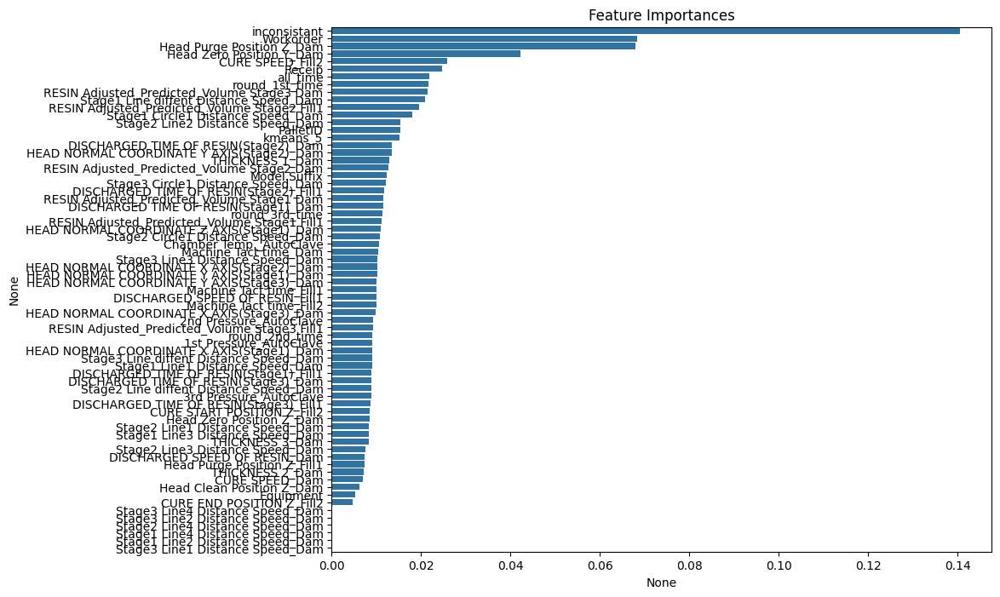

[0]	validation_0-logloss:0.25773
[100]	validation_0-logloss:0.19281
[200]	validation_0-logloss:0.18847
[300]	validation_0-logloss:0.18758
[350]	validation_0-logloss:0.18777


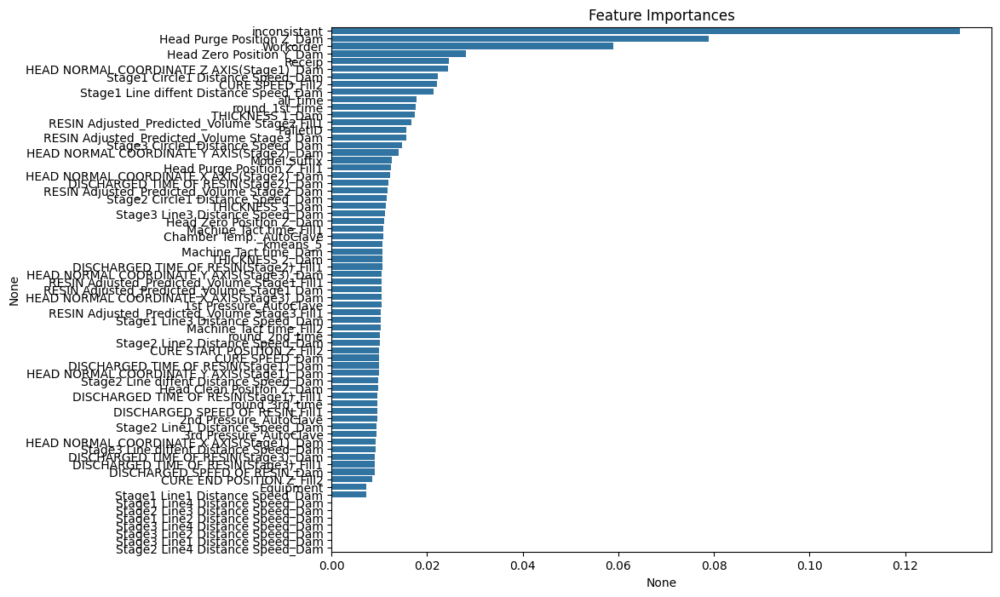

[0]	validation_0-logloss:0.25811
[100]	validation_0-logloss:0.20743
[169]	validation_0-logloss:0.20738


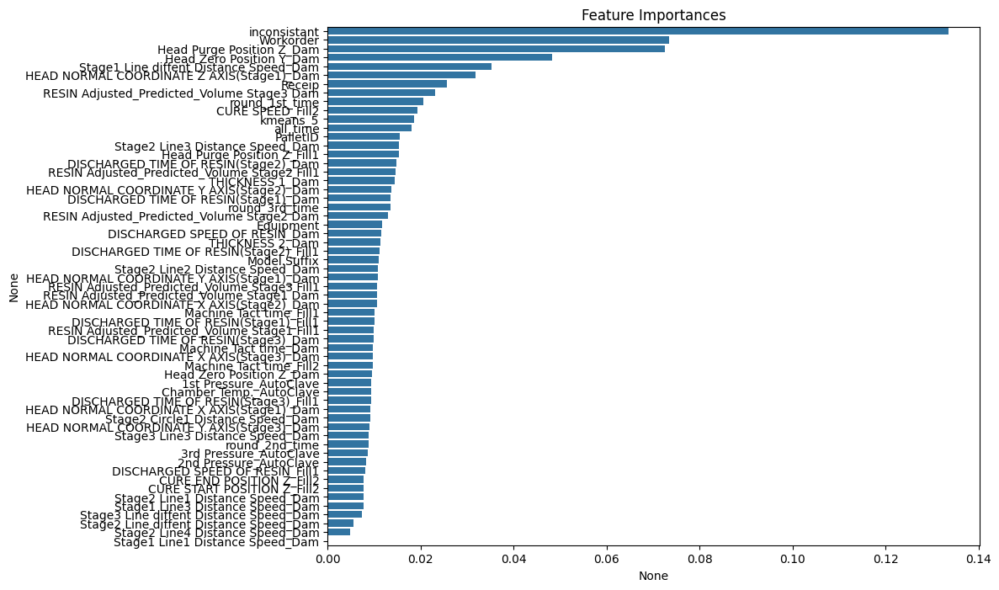

[0]	validation_0-logloss:0.25792
[100]	validation_0-logloss:0.20011
[200]	validation_0-logloss:0.19938
[207]	validation_0-logloss:0.19963


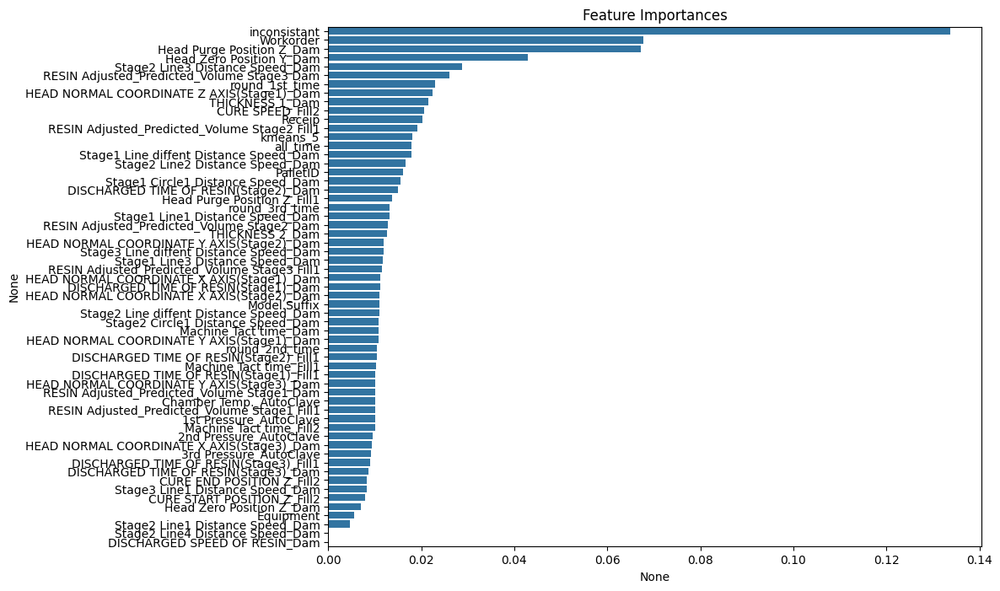

[0]	validation_0-logloss:0.25798
[100]	validation_0-logloss:0.20210
[200]	validation_0-logloss:0.20039
[230]	validation_0-logloss:0.20044


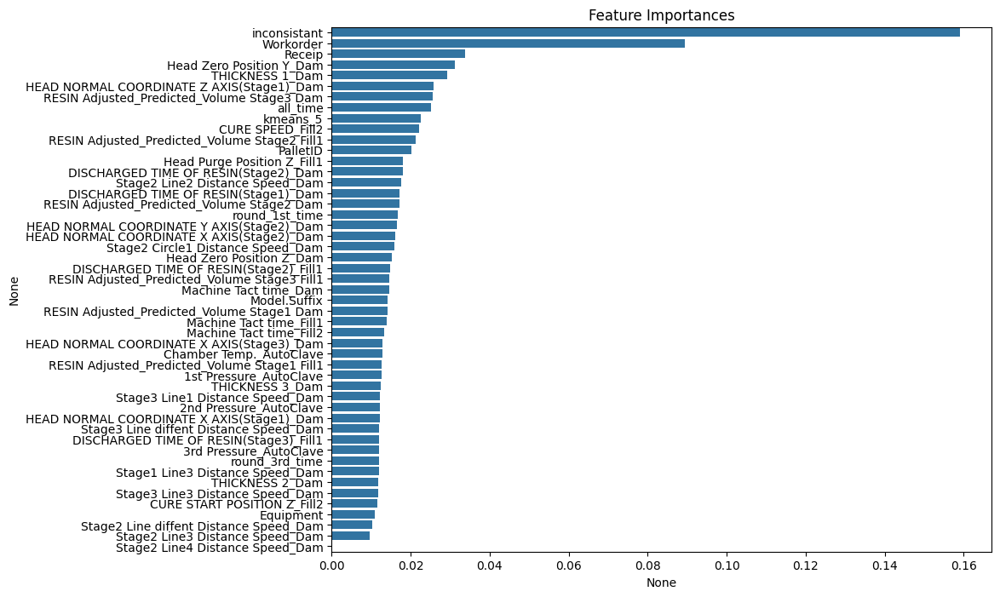

[0]	validation_0-logloss:0.25809
[100]	validation_0-logloss:0.20411
[181]	validation_0-logloss:0.20380


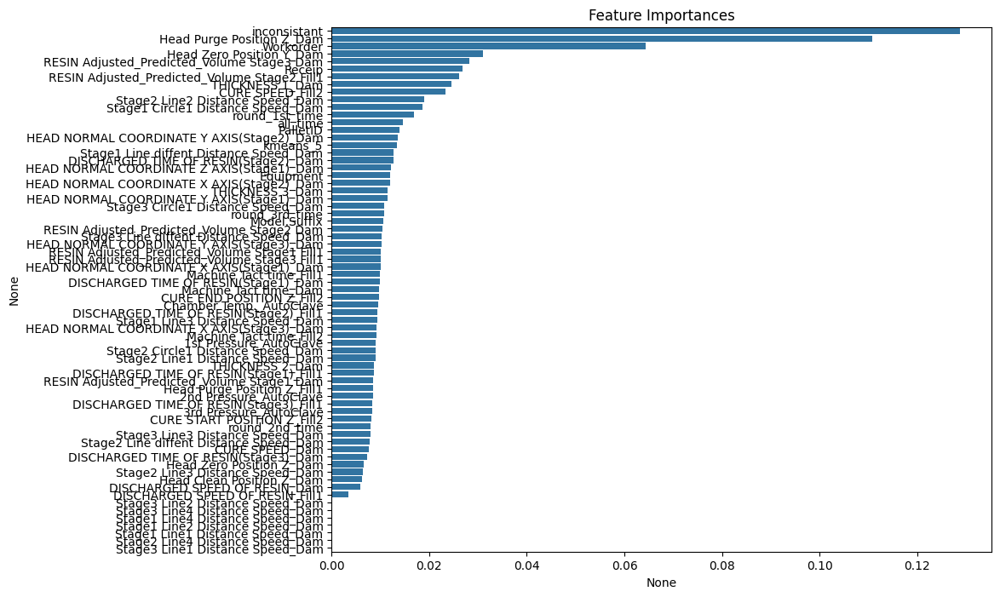

[0]	validation_0-logloss:0.25827
[100]	validation_0-logloss:0.20620
[191]	validation_0-logloss:0.20491


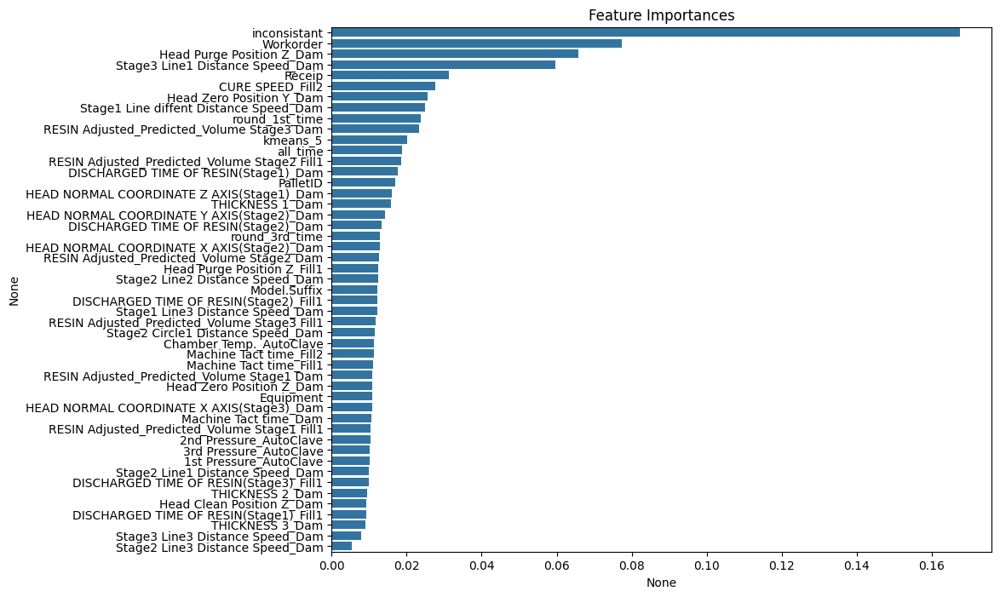

[0]	validation_0-logloss:0.25821
[100]	validation_0-logloss:0.20609
[200]	validation_0-logloss:0.20478
[237]	validation_0-logloss:0.20514


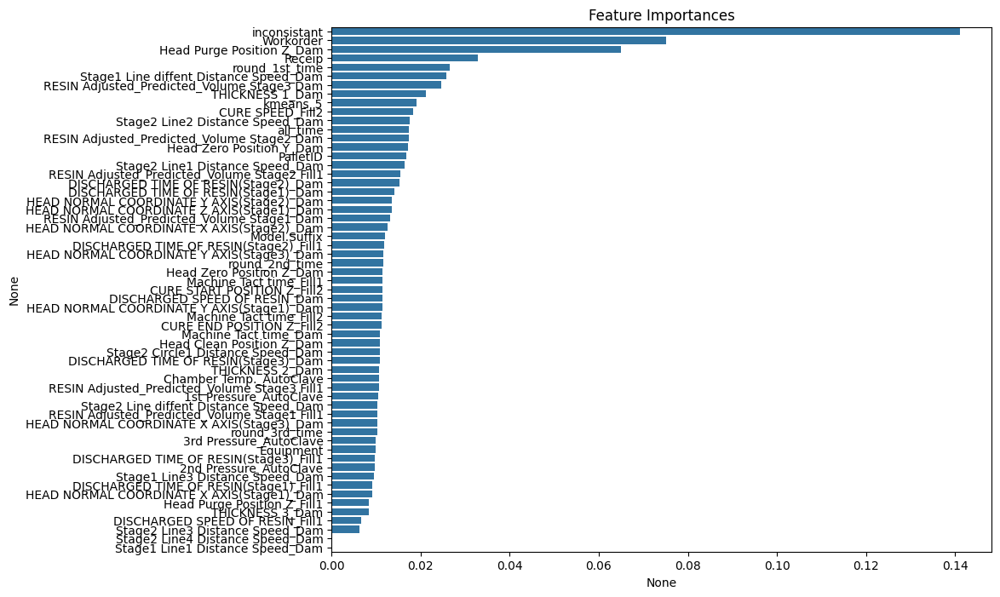

[0]	validation_0-logloss:0.25807
[100]	validation_0-logloss:0.20365
[200]	validation_0-logloss:0.20273


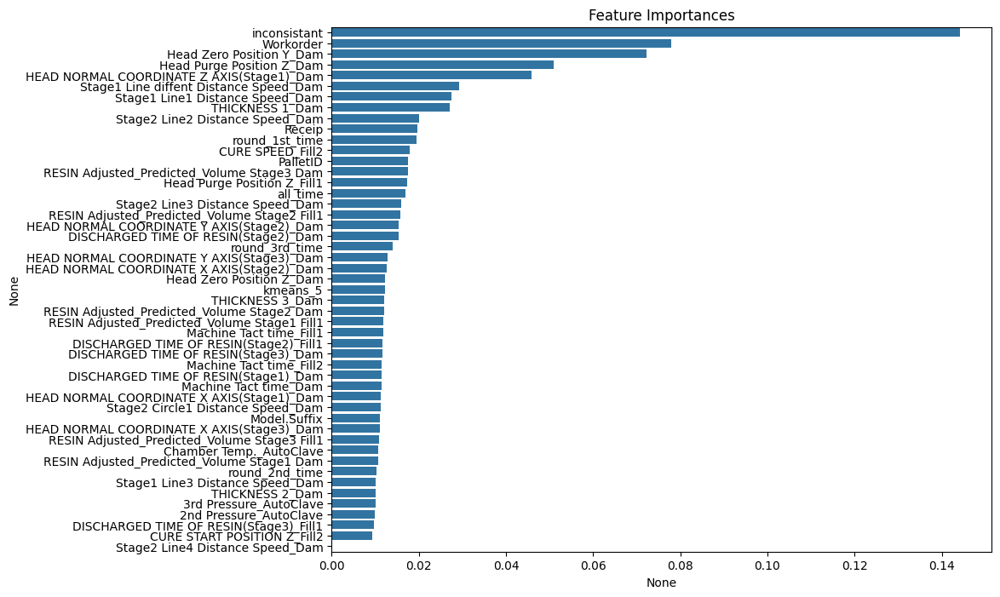

[0]	validation_0-logloss:0.25815
[100]	validation_0-logloss:0.20580
[184]	validation_0-logloss:0.20511


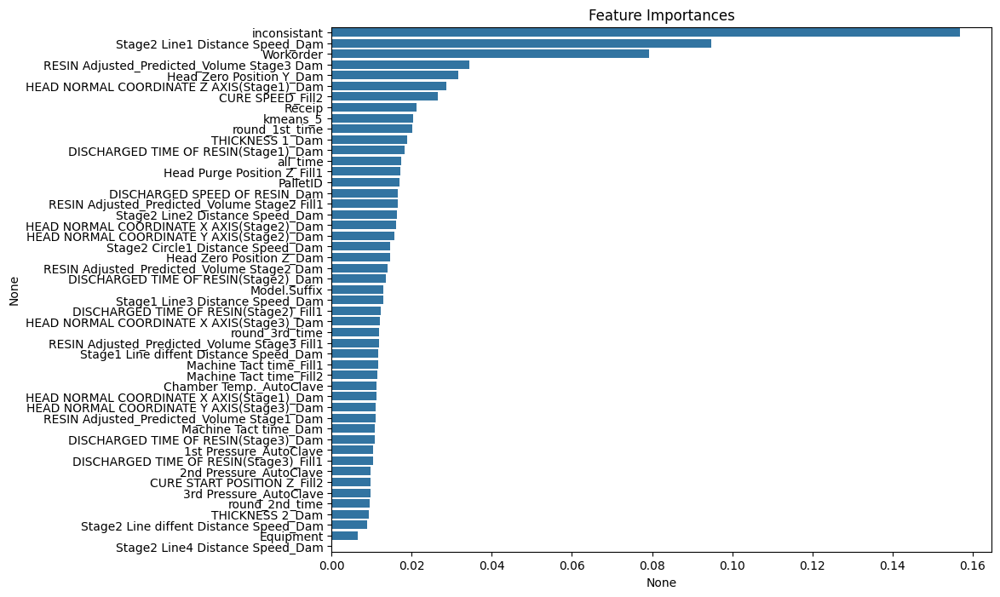

In [87]:
# Stratified cv fitting models_xgb_train

# 해당 모델 저장 리스트
models_xgb_train = []
select_variables_xgb = []

# split마다 모델 적합하기
for train_idx, valid_idx in tscv.split(X_train_xgb_last, y_train_xgb_last):
    
    print("="*50)
    
    # variable select
    xgb_best_params["seed"] = 42
    clf = XGBClassifier(**xgb_best_params)
    
    min_features_to_select = 30
    step = 10
    selector = RFECV(clf, step=step, cv=5, min_features_to_select=min_features_to_select, scoring = 'f1')
    selector = selector.fit(X_train_xgb_last.iloc[train_idx], y_train_xgb_last[train_idx])
    
    # 선택된 변수
    selected_value = X_train_xgb_last.columns[selector.support_]
    select_variables_xgb.append(selected_value)
    
    xgb_best_model = XGBClassifier(**xgb_best_params, early_stopping_rounds = 50, enable_categorical=True)

    # fit the model
    xgb_best_model.fit(
        X_train_xgb_last.loc[train_idx, selected_value], y_train_xgb_last[train_idx],
        eval_set = [(X_train_xgb_last.loc[valid_idx, selected_value], y_train_xgb_last[valid_idx])],
        verbose = 100
    )

    # 모델 결과 저장하기
    models_xgb_train.append(xgb_best_model)
    
    # 위 feature importance를 시각화해봅니다.
    importances = pd.Series(xgb_best_model.feature_importances_, index=list(X_train_xgb_last[selected_value].columns))
    importances = importances.sort_values(ascending=False)

    plt.figure(figsize=(10,8))
    plt.title("Feature Importances")
    sns.barplot(x=importances, y=importances.index)
    plt.show()

In [88]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_xgb_train, select_variables_xgb)):
    pred_list.append(model.predict_proba(X_valid_xgb_last[var])[:, 1])
    
# 확률값 평균내기
xgb_proba = np.mean(pred_list, axis = 0)

In [89]:
# thresholds
precision, recall, thresholds = precision_recall_curve(y_valid_xgb_last, xgb_proba)
f1_scores = 2*recall*precision / (recall + precision)
xgb_best_threshold = thresholds[np.argmax(f1_scores)]
y_pred_custom_threshold_xgb = (xgb_proba >= xgb_best_threshold).astype(int)

In [90]:
get_clf_eval(y_valid_xgb_last, y_pred_custom_threshold_xgb)

오차행렬:
 [[ 106  364]
 [ 348 7284]]

정확도: 0.9121
정밀도: 0.2335
재현율: 0.2255
F1: 0.2294


#### Ensemble tuning

In [91]:
def weight_test(last_num, test_set, prob):

    from itertools import product
    col_n = len(prob.columns)
    row_n = len(prob)
    
    
    # best ensemble
    best_f1 = 0
    best_f1_t = 0
    best_weights = None
    best_weights_t = None
    A = [i for i in range(last_num + 1)]
    
    for w in tqdm(product(A, repeat = col_n)):
        
        # 가중치 열 만들기
        weight_frame = pd.DataFrame([w]*row_n, columns = prob.columns)
        
        # 가중치 곱해주기
        prob_weight = prob * weight_frame
        
        # 가중치의 합
        w_sum = sum(w)
        
        # 평균 계산해주기
        final_proba = np.sum(prob_weight/w_sum, axis = 1)
        
        # 가중 평균 계산
        y_pred = (final_proba > 0.5).astype(int)

        # F1 스코어 계산
        f1 = f1_score(test_set, y_pred)

        # Threshold 스코어 계산
        precision, recall, thresholds = precision_recall_curve(test_set, final_proba)
        f1_scores = 2*recall*precision / (recall + precision)
        best_threshold = thresholds[np.argmax(f1_scores)]
        y_pred_custom_threshold = (final_proba >= best_threshold).astype(int)
        f1_t = f1_score(test_set, y_pred_custom_threshold)

        # 최고 성능 저장
        if f1 > best_f1:
            best_f1 = f1
            best_weights = w

        if f1_t > best_f1_t:
            best_f1_t = f1_t
            best_weights_t = w
            
#         print(f'weight: {w}, best_f1: {best_f1}, best_f1_t: {best_f1_t}, best_weights: {best_weights}, best_weights_t: {best_weights_t}')

    print('종료되었습니다.')
    return best_f1, best_f1_t, best_weights, best_weights_t

In [92]:
# 함수 적용
best_f1, best_f1_t, best_weights, best_weights_t = weight_test(last_num = 20, test_set = y_valid_xgb_last, prob = pd.DataFrame({'cat_proba': cat_proba, 'lgbm_proba': lgbm_proba, 'xgb_proba': xgb_proba}))
print(f'best_f1: {best_f1}, best_f1_t: {best_f1_t}, best_weights: {best_weights}, best_weights_t: {best_weights_t}')

9261it [01:52, 82.37it/s]

종료되었습니다.
best_f1: 0.11623246492985972, best_f1_t: 0.23705408515535098, best_weights: (1, 0, 0), best_weights_t: (15, 13, 2)


In [93]:
# best ensemble 적용
cat = cat_proba * best_weights_t[0]
lgbm = lgbm_proba * best_weights_t[1]
xgb = xgb_proba * best_weights_t[2]
y_best = (cat + lgbm + xgb)/(sum(best_weights_t))

In [94]:
precision, recall, thresholds = precision_recall_curve(y_valid_xgb_last, y_best)
f1_scores = 2*recall*precision / (recall + precision)
weights_best_threshold = thresholds[np.argmax(f1_scores)]
y_pred_custom_threshold = (y_best >= weights_best_threshold).astype(int)
get_clf_eval(y_valid_xgb_last, y_pred_custom_threshold)

오차행렬:
 [[ 103  367]
 [ 296 7336]]

정확도: 0.9182
정밀도: 0.2581
재현율: 0.2191
F1: 0.2371


## 6. Inference

### Catboost

In [115]:
# 해당 모델 저장 리스트
models_cat = []

# split마다 모델 적합하기
for (train_idx, valid_idx), sel in zip(tscv.split(X_cat, y_cat), select_variables_cat):
    
    print("="*50)
    cat_best_params["random_seed"] = 42
    cat_best_model = CatBoostClassifier(**cat_best_params)

    # fit the model
    cat_best_model.fit(
        X_cat.loc[train_idx, sel], y_cat[train_idx],
        eval_set = [(X_cat.loc[valid_idx, sel], y_cat[valid_idx])],
        early_stopping_rounds = 50,
        verbose = 100,
        cat_features = np.array(cat_features_indices)[np.isin(cat_features_indices, sel)]
    )

    # 모델 결과 저장하기
    models_cat.append(cat_best_model)

0:	learn: 0.6596071	test: 0.6597517	best: 0.6597517 (0)	total: 240ms	remaining: 3m 11s
100:	learn: 0.2079783	test: 0.2117007	best: 0.2117007 (100)	total: 9.31s	remaining: 1m 4s
200:	learn: 0.1990234	test: 0.2044760	best: 0.2044760 (200)	total: 21.7s	remaining: 1m 4s
300:	learn: 0.1958483	test: 0.2037465	best: 0.2037465 (300)	total: 33.9s	remaining: 56.1s
400:	learn: 0.1931895	test: 0.2033455	best: 0.2033455 (400)	total: 46.9s	remaining: 46.6s
Stopped by overfitting detector  (50 iterations wait)

bestTest = 0.2032600268
bestIteration = 441

Shrink model to first 442 iterations.
0:	learn: 0.6607262	test: 0.6606053	best: 0.6606053 (0)	total: 27.2ms	remaining: 21.7s
100:	learn: 0.2065621	test: 0.2050504	best: 0.2050504 (100)	total: 8.66s	remaining: 59.8s
200:	learn: 0.2002300	test: 0.1999855	best: 0.1999855 (200)	total: 20.4s	remaining: 1m
300:	learn: 0.1974234	test: 0.1990171	best: 0.1990113 (299)	total: 31s	remaining: 51.2s
400:	learn: 0.1953395	test: 0.1985182	best: 0.1985182 (400)	tot

In [116]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_cat_train, select_variables_cat)):
    pred_list.append(model.predict_proba(X_test_cat[var])[:, 1])

# 확률값 평균내기
cat_proba = np.mean(pred_list, axis = 0)

In [117]:
np.unique(np.where(cat_proba >= 0.5, 1, 0), return_counts = True)

(array([0, 1]), array([17290,    71]))

### LGBM

In [119]:
# 해당 모델 저장 리스트
models_lgbm = []

# split마다 모델 적합하기
for (train_idx, valid_idx), sel in zip(tscv.split(X_lgbm, y_lgbm), select_variables_lgbm):
    
    print("="*50)
    lgbm_best_params["random_seed"] = 42
    lgbm_best_model = LGBMClassifier(**lgbm_best_params)

    # fit the model
    lgbm_best_model.fit(
        X_lgbm.loc[train_idx, sel], y_lgbm[train_idx],
        eval_set = [(X_lgbm.loc[valid_idx, sel], y_lgbm[valid_idx])],
        categorical_feature=list(np.array(cat_features_indices)[np.isin(cat_features_indices, sel)]),
        callbacks=[
            lgb.early_stopping(stopping_rounds=50),
        ]
    )

    # 모델 결과 저장하기
    models_lgbm.append(lgbm_best_model)

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2115, number of negative: 34340
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.863170
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268374
[LightGBM] [Debug] init for col-wise cost 0.003367 seconds, init for row-wise cost 0.014783 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004424 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2036
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2115, number of negative: 34340
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.862888
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268254
[LightGBM] [Debug] init for col-wise cost 0.002260 seconds, init for row-wise cost 0.009436 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002925 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2023
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Debug] Trained a tree with leaves = 41 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [D

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 23
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2115, number of negative: 34340
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.863060
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268314
[LightGBM] [Debug] init for col-wise cost 0.002194 seconds, init for row-wise cost 0.009115 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002838 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2028
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2115, number of negative: 34341
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.863370
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268397
[LightGBM] [Debug] init for col-wise cost 0.002324 seconds, init for row-wise cost 0.008960 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003020 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2035
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 24
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Warning] Categorical features with more bins than the configured maximum bin number found.
[LightGBM] [Warning] For categorical features, max_bin and max_bin_by_feature may be ignored with a large number of categories.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 2115, number of negative: 34341
[LightGBM] [Debug] Dataset::GetMultiBinFromSparseFeatures: sparse rate 0.863069
[LightGBM] [Debug] Dataset::GetMultiBinFromAllFeatures: sparse rate 0.268307
[LightGBM] [Debug] init for col-wise cost 0.002221 seconds, init for row-wise cost 0.009411 seconds
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002868 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Debug] Using Sparse Multi-Val Bin
[LightGBM] [Info] Total Bins 2027
[LightGBM] [Info] Number of data points in the train set

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] 

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 9
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 21
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 16
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 12
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 20
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 13
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 10
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 17
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 11
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM]

[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 15
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 18
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 22
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 19
[LightGBM] [Debug] Trained a tree with leaves = 46 and depth = 14
Did not meet early stopping. Best iteration is:
[1199]	valid_0's binary_logloss: 0.201569


In [120]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_lgbm_train, select_variables_lgbm)):
    pred_list.append(model.predict_proba(X_test_lgbm[var])[:, 1])
    
# 확률값 평균내기
lgbm_proba = np.mean(pred_list, axis = 0)

In [121]:
np.unique(np.where(lgbm_proba >= 0.5, 1, 0), return_counts = True)

(array([0, 1]), array([17320,    41]))

### XGB

In [122]:
# 해당 모델 저장 리스트
models_xgb = []

# split마다 모델 적합하기
for (train_idx, valid_idx), sel in zip(tscv.split(X_xgb, y_xgb), select_variables_xgb):
    
    print("="*50)
    xgb_best_params["seed"] = 42
    xgb_best_model = XGBClassifier(**xgb_best_params, early_stopping_rounds = 50, enable_categorical=True)

    # fit the model
    xgb_best_model.fit(
        X_xgb.loc[train_idx, sel], y_xgb[train_idx],
        eval_set = [(X_xgb.loc[valid_idx, sel], y_xgb[valid_idx])],
        verbose = 100
    )

    # 모델 결과 저장하기
    models_xgb.append(xgb_best_model)

[0]	validation_0-logloss:0.25818
[100]	validation_0-logloss:0.20592
[199]	validation_0-logloss:0.20541
[0]	validation_0-logloss:0.25792
[100]	validation_0-logloss:0.20049
[200]	validation_0-logloss:0.19771
[300]	validation_0-logloss:0.19751
[347]	validation_0-logloss:0.19777
[0]	validation_0-logloss:0.25813
[100]	validation_0-logloss:0.20436
[200]	validation_0-logloss:0.20272
[225]	validation_0-logloss:0.20306
[0]	validation_0-logloss:0.25808
[100]	validation_0-logloss:0.20424
[200]	validation_0-logloss:0.20398
[215]	validation_0-logloss:0.20428
[0]	validation_0-logloss:0.25795
[100]	validation_0-logloss:0.19980
[200]	validation_0-logloss:0.19712
[260]	validation_0-logloss:0.19712
[0]	validation_0-logloss:0.25775
[100]	validation_0-logloss:0.19677
[200]	validation_0-logloss:0.19382
[257]	validation_0-logloss:0.19421
[0]	validation_0-logloss:0.25821
[100]	validation_0-logloss:0.20581
[200]	validation_0-logloss:0.20427
[235]	validation_0-logloss:0.20463
[0]	validation_0-logloss:0.25811
[

In [123]:
# predict
pred_list = []

# 각 모델별 예측값 가져오기
for i, (model, var) in enumerate(zip(models_xgb_train, select_variables_xgb)):
    pred_list.append(model.predict_proba(X_test_xgb[var])[:, 1])
    
# 확률값 평균내기
xgb_proba = np.mean(pred_list, axis = 0)

In [124]:
np.unique(np.where(xgb_proba >= 0.5, 1, 0), return_counts = True)

(array([0, 1]), array([17330,    31]))

In [125]:
# 추론
cat = cat_proba * best_weights_t[0]
lgbm = lgbm_proba * best_weights_t[1]
xgb = xgb_proba * best_weights_t[2]
p = (cat + lgbm + xgb)/(sum(best_weights_t))

In [126]:
p2 = np.where(p >= weights_best_threshold, 'AbNormal', 'Normal')

In [127]:
np.unique(p2, return_counts = True)

(array(['AbNormal', 'Normal'], dtype='<U8'), array([  917, 16444]))

In [128]:
p3 = np.where(p >= 0.5, 'AbNormal', 'Normal')

In [129]:
np.unique(p3, return_counts = True)

(array(['AbNormal', 'Normal'], dtype='<U8'), array([   64, 17297]))

In [130]:
pd.crosstab(p2, df_test['inconsistant'])

inconsistant,0,1
row_0,,
AbNormal,889,28
Normal,16444,0


## 7. Submission

In [133]:
# 제출 데이터 읽어오기 (df_test는 전처리된 데이터가 저장됨)
df_sub = pd.read_csv("submission.csv")
df_sub["target"] = p2

# 제출 파일 저장
df_sub.to_csv("submission.csv", index=False)

In [135]:
df_sub['target'].value_counts()

target
Normal      16444
AbNormal      917
Name: count, dtype: int64

# 꼭 df_sub['target'] 확인하고 제출하시오